In [7]:
import sys,os
import tarfile
import warnings

import numpy as np
import pandas as pd
import xarray as xr

import SDFC.link as sdl
import NSSEA as ns
import NSSEA.plot as nsp
import NSSEA.models as nsm
import scipy.stats as sc
import statsmodels.api as sm
from statsmodels.graphics.gofplots import qqplot_2samples

import cftime
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.backends.backend_pdf as mpdf
import matplotlib.patches as mplpatch
from matplotlib.gridspec import GridSpec

from scipy.stats._morestats import _calc_uniform_order_statistic_medians

import seaborn as sns

In [8]:
%run ../Scripts/data_preparation.py
%run ../Scripts/Interest_Quantities.py

In [9]:
custom_params = {"axes.spines.bottom": True,"axes.spines.right": True,"axes.spines.left": True, "axes.spines.top":True}
sns.set_theme(style="whitegrid",rc=custom_params)
sns.set_context("poster")

In [10]:
basepath=os.path.abspath(os.getcwd())
pathInp='/home/barbauxo/Documents/Doctorat/03_Travail/2023_01 Application Tricastin/Data'
pathOut='../Outputs/Outputs (Test Full_V1 Hadcrut)'
pathGCM='/home/barbauxo/Documents/Temporary/Outputs (Test Full_V1 Hadcrut)'
assert(os.path.exists(pathInp))
assert(os.path.exists(pathOut))
time_period    = np.arange( 1850 , 2101 , 1 , dtype = np.int )
time_reference = np.arange( 1986 , 2016 , 1 , dtype = np.int )
type_data="03_Post_treatment"  #"02_Selected" #"03_Post_treatment" #But no absolute


ci          = 0.05
T=100
T1=2000
T2=2100
deb=1850
fin=2101

/tmp/ipykernel_6906/306771505.py:7: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  time_period    = np.arange( 1850 , 2101 , 1 , dtype = np.int )
/tmp/ipykernel_6906/306771505.py:8: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
D

In [11]:
lX,lY,models=load_models_CMIP6(pathInp,type_data)
Xo,Yo=load_obs(pathInp,type_data)
if type_data=="02_Selected":
    Xo,Yo,lX,lY,bias=Everyone_as_anomaly(Xo,Yo,lX,lY,time_reference)

['ACCESS-CM2_i1p1f1', 'ACCESS-ESM1-5_i1p1f1', 'CMCC-ESM2_i1p1f1', 'CNRM-CM6-1-HR_i1p1f2', 'CNRM-CM6-1_i1p1f2', 'CNRM-ESM2-1_i1p1f2', 'CanESM5_i1p2f1', 'EC-Earth3-CC_i1p1f1', 'EC-Earth3-Veg-LR_i1p1f1', 'EC-Earth3-Veg_i1p1f1', 'EC-Earth3_i1p1f1', 'FGOALS-g3_i1p1f1', 'GFDL-ESM4_i1p1f1', 'HadGEM3-GC31-LL_i1p1f3', 'HadGEM3-GC31-MM_i1p1f3', 'INM-CM4-8_i1p1f1', 'INM-CM5-0_i1p1f1', 'IPSL-CM6A-LR_i1p1f1', 'KACE-1-0-G_i1p1f1', 'MIROC-ES2L_i1p1f2', 'MIROC6_i1p1f1', 'MPI-ESM1-2-LR_i1p1f1', 'MRI-ESM2-0_i1p1f1', 'MRI-ESM2-0_i2p1f1', 'NESM3_i1p1f1', 'NorESM2-MM_i1p1f1', 'TaiESM1_i1p1f1', 'UKESM1-0-LL_i1p1f2']


In [14]:
## Reload
##=======
event_name="HW19"
ns_law      = nsm.GEV()

clim,climCX,climCXC0,climCXCB = ( ns.Climatology.from_netcdf( os.path.join( pathGCM , "{}_clim{}.nc".format(event_name,s) ) , ns_law ) for s in ["","CX","CXC0","CXCB"] )
params,paramsCX,paramsCXC0,paramsCXCB = ( xr.open_dataset( os.path.join( pathGCM , "{}_params{}.nc".format(event_name,s) ) )["params{}".format(s)] for s in ["","CX","CXC0","CXCB"] )


In [15]:
import time

In [16]:


model ="Observations"
tY    = Yo.index
X     = Xo.loc[tY]

law = clim.ns_law
law.fit(Yo.values,X.values)
law.get_params()

/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

array([-0.37804754,  1.19978737,  0.39608157,  0.31855754, -0.25066964])

In [17]:
start_time = time.time()
models      = ["Observations"]
n_models    = 1
sample      = clim.sample
n_sample    = clim.n_sample

n_ns_params = clim.ns_law.n_ns_params
ns_params_names = clim.ns_law.get_params_names()


law_coef   = xr.DataArray( np.zeros( (n_ns_params,n_sample + 1,n_models) ) , coords = [ ns_params_names , sample , models ] , dims = ["coef","sample","model"] )

model = "Observations"
tY    = Yo.index
X     = Xo.loc[tY]

law = clim.ns_law
law.fit(Yo.values,X.values)
law_coef.loc[:,"BE",model] = law.get_params()

for s in sample:
    fit_is_valid = False
    print(s)
    while not fit_is_valid:
        idx = np.random.choice( tY.size , tY.size , replace = True )
        tYs = tY.values[idx]
        Ys = Yo.iloc[idx].values
        Xs = Xo.loc[tYs].values
        law.fit(Ys,Xs)
        fit_is_valid = True
    law_coef.loc[:,s,model] = law.get_params()
print("--- %s seconds ---" % (time.time() - start_time))

BE
S0000
S0001
S0002
S0003
S0004


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0005
S0006
S0007
S0008
S0009
S0010


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0011
S0012
S0013
S0014


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0015
S0016
S0017
S0018
S0019
S0020


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0021
S0022
S0023
S0024


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0025
S0026
S0027
S0028
S0029
S0030
S0031


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0032
S0033
S0034
S0035
S0036
S0037
S0038


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0039
S0040
S0041
S0042
S0043


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0044
S0045
S0046


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0047
S0048
S0049
S0050


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0051
S0052
S0053
S0054
S0055
S0056
S0057


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0058
S0059
S0060
S0061
S0062
S0063
S0064


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0065
S0066
S0067
S0068
S0069
S0070


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0071
S0072
S0073
S0074
S0075
S0076
S0077


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0078
S0079
S0080
S0081
S0082


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0083
S0084
S0085
S0086
S0087
S0088


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0089
S0090
S0091
S0092
S0093
S0094


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0095
S0096
S0097
S0098
S0099


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0100
S0101
S0102
S0103
S0104
S0105
S0106


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0107
S0108
S0109
S0110
S0111
S0112


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0113
S0114
S0115
S0116
S0117
S0118


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0119
S0120
S0121
S0122


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0123
S0124
S0125
S0126
S0127
S0128


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0129
S0130
S0131
S0132
S0133


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0134
S0135
S0136
S0137
S0138
S0139


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0140
S0141
S0142
S0143
S0144
S0145


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0146
S0147
S0148
S0149


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0150
S0151
S0152
S0153


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0154
S0155
S0156
S0157
S0158


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0159
S0160
S0161
S0162


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0163
S0164
S0165
S0166


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0167
S0168
S0169
S0170
S0171
S0172
S0173


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0174
S0175
S0176
S0177
S0178


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0179
S0180
S0181
S0182
S0183
S0184


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0185
S0186
S0187
S0188
S0189
S0190
S0191


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0192
S0193
S0194
S0195


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0196
S0197
S0198
S0199
S0200
S0201
S0202


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0203
S0204
S0205
S0206
S0207
S0208


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0209
S0210
S0211
S0212
S0213


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0214
S0215
S0216
S0217


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/link/__Univariate.py:87: RuntimeWarning: overflow encountered in exp
  return np.exp( self.s * x) + self.b
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linu

S0218
S0219
S0220
S0221
S0222


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0223
S0224
S0225
S0226
S0227


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0228
S0229
S0230
S0231
S0232
S0233
S0234


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0235
S0236
S0237
S0238
S0239
S0240


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0241
S0242
S0243
S0244
S0245
S0246
S0247


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0248
S0249
S0250
S0251
S0252


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0253
S0254
S0255
S0256
S0257
S0258
S0259


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0260
S0261
S0262
S0263
S0264
S0265
S0266


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0267
S0268
S0269
S0270
S0271
S0272


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0273
S0274
S0275
S0276
S0277


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0278
S0279
S0280
S0281
S0282
S0283
S0284
S0285


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0286
S0287
S0288
S0289
S0290
S0291
S0292


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0293
S0294
S0295
S0296


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0297
S0298
S0299
S0300
S0301
S0302


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0303
S0304
S0305
S0306
S0307


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0308
S0309
S0310
S0311
S0312
S0313
S0314


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0315
S0316
S0317
S0318
S0319
S0320
S0321
S0322
S0323
S0324
S0325
S0326
S0327


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0328
S0329
S0330
S0331
S0332


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0333
S0334
S0335


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0336
S0337
S0338
S0339
S0340
S0341


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0342
S0343
S0344
S0345
S0346
S0347
S0348


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0349
S0350
S0351
S0352
S0353
S0354
S0355


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0356
S0357
S0358
S0359
S0360
S0361


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0362
S0363
S0364
S0365
S0366


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0367
S0368
S0369
S0370
S0371


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0372
S0373
S0374
S0375
S0376
S0377


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0378
S0379
S0380
S0381


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0382
S0383
S0384
S0385
S0386
S0387
S0388


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0389
S0390
S0391
S0392
S0393


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0394
S0395
S0396
S0397
S0398
S0399
S0400
S0401
S0402
S0403
S0404


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0405
S0406
S0407
S0408
S0409


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0410
S0411
S0412
S0413
S0414
S0415


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0416
S0417
S0418
S0419
S0420
S0421


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0422
S0423
S0424
S0425
S0426
S0427
S0428


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0429
S0430
S0431
S0432
S0433
S0434


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0435
S0436
S0437
S0438
S0439
S0440
S0441


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0442
S0443
S0444
S0445
S0446


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0447
S0448
S0449
S0450
S0451


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0452
S0453
S0454
S0455
S0456


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0457
S0458
S0459
S0460
S0461
S0462


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0463
S0464
S0465
S0466
S0467
S0468


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0469
S0470
S0471
S0472


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0473


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0474
S0475
S0476
S0477
S0478
S0479
S0480
S0481
S0482
S0483


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0484
S0485
S0486
S0487
S0488
S0489


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0490
S0491
S0492
S0493
S0494
S0495


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0496
S0497
S0498
S0499
S0500
S0501


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0502
S0503
S0504
S0505
S0506


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0507
S0508
S0509
S0510
S0511
S0512
S0513


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/link/__Univariate.py:90: RuntimeWarning: invalid value encountered in log
  return np.log(x - self.b) / self.s
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-

S0514
S0515
S0516
S0517
S0518


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0519
S0520
S0521
S0522
S0523
S0524
S0525
S0526
S0527
S0528


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0529
S0530
S0531
S0532
S0533


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0534
S0535
S0536
S0537
S0538
S0539


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0540
S0541
S0542
S0543
S0544
S0545


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0546
S0547
S0548
S0549
S0550


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0551
S0552
S0553
S0554
S0555


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0556
S0557
S0558
S0559
S0560
S0561


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0562
S0563
S0564
S0565
S0566
S0567


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0568
S0569
S0570
S0571


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0572
S0573
S0574
S0575
S0576
S0577


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0578
S0579
S0580
S0581
S0582


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0583
S0584
S0585
S0586
S0587
S0588
S0589


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0590
S0591
S0592
S0593
S0594
S0595


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0596
S0597
S0598
S0599
S0600
S0601


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0602
S0603
S0604
S0605
S0606
S0607


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0608
S0609
S0610
S0611
S0612
S0613
S0614


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0615
S0616
S0617
S0618
S0619


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0620
S0621
S0622
S0623
S0624
S0625


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0626
S0627
S0628
S0629
S0630
S0631


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0632
S0633
S0634
S0635
S0636
S0637
S0638
S0639
S0640
S0641
S0642


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0643
S0644
S0645
S0646
S0647
S0648


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0649
S0650
S0651
S0652
S0653
S0654


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0655
S0656
S0657
S0658
S0659
S0660


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0661
S0662
S0663
S0664
S0665
S0666


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0667
S0668
S0669
S0670
S0671
S0672


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0673
S0674
S0675
S0676
S0677
S0678
S0679


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0680
S0681
S0682
S0683
S0684
S0685


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0686
S0687
S0688
S0689
S0690
S0691
S0692


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0693
S0694
S0695
S0696
S0697
S0698
S0699


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0700
S0701
S0702
S0703
S0704
S0705


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0706
S0707
S0708
S0709
S0710
S0711


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0712
S0713
S0714
S0715
S0716


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0717
S0718
S0719
S0720
S0721


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0722
S0723
S0724
S0725
S0726


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0727
S0728
S0729
S0730
S0731
S0732


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0733
S0734
S0735
S0736
S0737
S0738
S0739


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0740
S0741
S0742
S0743
S0744


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0745
S0746
S0747
S0748
S0749
S0750
S0751


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0752
S0753
S0754
S0755
S0756


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0757
S0758
S0759
S0760
S0761
S0762
S0763


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0764
S0765
S0766
S0767
S0768
S0769
S0770


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0771
S0772
S0773
S0774
S0775


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0776
S0777
S0778
S0779
S0780
S0781
S0782


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0783
S0784
S0785
S0786
S0787
S0788


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0789
S0790
S0791
S0792
S0793
S0794


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0795
S0796
S0797
S0798
S0799


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0800
S0801
S0802
S0803
S0804
S0805


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:315: RuntimeWarning: overflow encountered in power
  res = np.sum( ( 1. + 1. / shape ) * np.log(Z) + np.power( Z , - 1. / shape ) + np.log(scale) )
/home/barbauxo/miniconda3/envs/Yoann/lib/p

S0806
S0807
S0808
S0809


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0810
S0811
S0812
S0813
S0814
S0815
S0816
S0817
S0818
S0819


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0820
S0821
S0822
S0823
S0824
S0825


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0826
S0827
S0828
S0829
S0830
S0831


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0832
S0833
S0834
S0835
S0836
S0837


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0838
S0839
S0840


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0841
S0842
S0843
S0844
S0845
S0846


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0847
S0848
S0849
S0850
S0851
S0852
S0853


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0854
S0855
S0856
S0857
S0858
S0859


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0860
S0861
S0862
S0863
S0864


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0865
S0866
S0867
S0868
S0869
S0870


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0871
S0872
S0873
S0874


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0875
S0876
S0877
S0878
S0879
S0880


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0881
S0882
S0883
S0884
S0885
S0886
S0887
S0888
S0889
S0890
S0891
S0892


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0893
S0894
S0895
S0896
S0897
S0898
S0899
S0900
S0901
S0902
S0903


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0904
S0905
S0906
S0907
S0908
S0909
S0910


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0911
S0912
S0913
S0914


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0915
S0916
S0917
S0918
S0919


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0920
S0921
S0922
S0923
S0924
S0925


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0926
S0927
S0928
S0929
S0930
S0931


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0932
S0933
S0934
S0935
S0936
S0937
S0938


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0939
S0940
S0941
S0942
S0943


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0944
S0945
S0946
S0947
S0948
S0949


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0950
S0951
S0952
S0953
S0954
S0955


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0956
S0957
S0958
S0959


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0960
S0961
S0962


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0963
S0964
S0965
S0966
S0967


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0968
S0969
S0970
S0971
S0972
S0973


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0974
S0975
S0976
S0977
S0978
S0979
S0980


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0981
S0982
S0983
S0984
S0985


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0986
S0987
S0988
S0989


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0990
S0991
S0992
S0993
S0994
S0995
S0996


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

S0997
S0998
S0999
--- 41.036712884902954 seconds ---


/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:333: RuntimeWarning: invalid value encountered in power
  ZZim1 = np.power( ZZ ,  - shc )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:342: RuntimeWarning: invalid value encountered in log
  T2 = np.log(ZZ) * ZZi / shape**2 - ZZim1 * Z / shape - np.log(ZZ) / shape**2 + shc * Z / ZZ
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-x86_64.egg/SDFC/__GEV.py:332: RuntimeWarning: invalid value encountered in power
  ZZi   = np.power( ZZ ,  - 1 / shape )
/home/barbauxo/miniconda3/envs/Yoann/lib/python3.8/site-packages/SDFC-0.6.0.post1-py3.8-linux-

In [7]:
import matplotlib.ticker as ticker

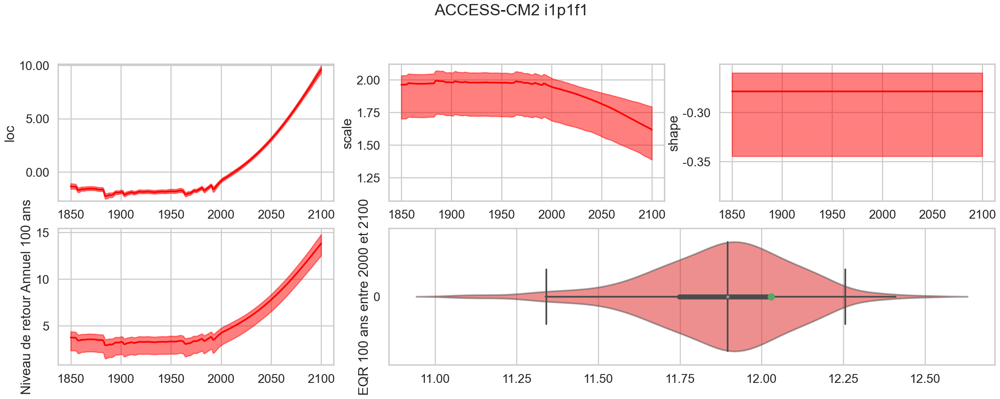

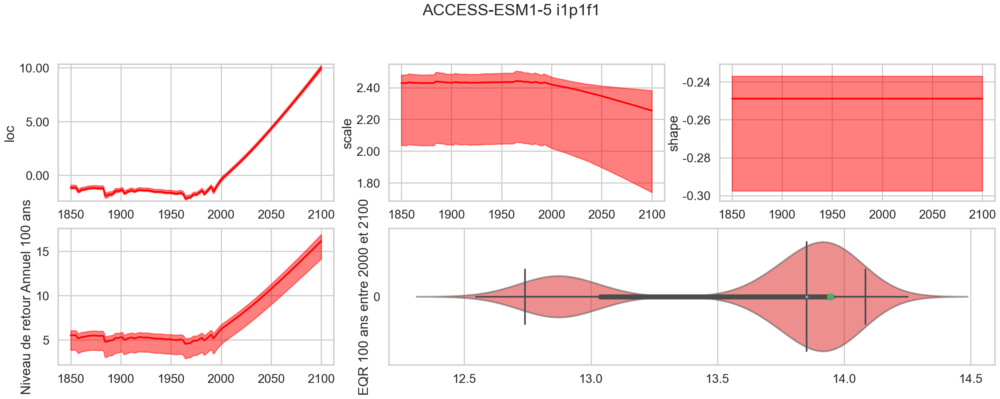

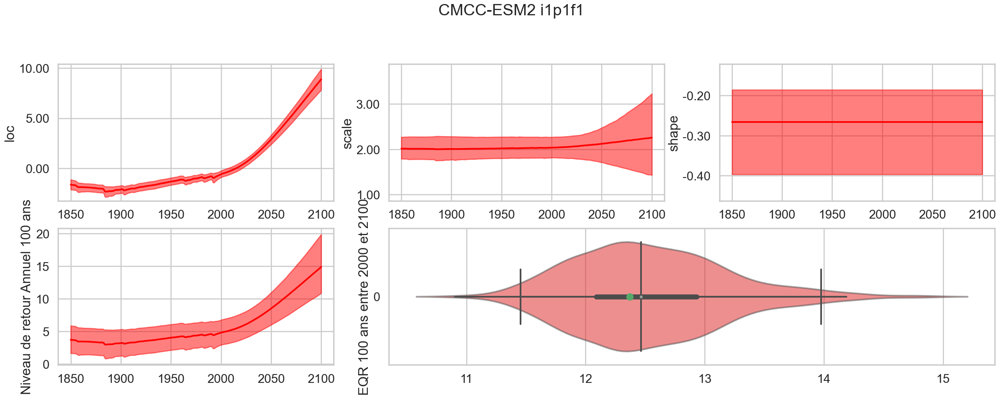

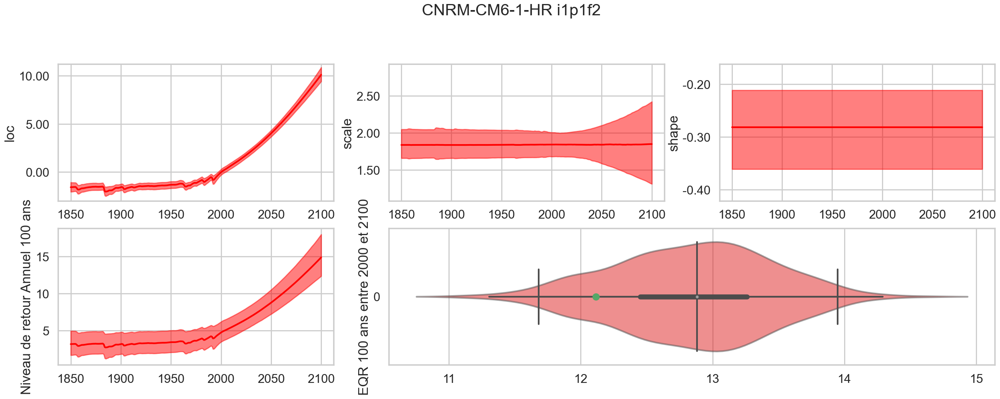

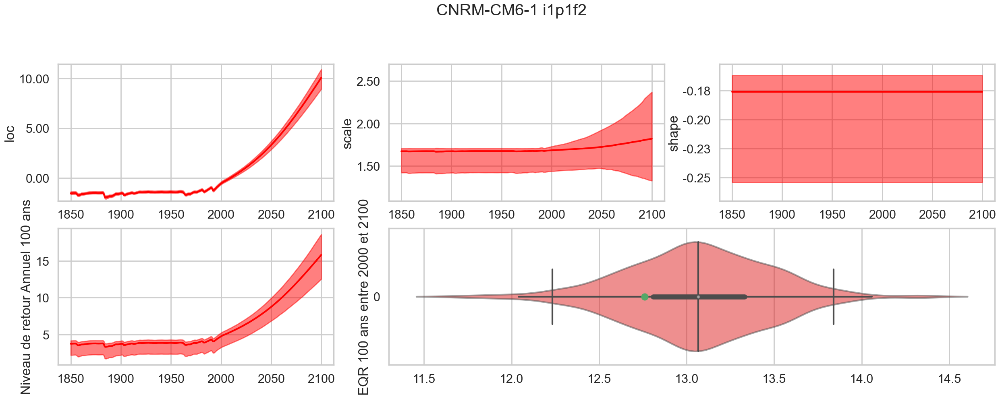

...

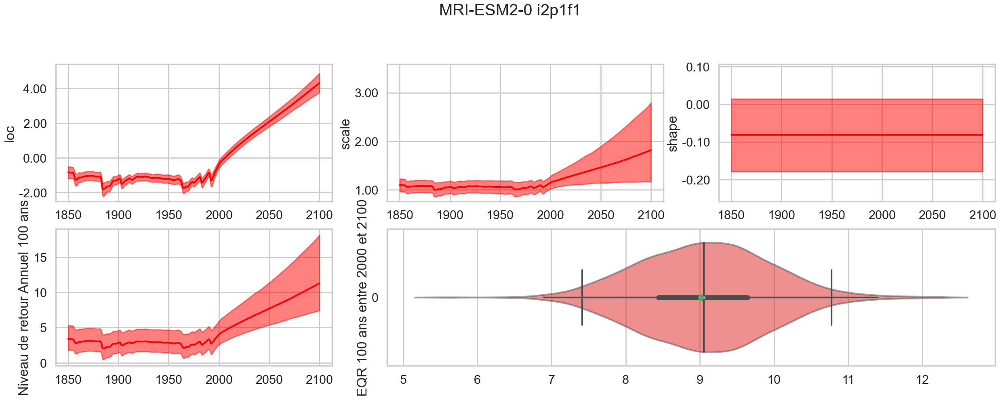

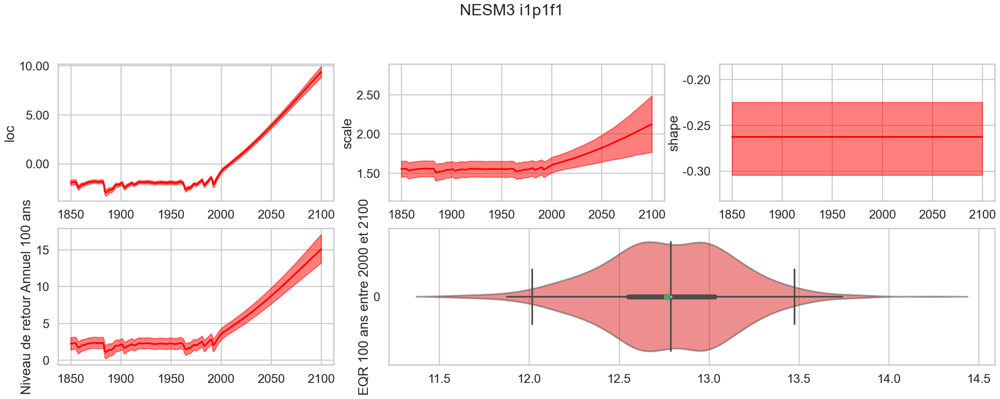

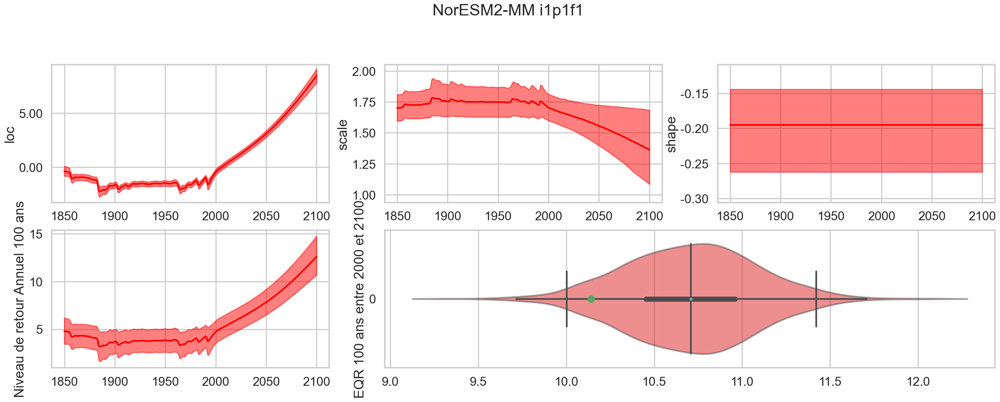

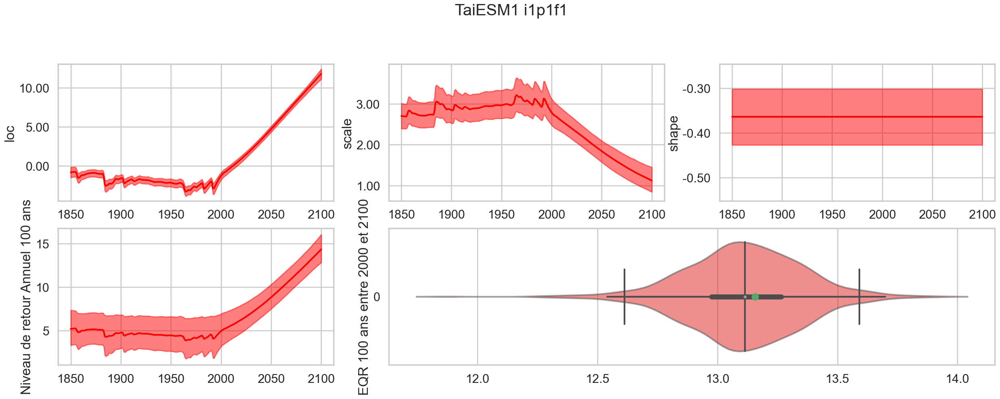

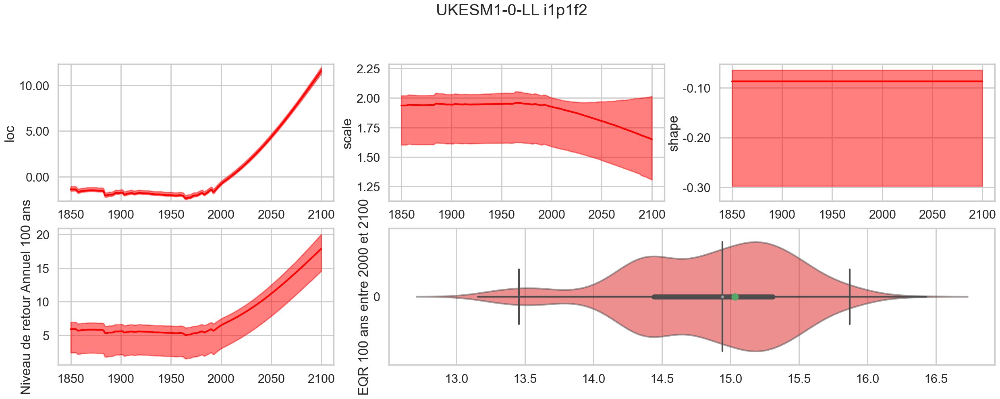

In [8]:

ofile=os.path.join( pathOut , "Paramètres_GCM_Modeles.pdf" )
pdf = mpdf.PdfPages( ofile )

time = clim.time


## Quantile
l_params = [k for k in clim.ns_law.lparams]
n_param  = len(l_params)
qparams  = params[:,1:,:,:,:].quantile( [ ci / 2 , 1 - ci / 2 , 0.5 ] , dim = "sample" ).assign_coords( quantile = ["ql","qu","BE"] )
#	if not clim.BE_is_median:
#		qparams.loc["BE",:,:,:,:] = params.loc[:,"BE",:,:,:]

ymin = params.min( dim = ["forcing","time","sample"] )
ymax = params.max( dim = ["forcing","time","sample"] )
xlim = [time.min(),time.max()]
deltax = 0.05 * ( xlim[1] - xlim[0] )
xlim[0] -= deltax
xlim[1] += deltax


for j in range(0,len(models)):
    m=models[j]
    #fig, ax = plt.subplots()
    fig = plt.figure( figsize = (n_param*10,15) )
    fig.suptitle( " ".join(m.split("_")) )
    gs = GridSpec(3, 3, figure=fig)
    gs.tight_layout(fig,pad=1.5,h_pad=10, w_pad=100,rect=[0, 0.0, 1, 2])
    #fig.tight_layout(rect=[0, 0.0, 1, 1])

    for i,p in enumerate(qparams.param):

        ax = fig.add_subplot( gs[0, i] )
        ax.plot( time , qparams.loc["BE",time,"F",p,m] , color = "red" )
        ax.fill_between( time , qparams.loc["ql",time,"F",p,m] , qparams.loc["qu",time,"F",p,m] , color = "red" , alpha = 0.5 )
        ax.set_ylim( (float(ymin.loc[p,m]),float(ymax.loc[p,m])) )
        #ax.set_xticks([])
        ax.set_ylabel(str(p.values))
        ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, p: f'{y:.2f}'))
        #ax.yaxis.set_major_formatter(ticker.EngFormatter())
        #ax.set_ylabel(str(p.values) , fontsize = 20 )
        #for item in ax.get_yticklabels():
            #item.set_fontsize(20)
    
        #ax.set_xlabel("Time" , fontsize = 20 )
        #for item in ax.get_yticklabels():
            #item.set_fontsize(20)
        #for item in ax.get_xticklabels():
            #item.set_fontsize(20)

    
    #pdf.savefig(fig)
    #plt.close(fig)
    
    #Quantile 100ans
    #fig, ax = plt.subplots()
    ax = fig.add_subplot( gs[1:2, 0] )
    Q_100=[sc.genextreme.ppf((1-1/T), -qparams.loc["BE",time,"F",qparams.param[2],m][i], qparams.loc["BE",time,"F",qparams.param[0],m][i],qparams.loc["BE",time,"F",qparams.param[1],m][i]) for i in list(range(0,fin-deb))]
    Q_100_u=[sc.genextreme.ppf((1-1/T), -qparams.loc["qu",time,"F",qparams.param[2],m][i], qparams.loc["qu",time,"F",qparams.param[0],m][i],qparams.loc["qu",time,"F",qparams.param[1],m][i]) for i in list(range(0,fin-deb))]
    Q_100_l=[sc.genextreme.ppf((1-1/T), -qparams.loc["ql",time,"F",qparams.param[2],m][i], qparams.loc["ql",time,"F",qparams.param[0],m][i],qparams.loc["ql",time,"F",qparams.param[1],m][i]) for i in list(range(0,fin-deb))]
    ax.plot( time ,Q_100, color = "red" )
    ax.fill_between( time , Q_100_l , Q_100_u , color = "red" , alpha = 0.5 )
    ax.set_ylabel("Niveau de retour Annuel " +str(T)+ " ans")
    #fig.set_tight_layout(True)
    #plt.subplots_adjust(top=4.85)
    
    
    #EQR
    Ql_EQR,Qm_EQR,EQR_BE ,P_BE,EQR,Qu_EQR,EQR_S,EQR_P=Find_EQR_IC(m,params,T,T1,T2,ci,xlen=10000)
    ax=fig.add_subplot( gs[1:2, 1:3] )
    ax=sns.violinplot(EQR_S,orient="h",color = "red"  )
    plt.setp(ax.collections, alpha=.5)
    sns.boxplot(EQR_S, showfliers=False, showbox=False, whis=[2.5,97.5], orient='h')
    plt.plot(EQR_BE, 0,'go' )
    ax.set_ylabel("EQR " +str(T)+ " ans entre " + str(T1)+ " et "+str(T2))
    #plt.title(" ".join(["Paramètres GEVt:"," ".join(m.split("_"))]))
    #plt.legend()
    
    
    ##qqplot of residual
    
    
    #law=sc.genextreme(a,b,c)
    ## qqplot of obs residuals
    #sm.qqplot(Yo.T.to_numpy()[0],dist=law, line="45",ax=ax)

    plt.show()

    
    pdf.savefig(fig)
    plt.close(fig)

pdf.close()

ACCESS-CM2_i1p1f1


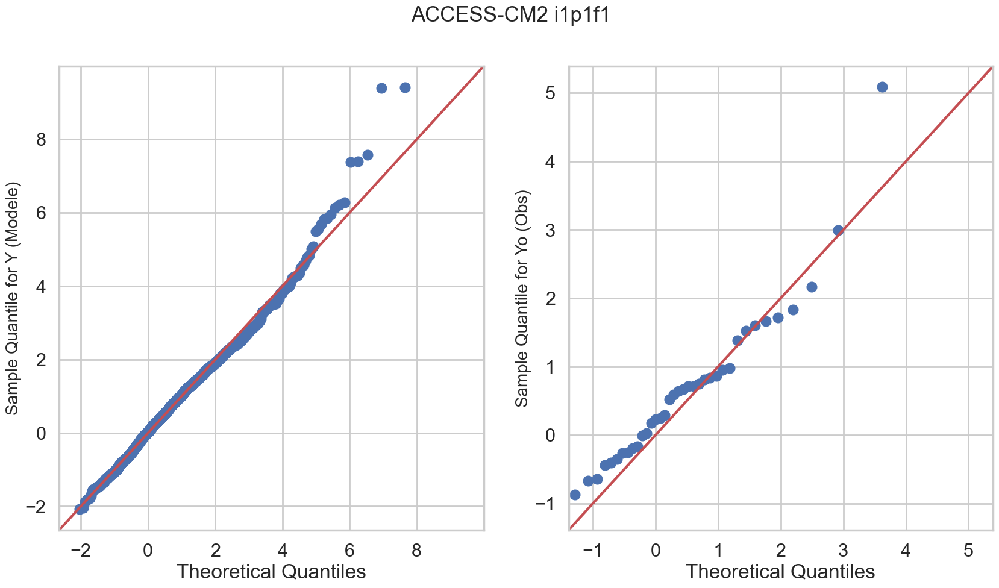

ACCESS-ESM1-5_i1p1f1


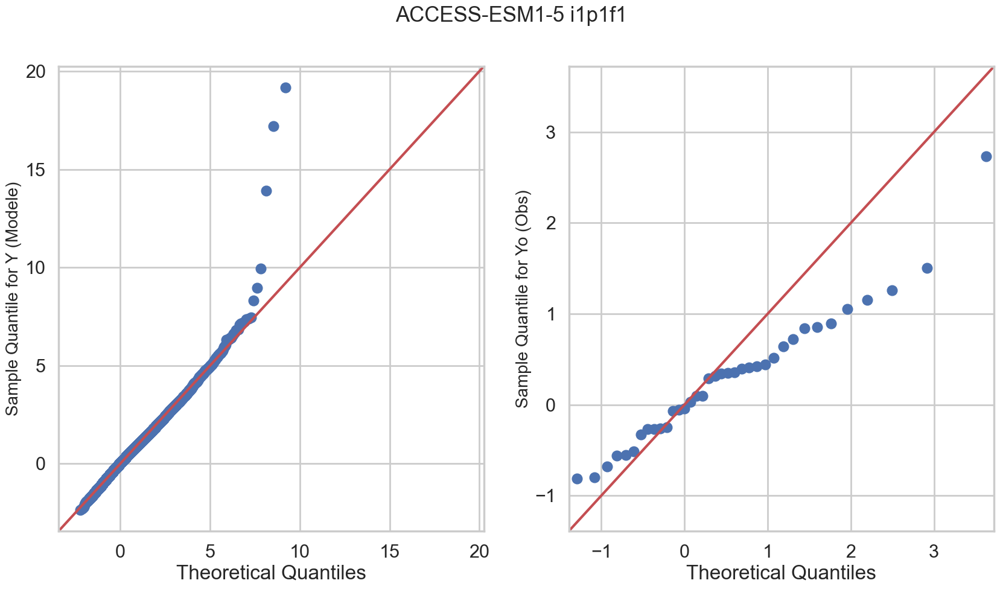

CMCC-ESM2_i1p1f1


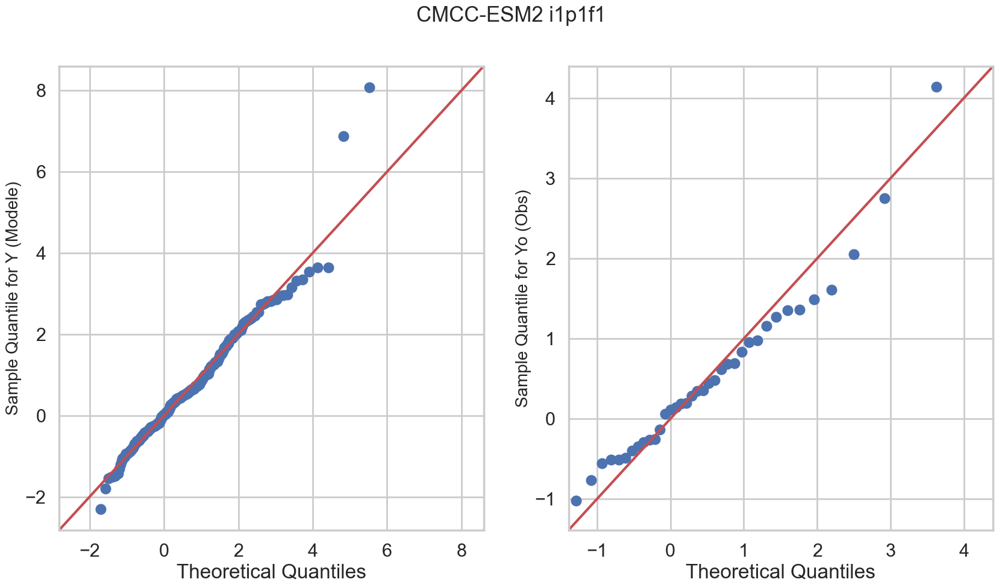

CNRM-CM6-1-HR_i1p1f2


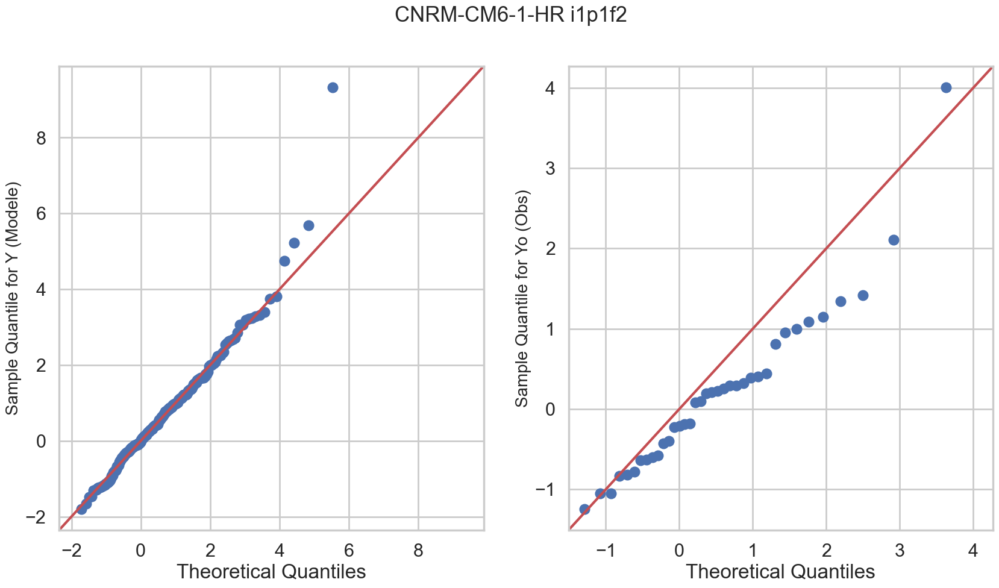

CNRM-CM6-1_i1p1f2


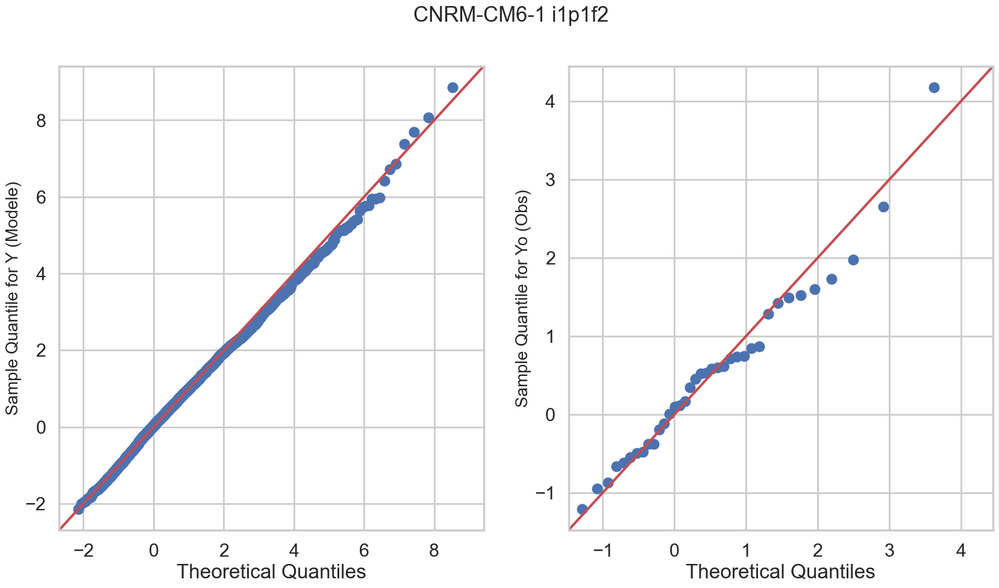

CNRM-ESM2-1_i1p1f2


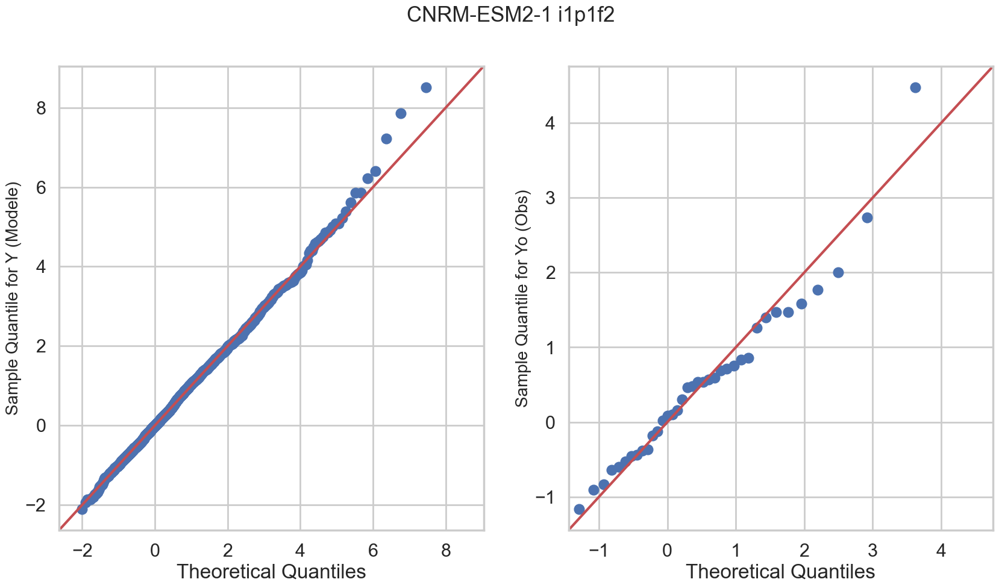

CanESM5_i1p2f1


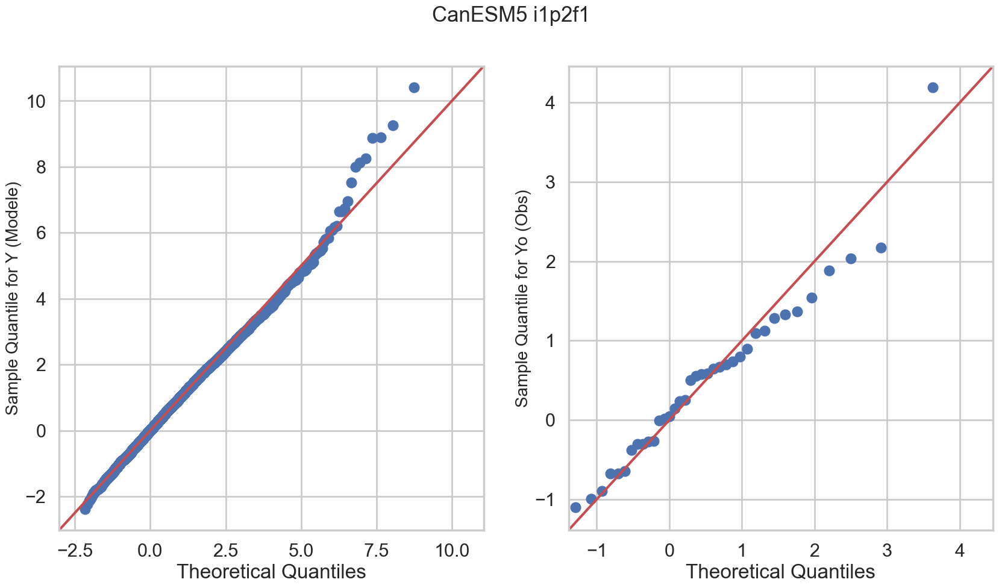

EC-Earth3-CC_i1p1f1


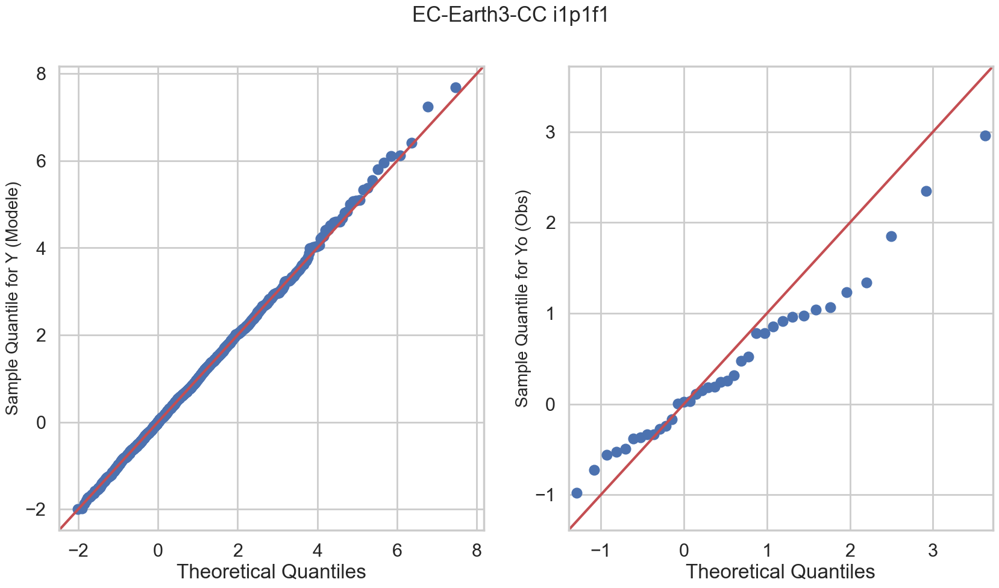

EC-Earth3-Veg-LR_i1p1f1


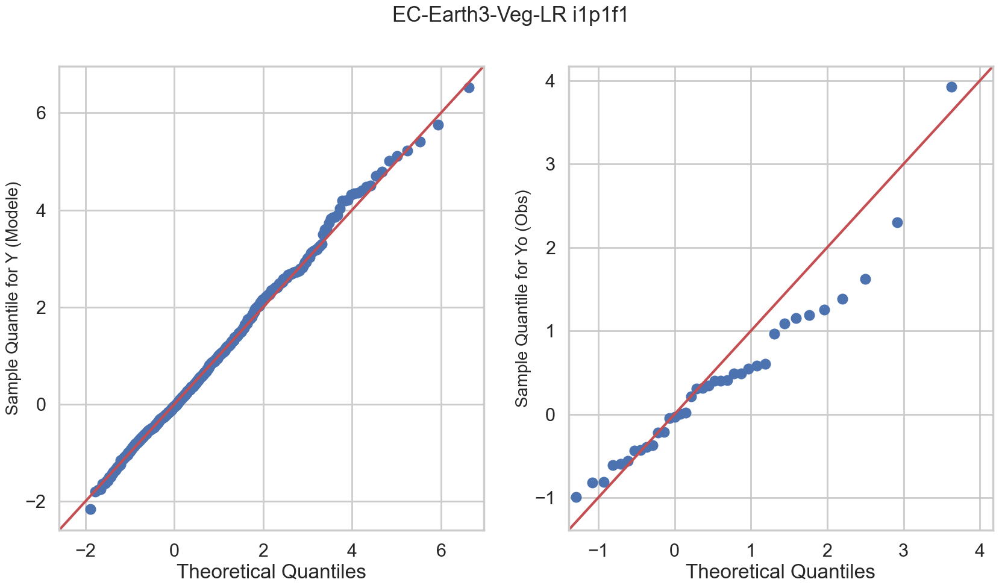

EC-Earth3-Veg_i1p1f1


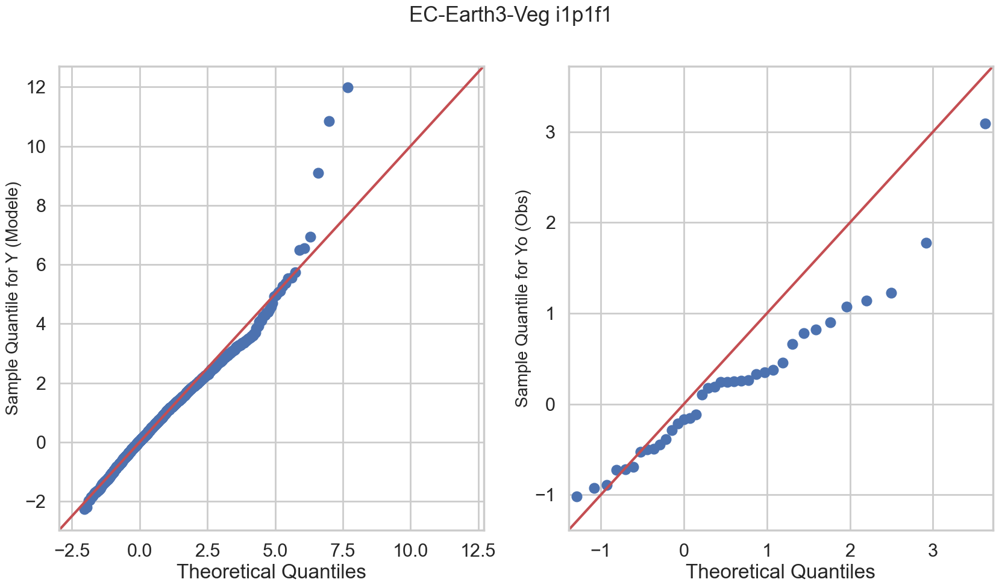

EC-Earth3_i1p1f1


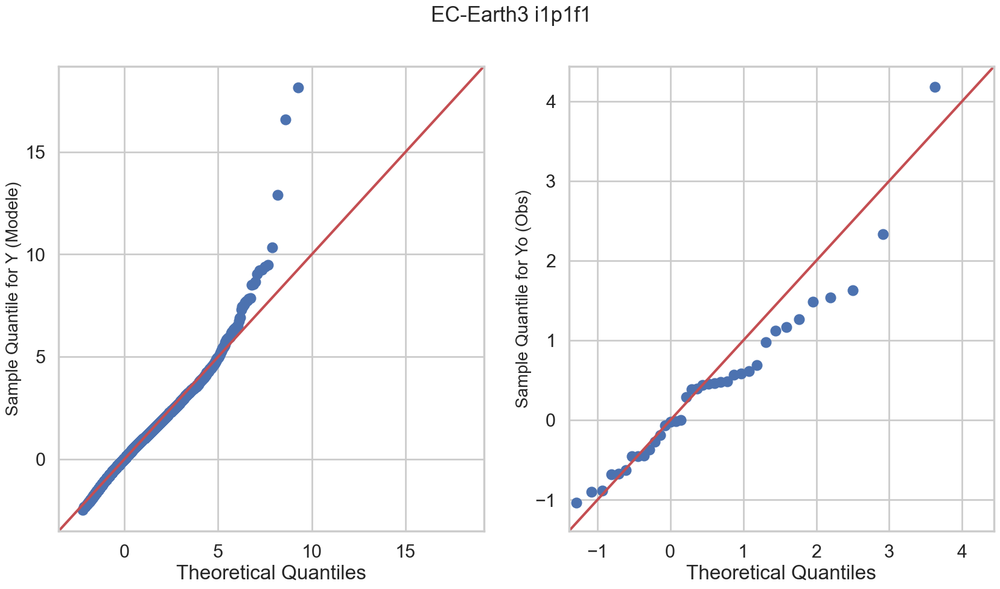

FGOALS-g3_i1p1f1


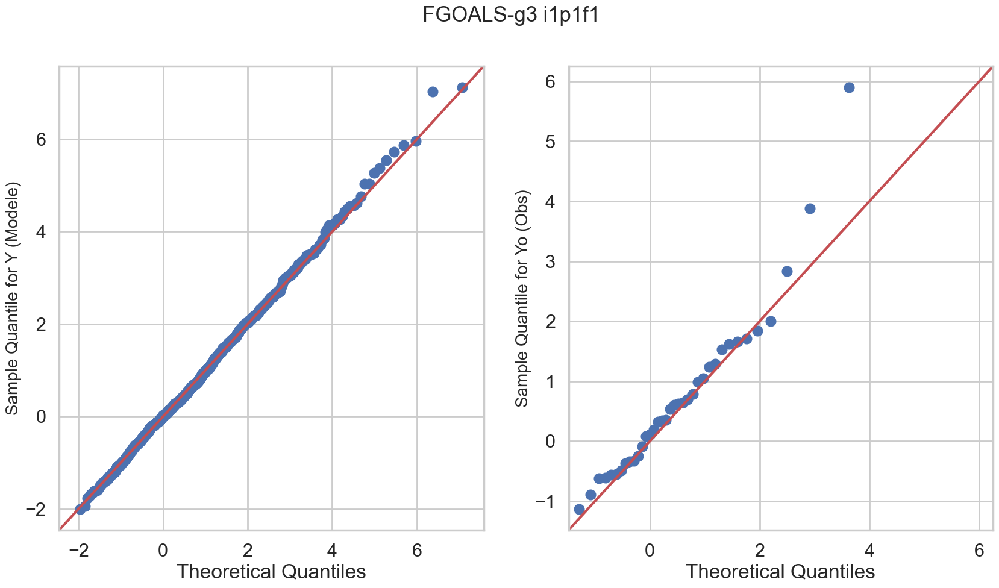

GFDL-ESM4_i1p1f1


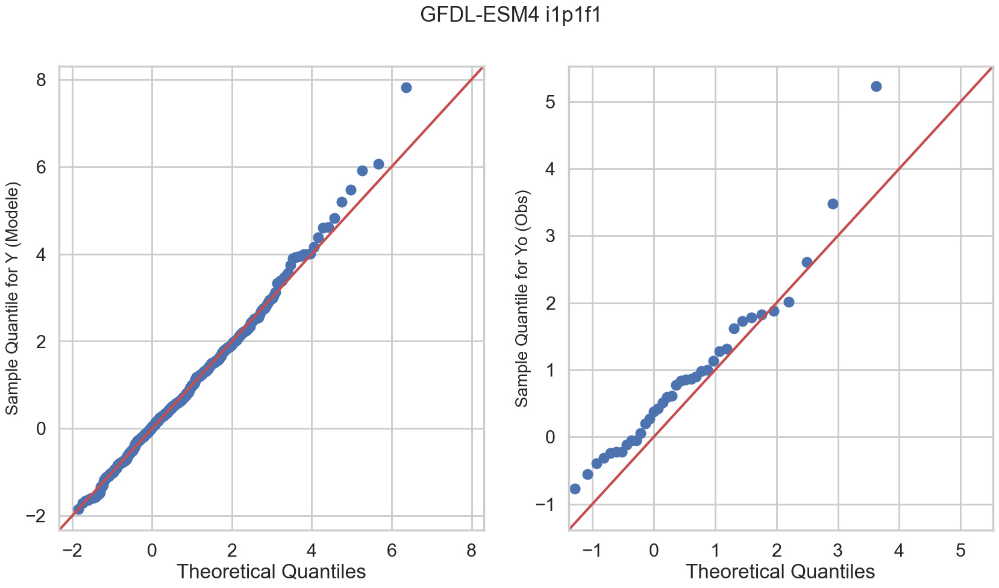

HadGEM3-GC31-LL_i1p1f3


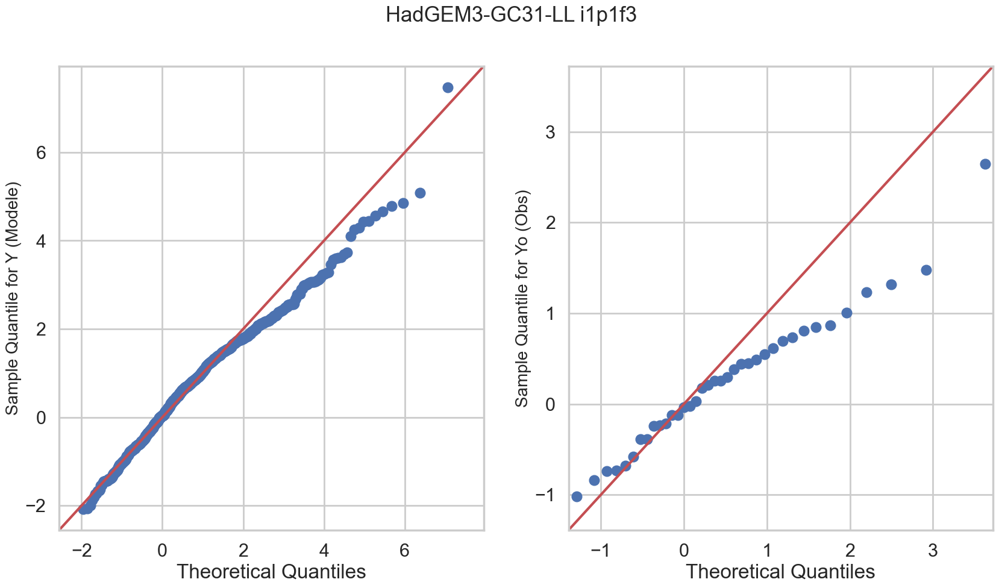

HadGEM3-GC31-MM_i1p1f3


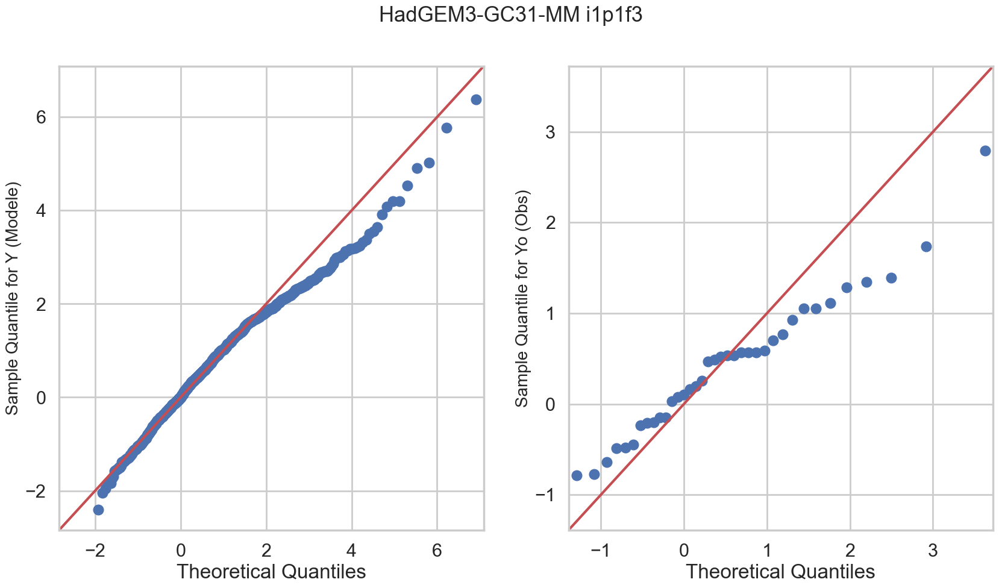

INM-CM4-8_i1p1f1


/tmp/ipykernel_26836/3562890309.py:41: RuntimeWarning: invalid value encountered in log
  residuals.append((1/shape)*np.log(1+shape*(Yo.iloc[i].values[0]-loc)/scale))


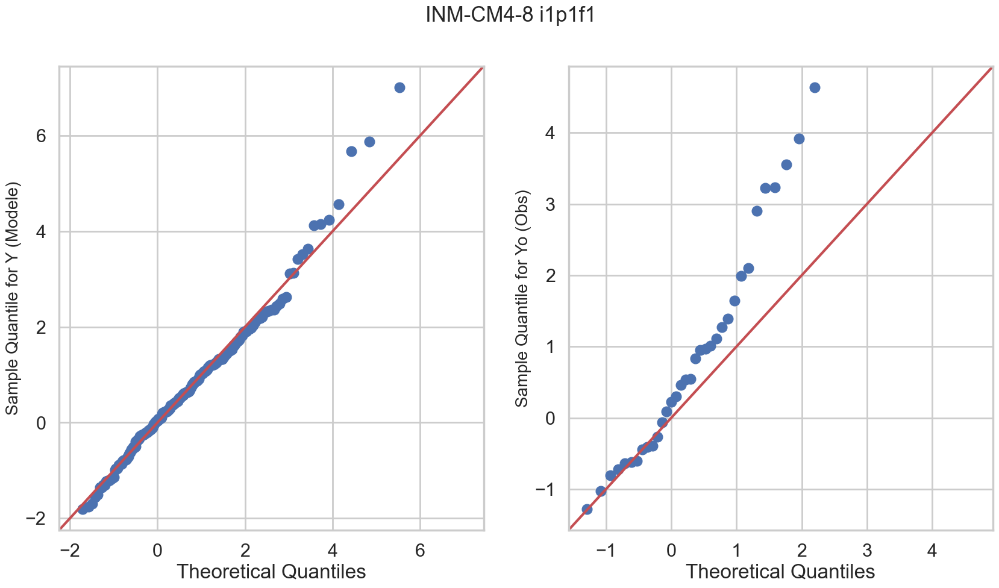

INM-CM5-0_i1p1f1


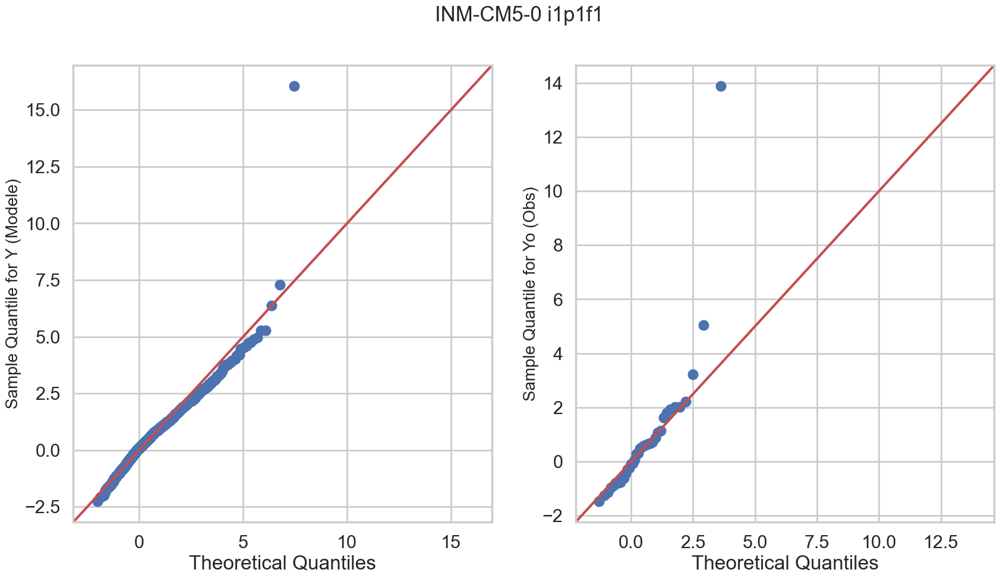

IPSL-CM6A-LR_i1p1f1


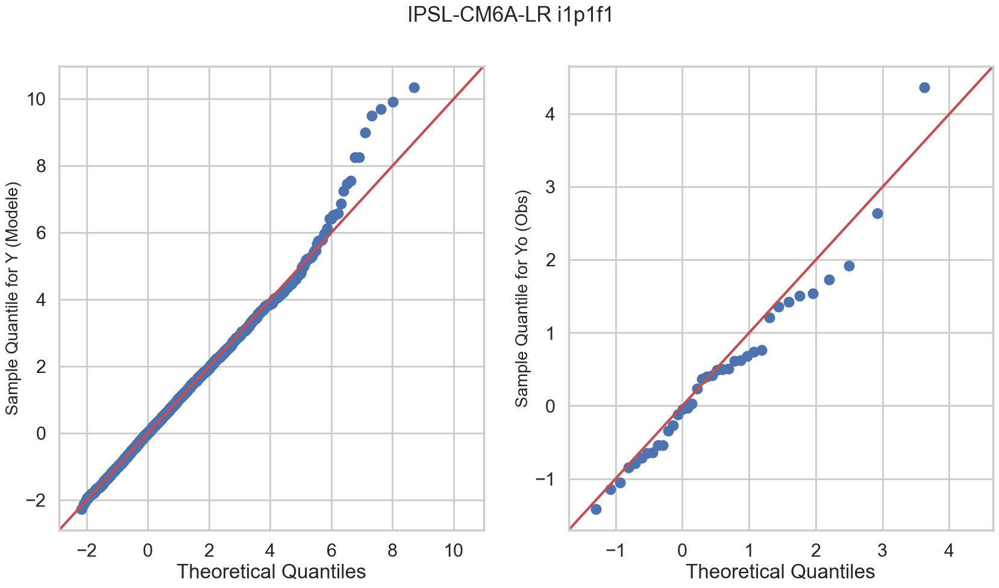

KACE-1-0-G_i1p1f1


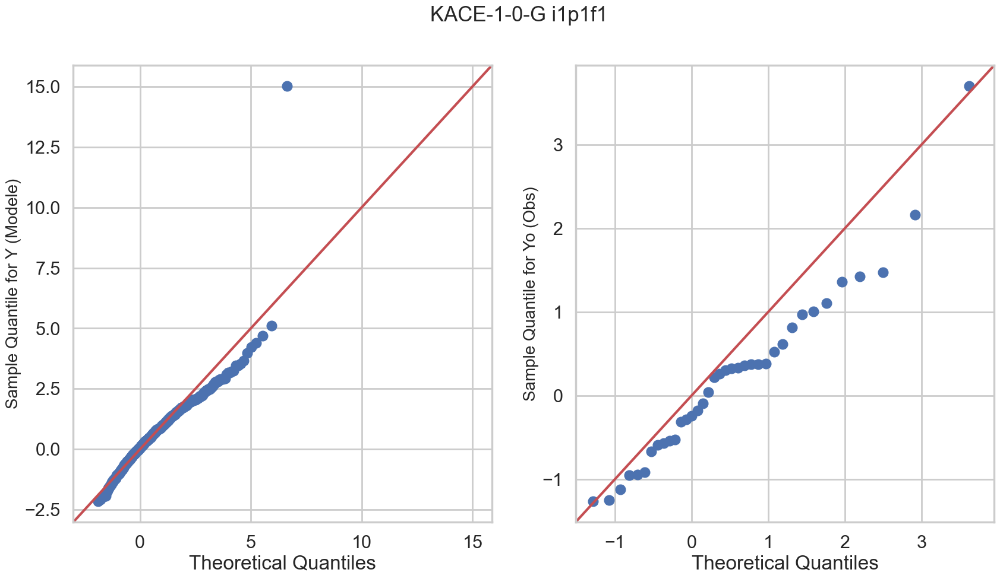

MIROC-ES2L_i1p1f2


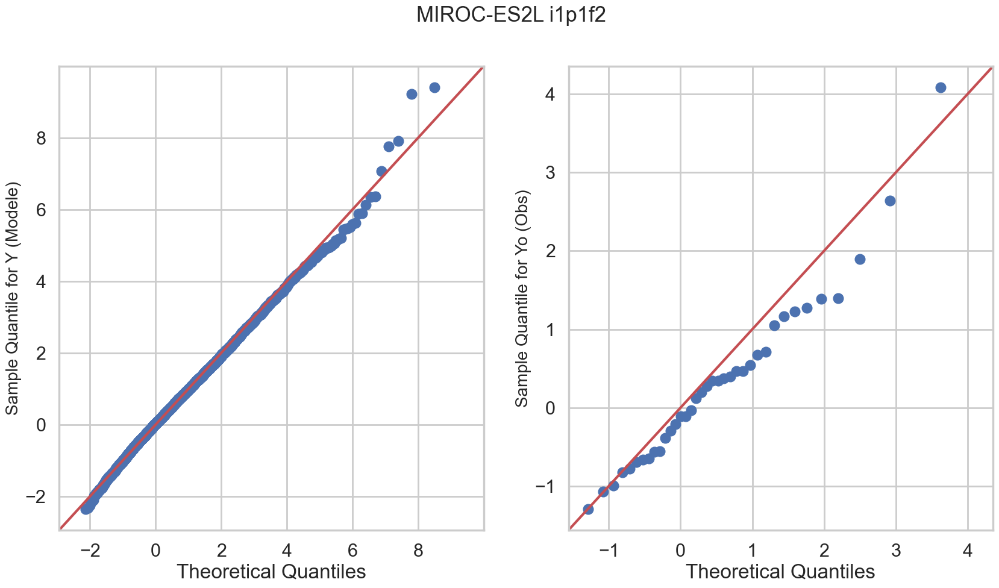

MIROC6_i1p1f1


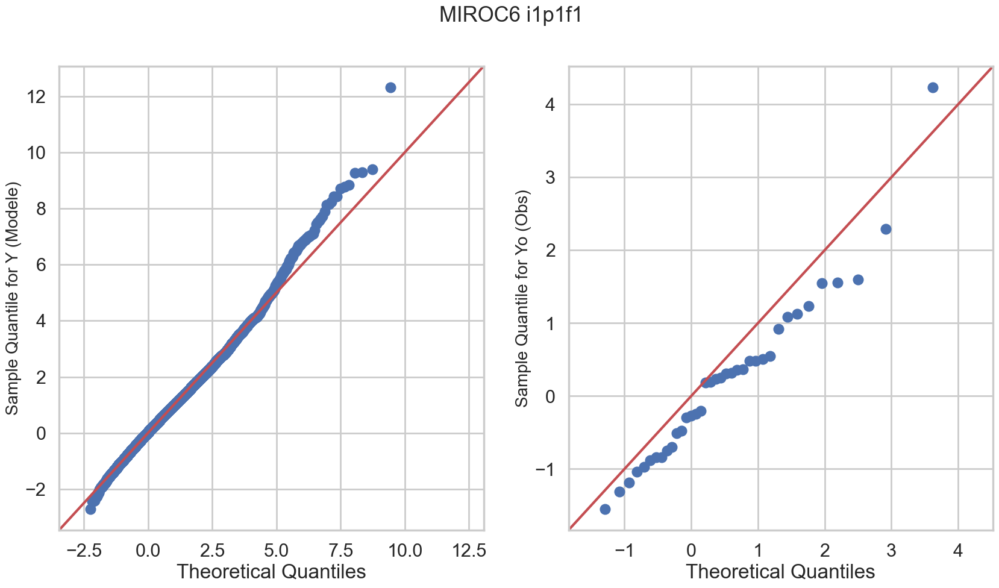

MPI-ESM1-2-LR_i1p1f1


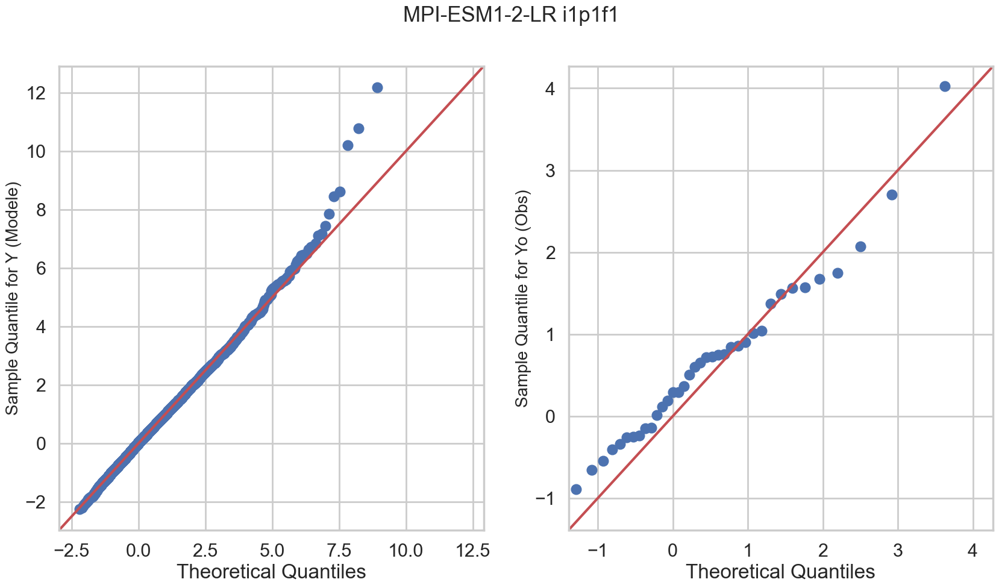

MRI-ESM2-0_i1p1f1


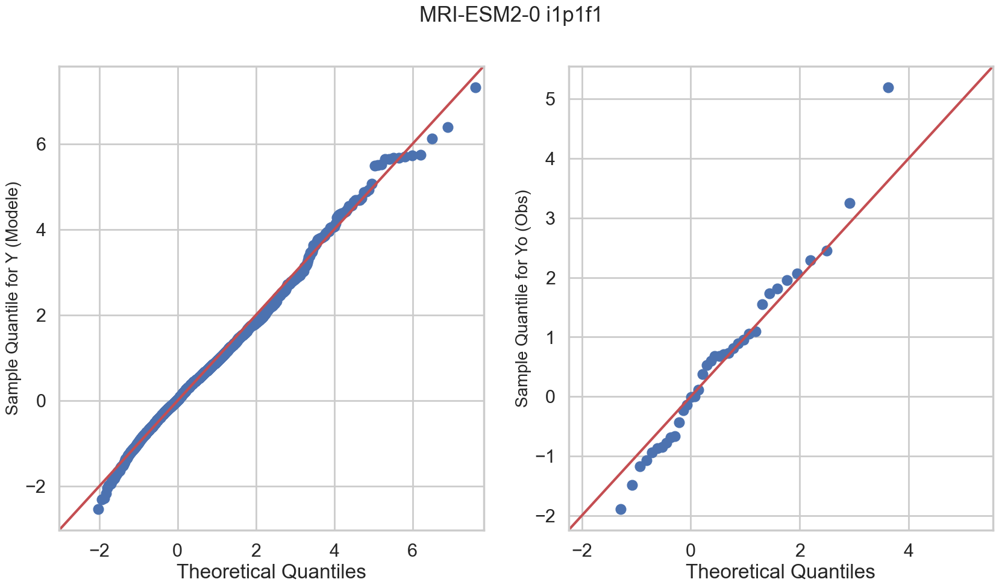

MRI-ESM2-0_i2p1f1


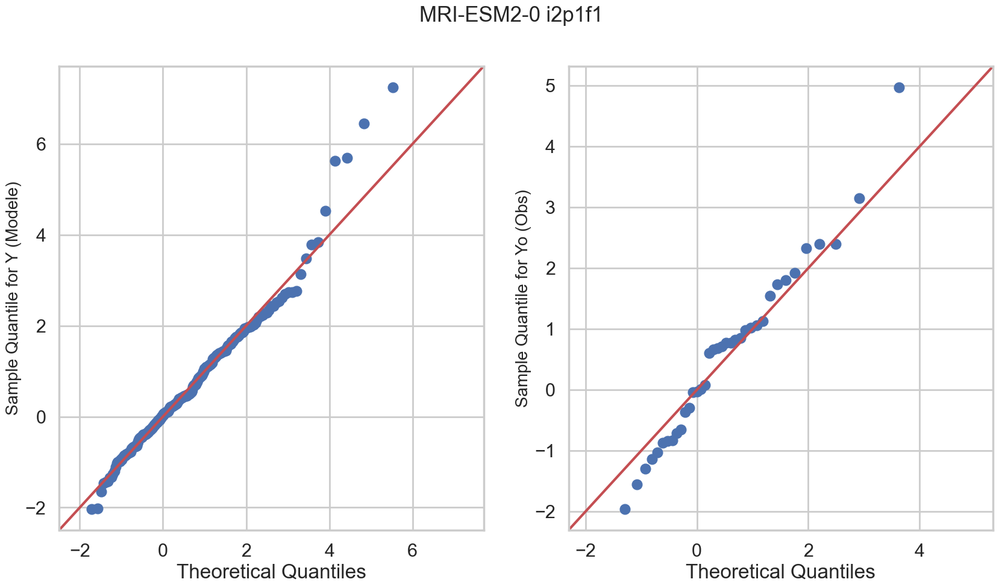

NESM3_i1p1f1


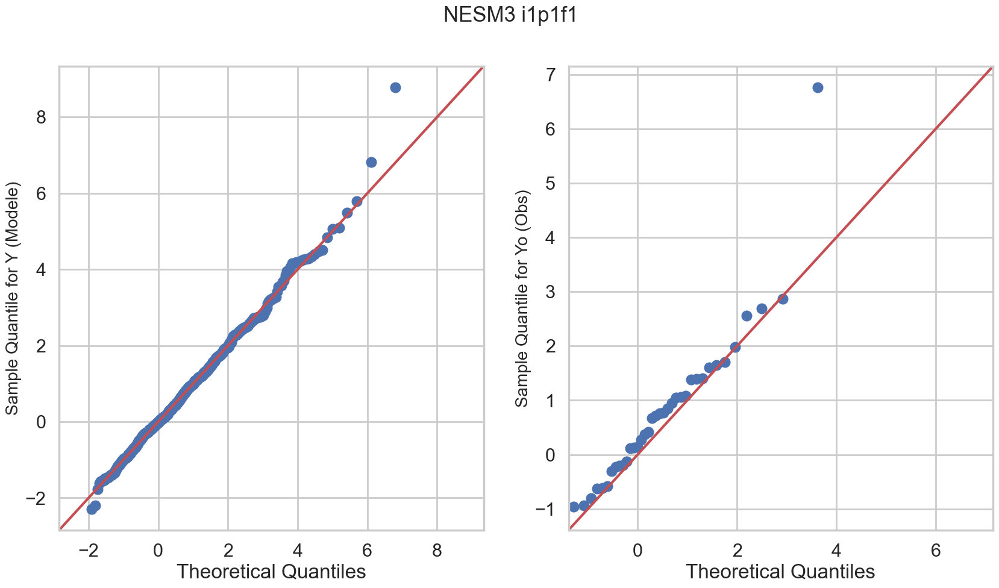

NorESM2-MM_i1p1f1


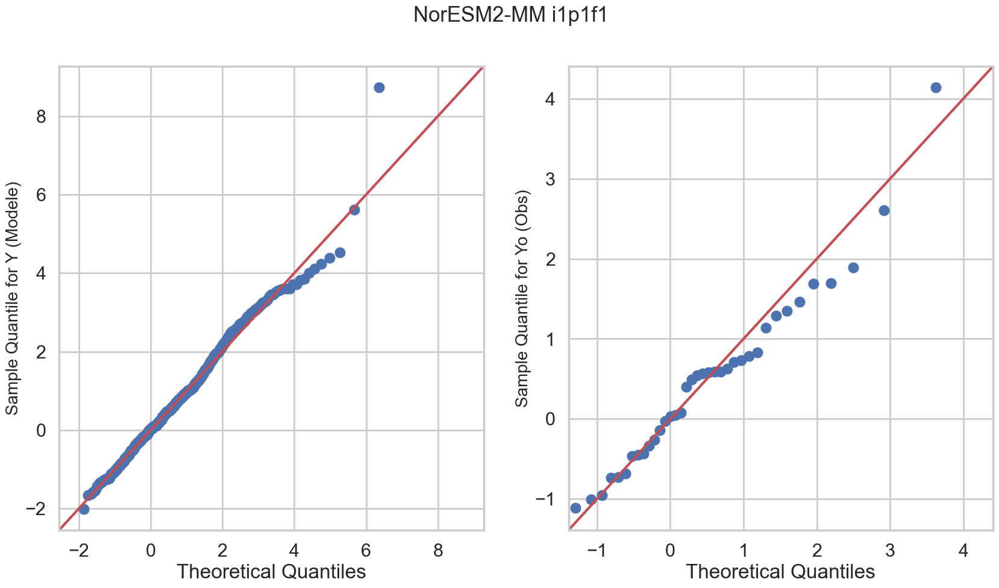

TaiESM1_i1p1f1


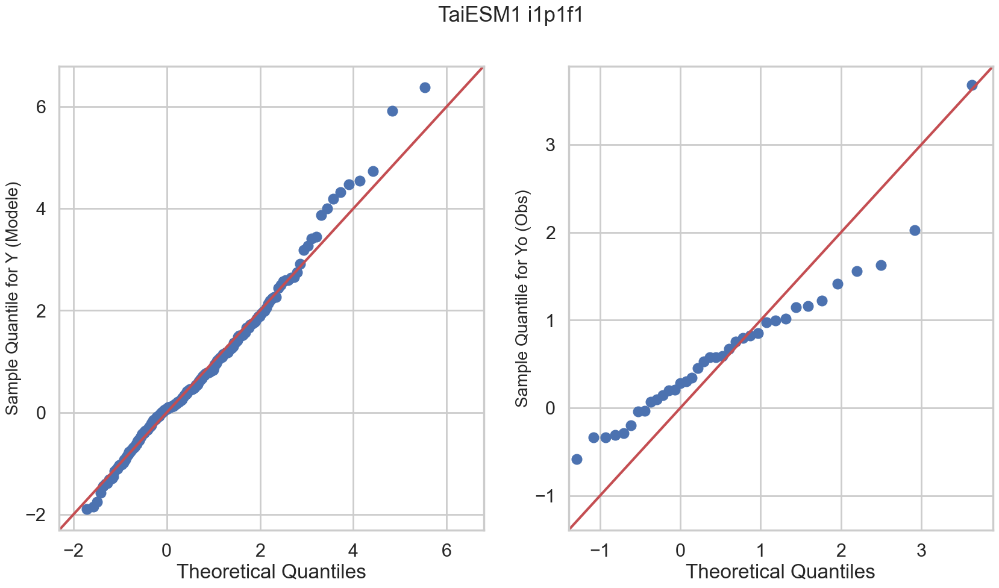

UKESM1-0-LL_i1p1f2


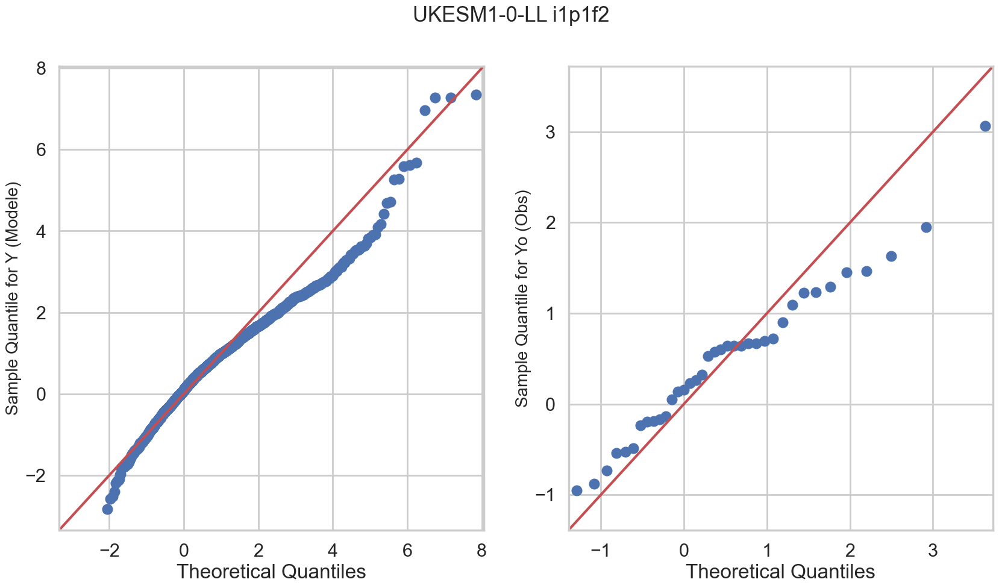

In [9]:
ofile=os.path.join( pathOut , type_data+"_QQplot_Gumbel_GCM_Modeles.pdf" )
pdf = mpdf.PdfPages( ofile )

qparams  = params[:,1:,:,:,:].quantile( [ ci / 2 , 1 - ci / 2 , 0.5 ] , dim = "sample" ).assign_coords( quantile = ["ql","qu","BE"] )
for j in range(0,len(models)):
    m=models[j]
    
    Y=lY[j]
    fig = plt.figure( figsize = (20,10) )
    ax = fig.add_subplot( 1 , 2 ,  1 )

    tY    = Y.index
    X     = clim.X.loc[tY,"BE","F",m]
    X=X.to_pandas()
    residuals=[]
    for i in range(0,len(Y)):
        shape=qparams.loc["BE",Y.index[i],"F",'shape',m].values
        loc=qparams.loc["BE",Y.index[i],"F",'loc',m].values
        scale=qparams.loc["BE",Y.index[i],"F",'scale',m].values
        
        residuals.append((1/shape)*np.log(1+shape*(Y.iloc[i].values[0]-loc)/scale))

    print(m)
    sm.qqplot(np.asarray(residuals),dist=sc.gumbel_r, line="45",ax=ax)

    ax.set_ylabel("Sample Quantile for Y (Modele)", fontsize = 20 )
    
    
    #Y=lY[j]
    ax = fig.add_subplot( 1 , 2 , 2 )

    tY    = Yo.index
    X     = Xo.loc[tY]
    #X=X.to_pandas()
    residuals=[]
    for i in range(0,len(Yo)):
        shape=qparams.loc["BE",Yo.index[i],"F",'shape',m].values
        loc=qparams.loc["BE",Yo.index[i],"F",'loc',m].values
        scale=qparams.loc["BE",Yo.index[i],"F",'scale',m].values
        
        residuals.append((1/shape)*np.log(1+shape*(Yo.iloc[i].values[0]-loc)/scale))

    sm.qqplot(np.asarray(residuals),dist=sc.gumbel_r, line="45",ax=ax)
    ax.set_ylabel("Sample Quantile for Yo (Obs)", fontsize = 20 )
    fig.suptitle( " ".join(m.split("_")) , fontsize = 25 )
    plt.show()
    pdf.savefig(fig)
    plt.close(fig)
pdf.close()

ACCESS-CM2_i1p1f1


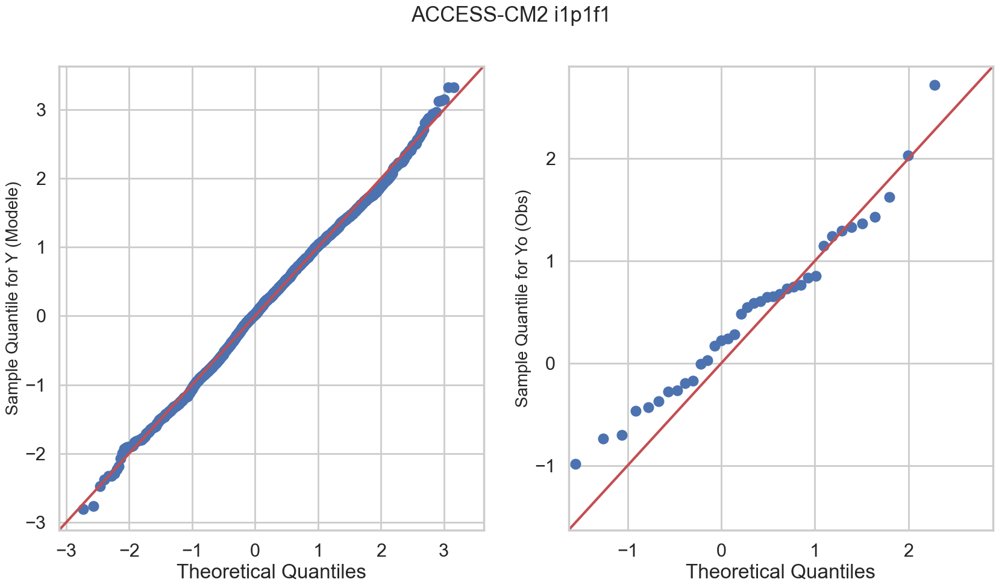

ACCESS-ESM1-5_i1p1f1


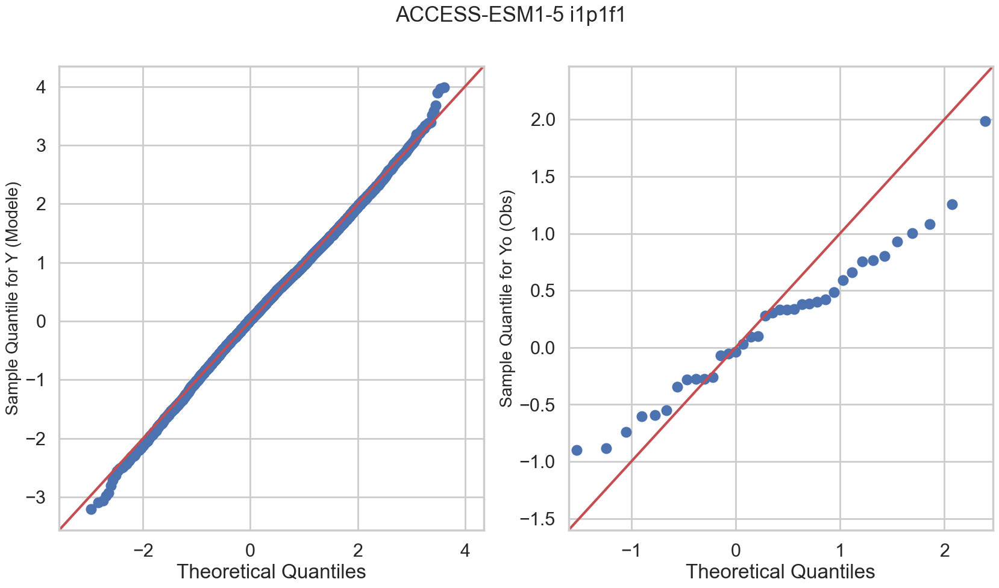

CMCC-ESM2_i1p1f1


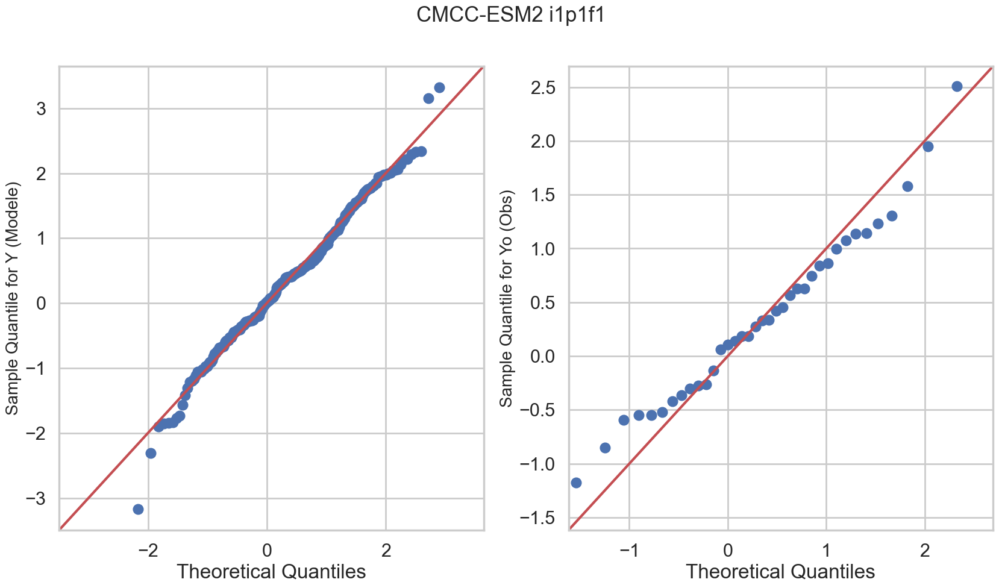

CNRM-CM6-1-HR_i1p1f2


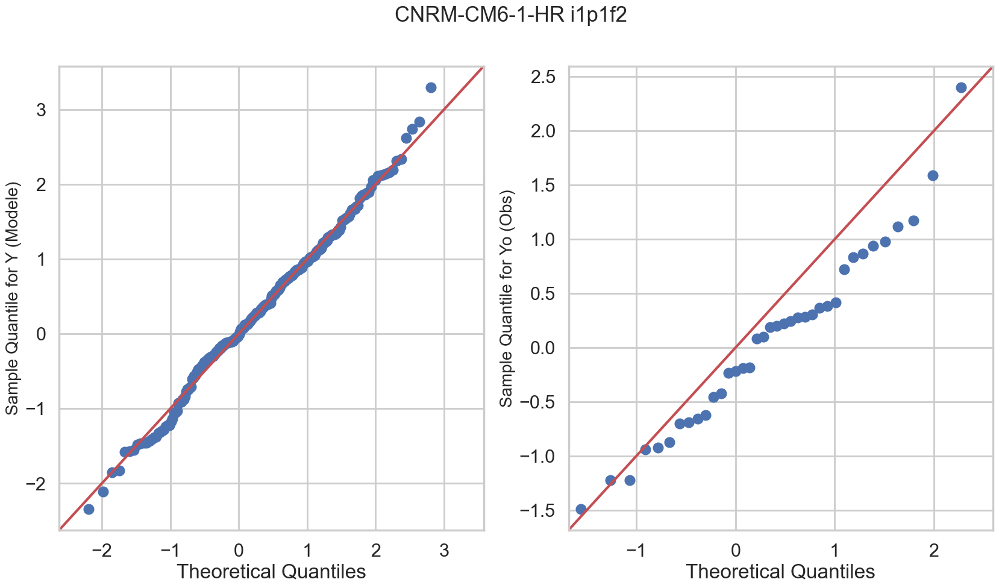

CNRM-CM6-1_i1p1f2


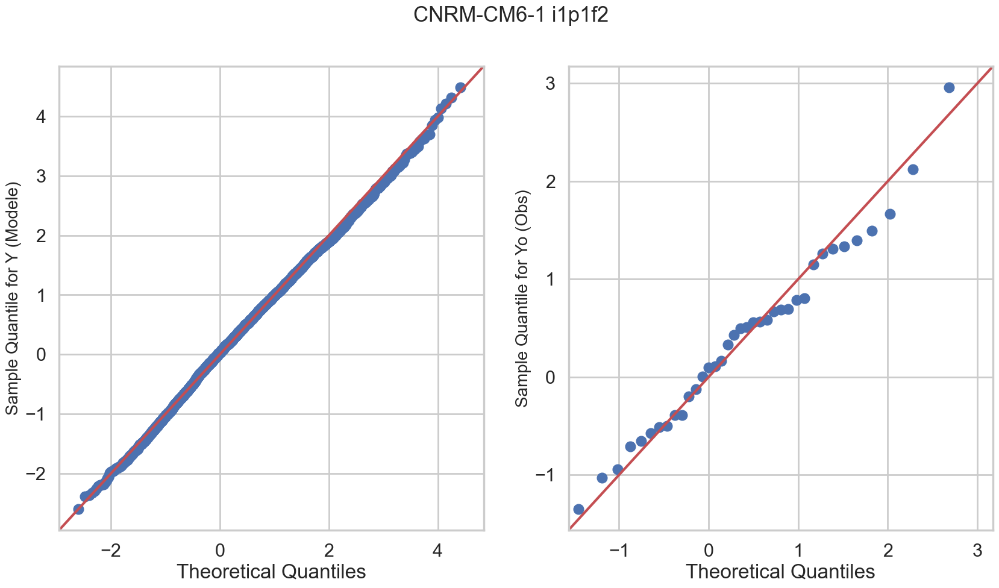

CNRM-ESM2-1_i1p1f2


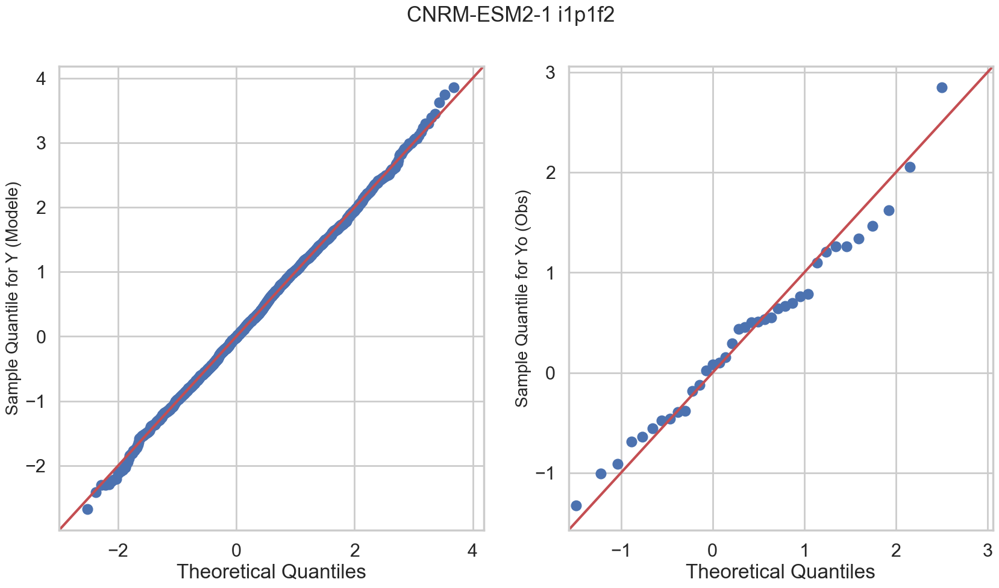

CanESM5_i1p2f1


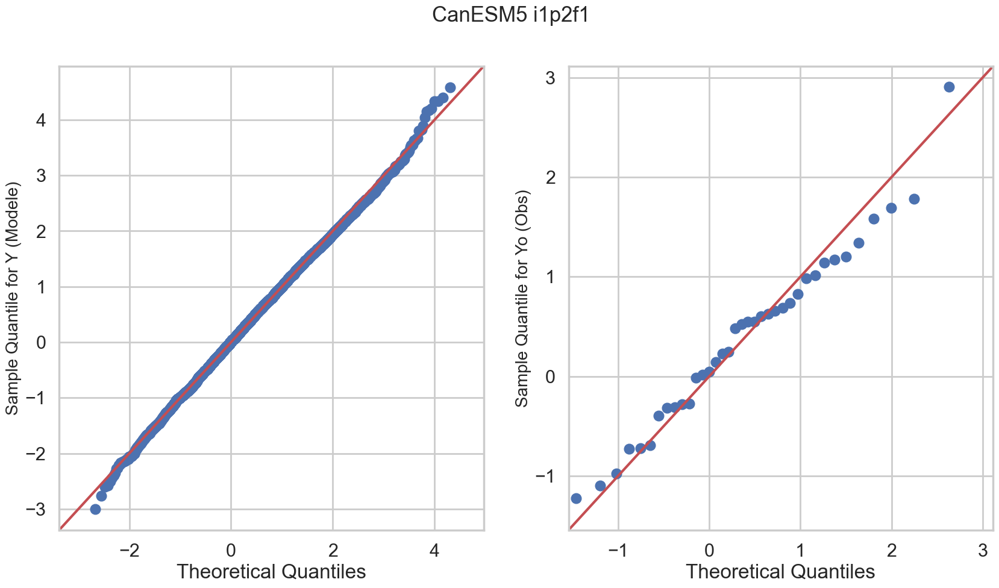

EC-Earth3-CC_i1p1f1


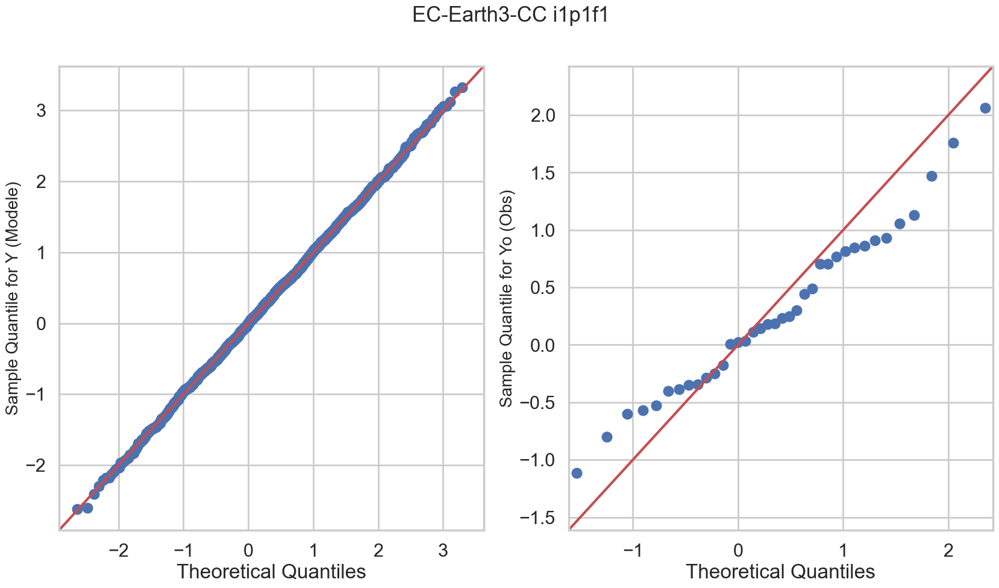

EC-Earth3-Veg-LR_i1p1f1


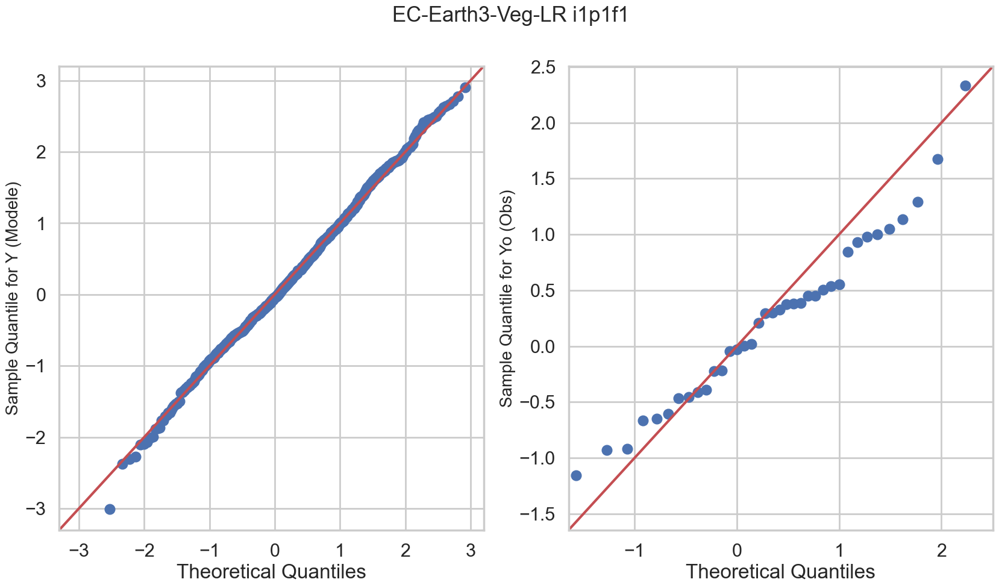

EC-Earth3-Veg_i1p1f1


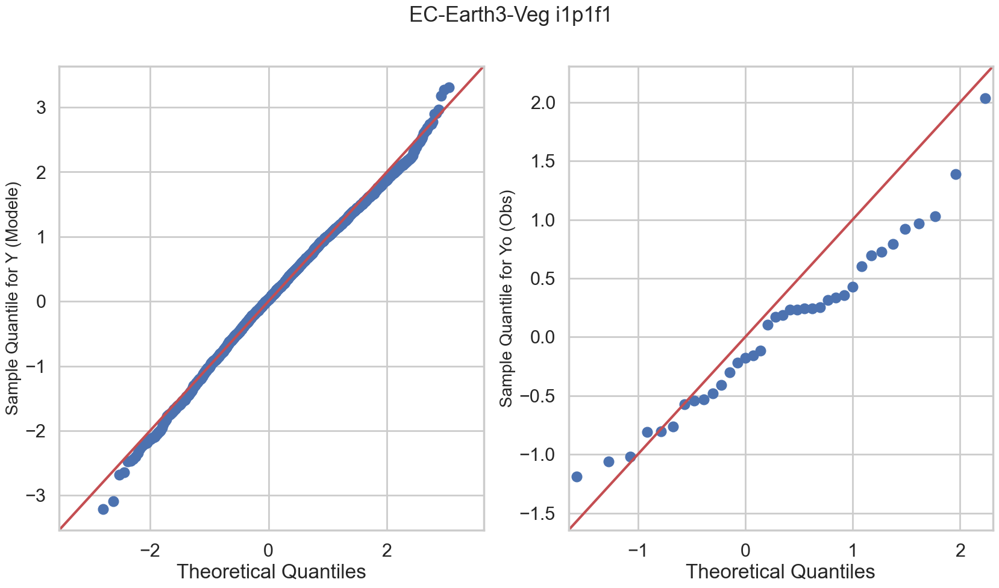

EC-Earth3_i1p1f1


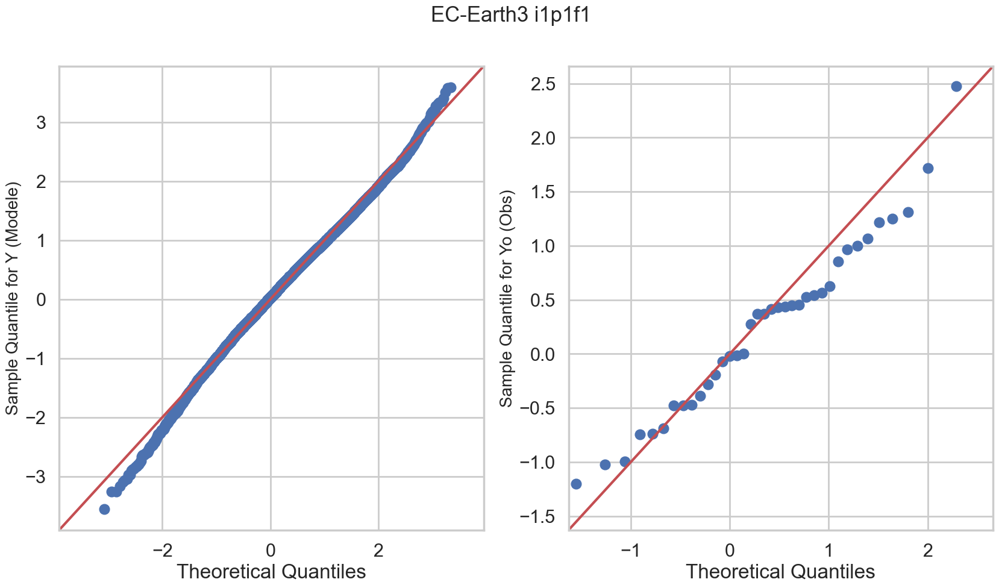

FGOALS-g3_i1p1f1


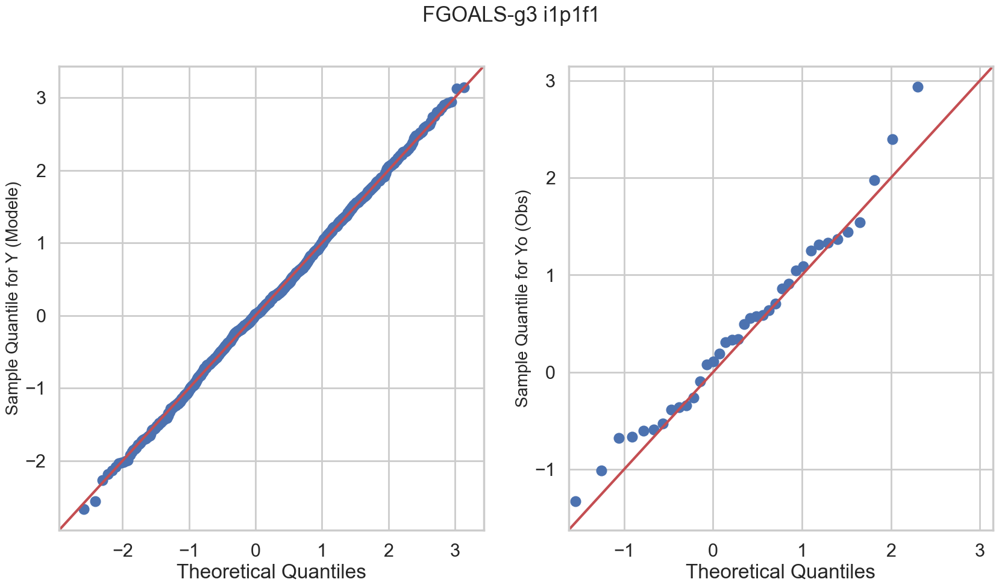

GFDL-ESM4_i1p1f1


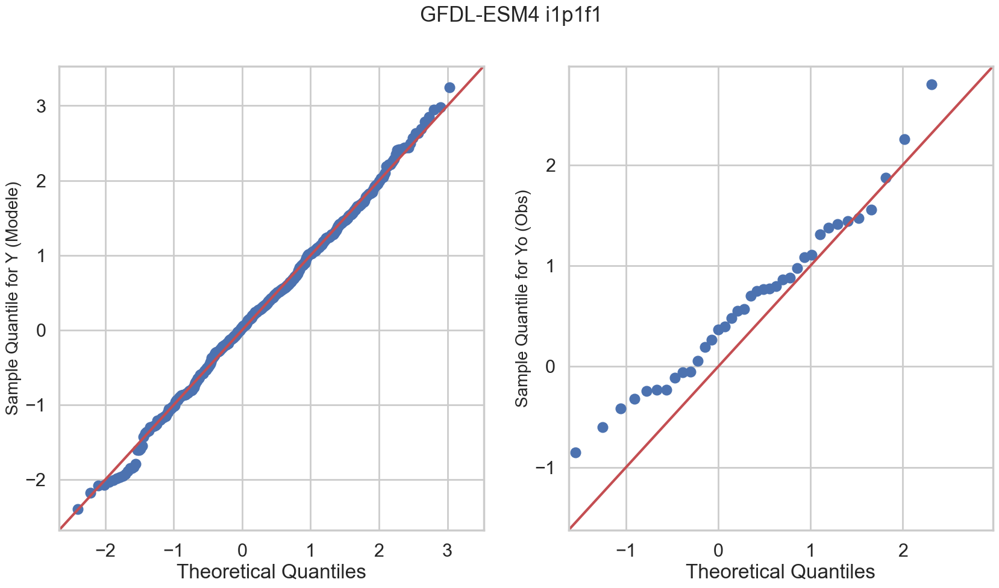

HadGEM3-GC31-LL_i1p1f3


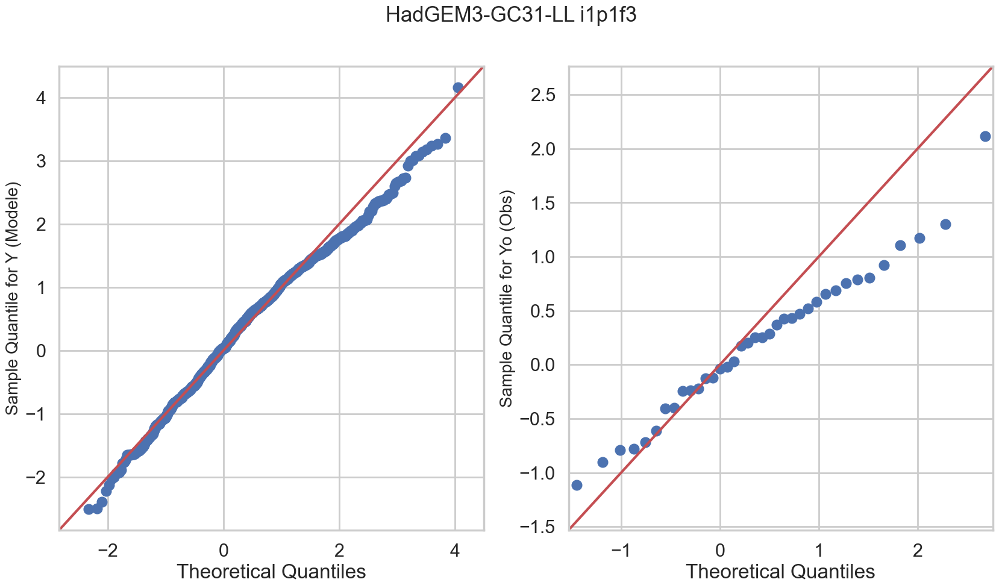

HadGEM3-GC31-MM_i1p1f3


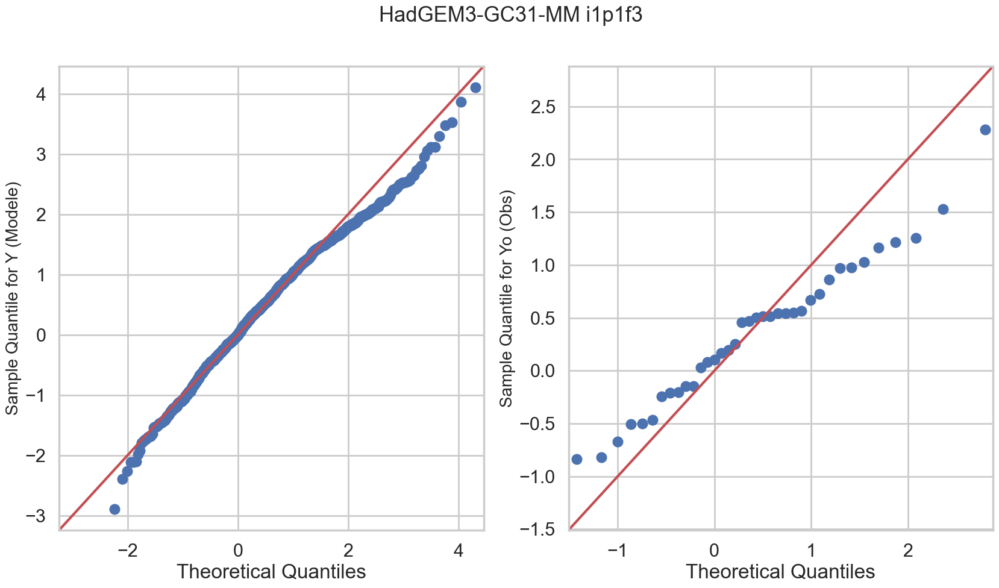

INM-CM4-8_i1p1f1


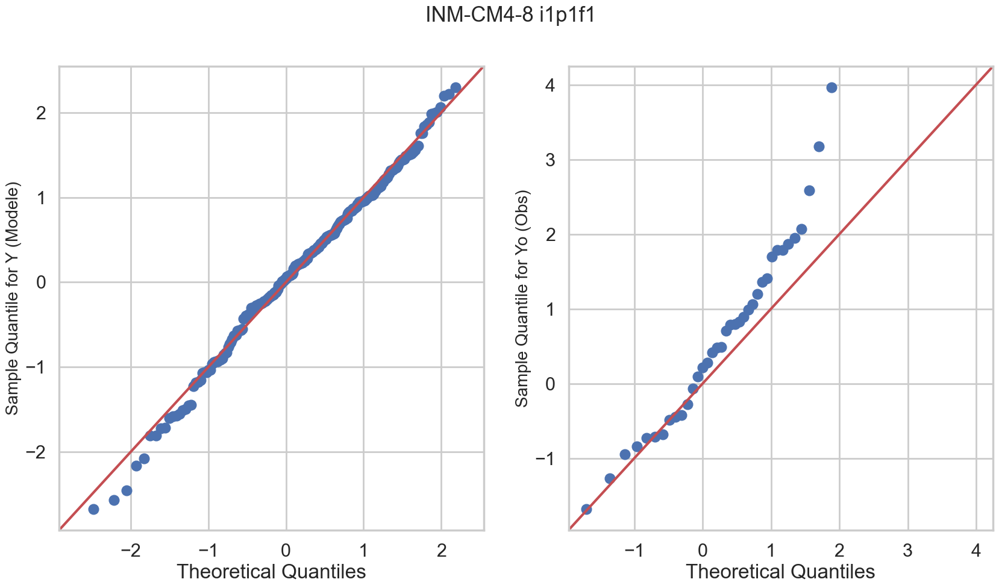

INM-CM5-0_i1p1f1


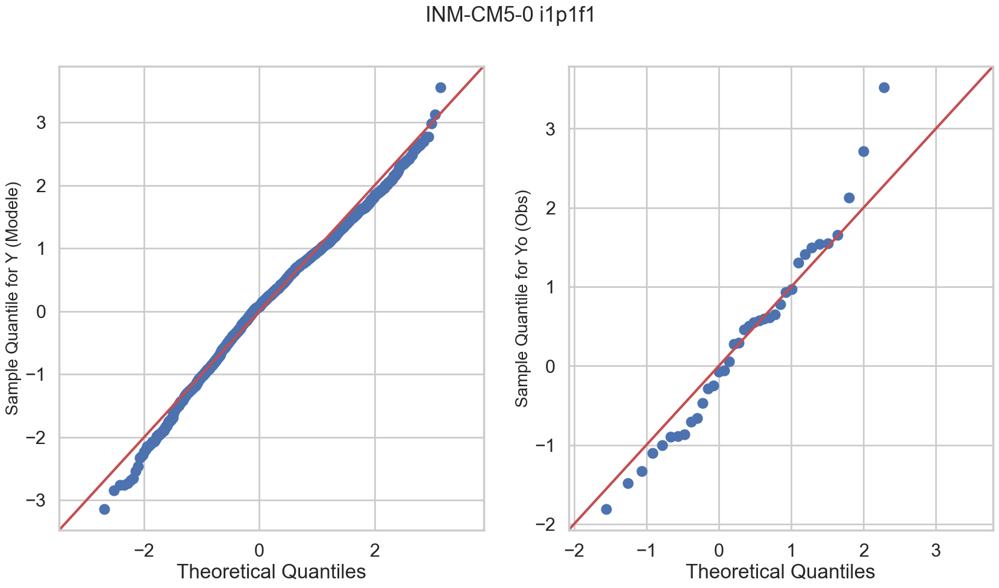

IPSL-CM6A-LR_i1p1f1


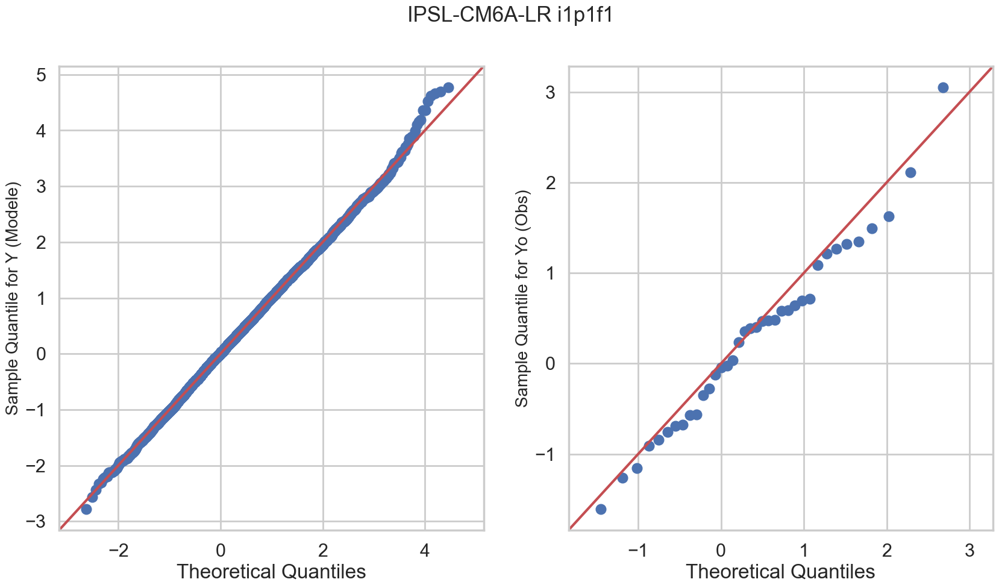

KACE-1-0-G_i1p1f1


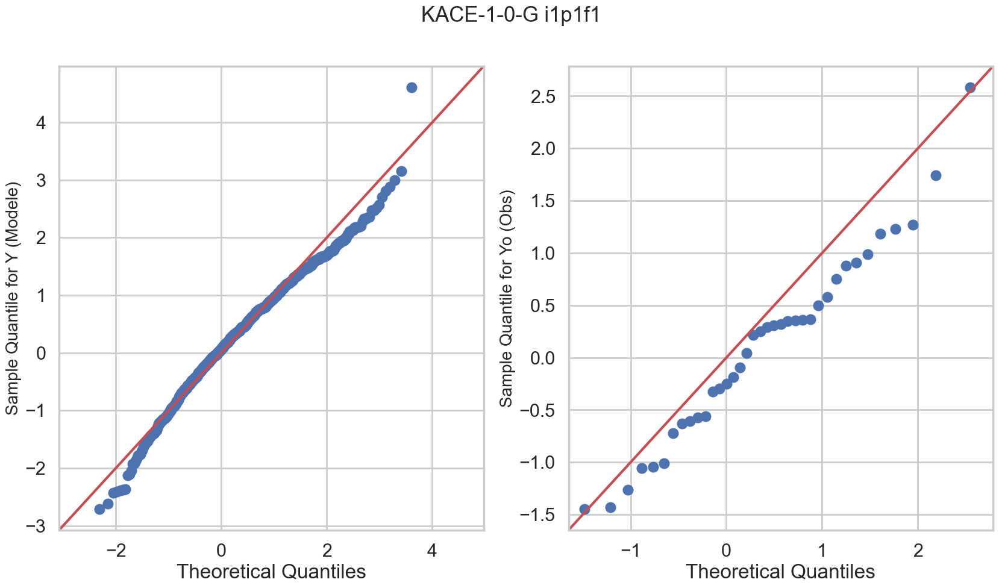

MIROC-ES2L_i1p1f2


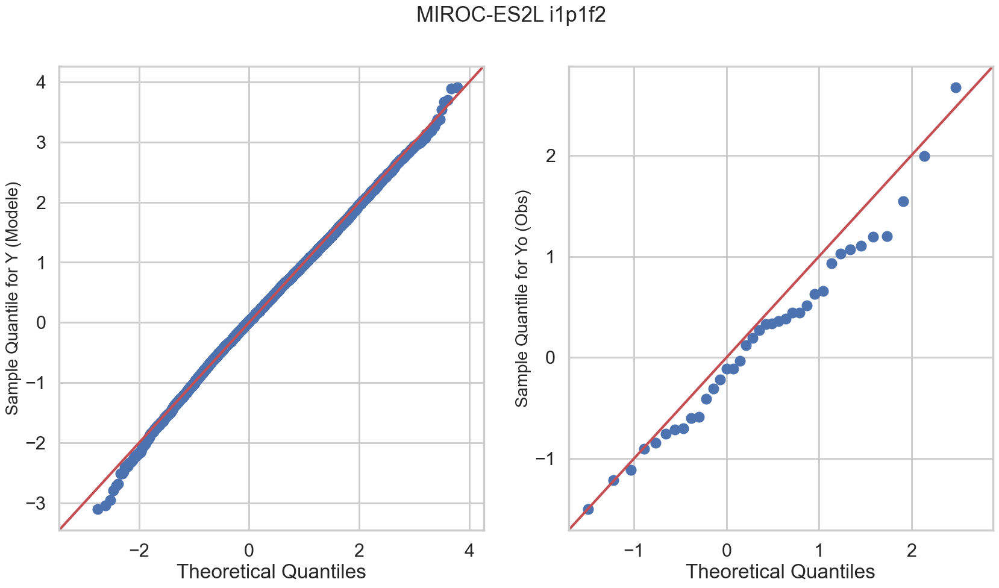

MIROC6_i1p1f1


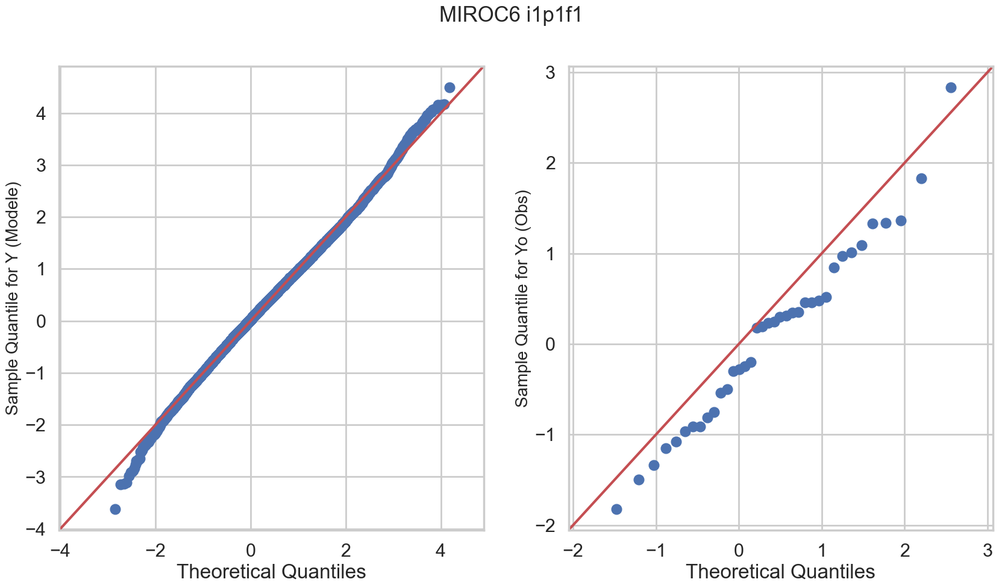

MPI-ESM1-2-LR_i1p1f1


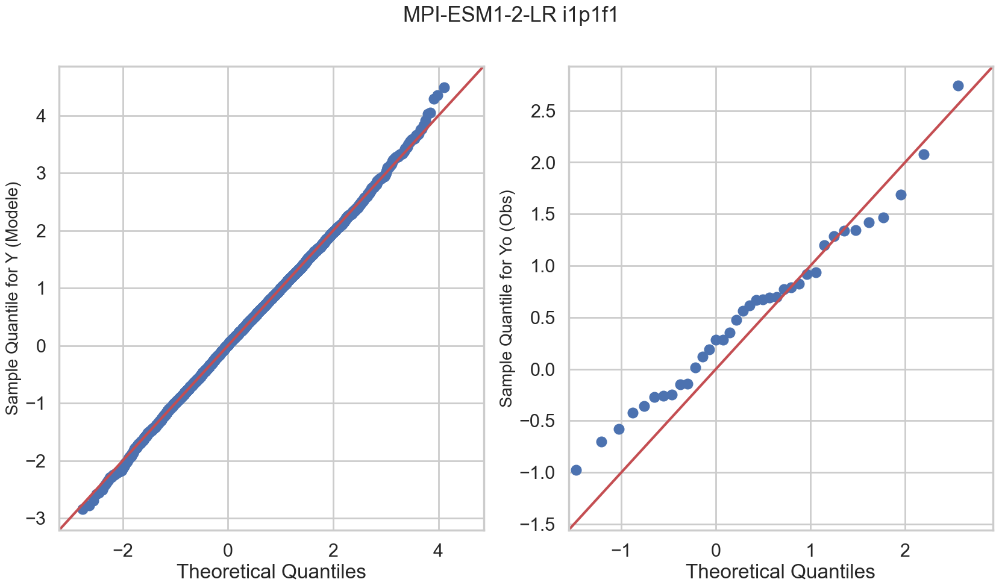

MRI-ESM2-0_i1p1f1


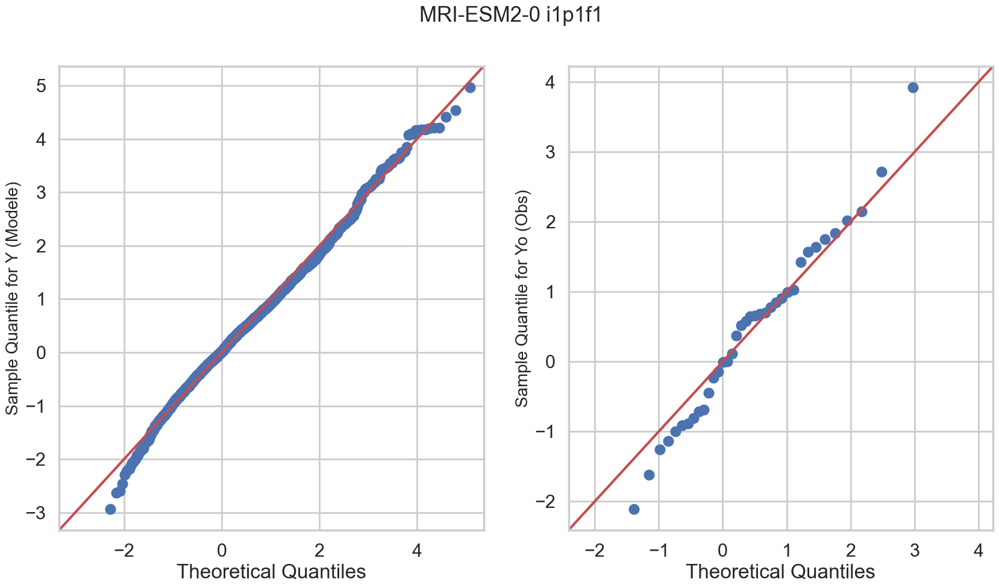

MRI-ESM2-0_i2p1f1


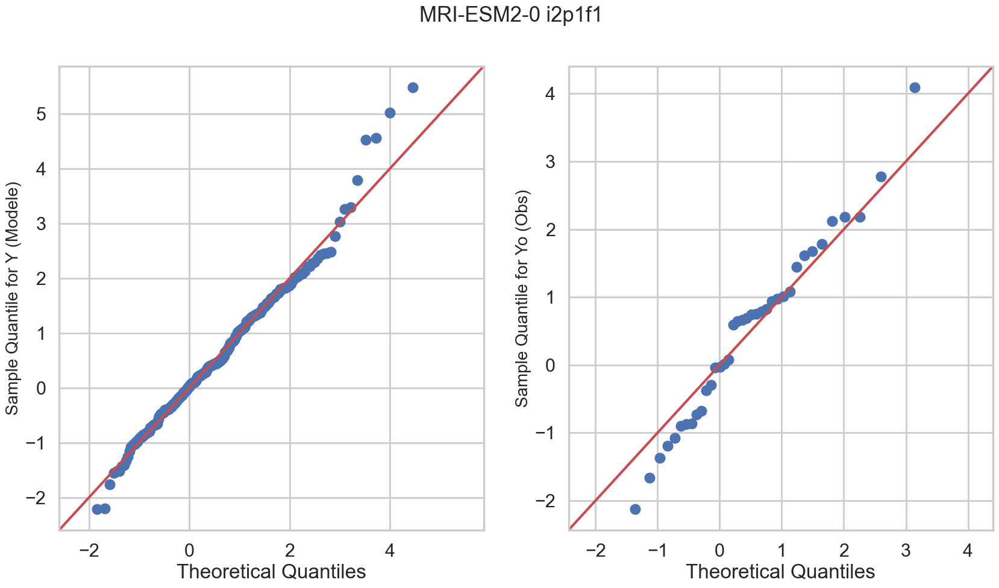

NESM3_i1p1f1


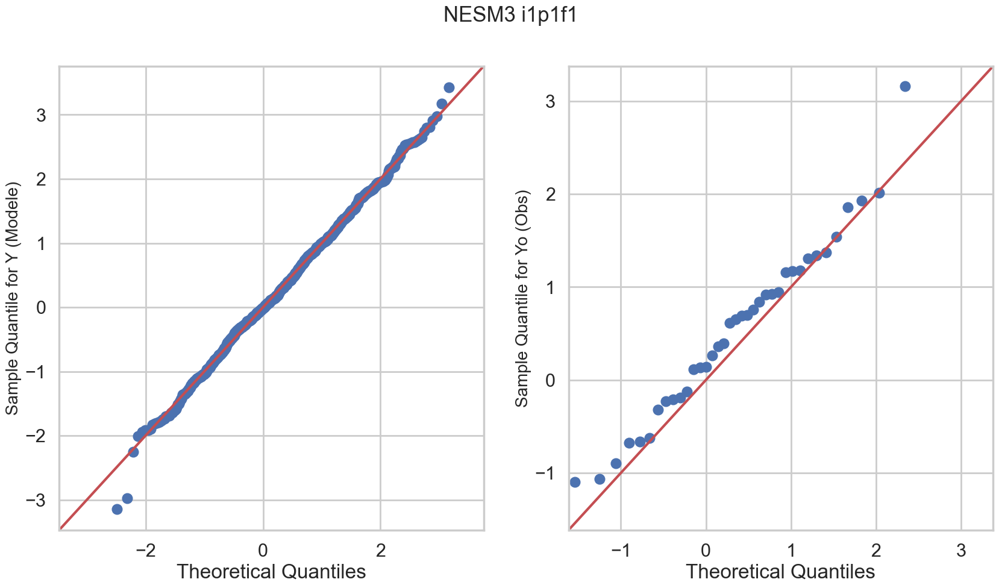

NorESM2-MM_i1p1f1


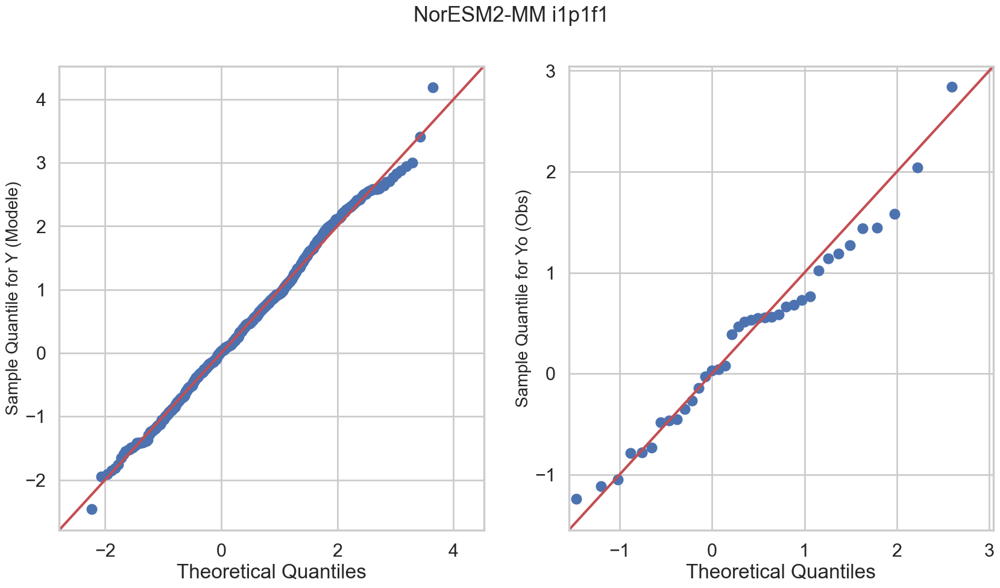

TaiESM1_i1p1f1


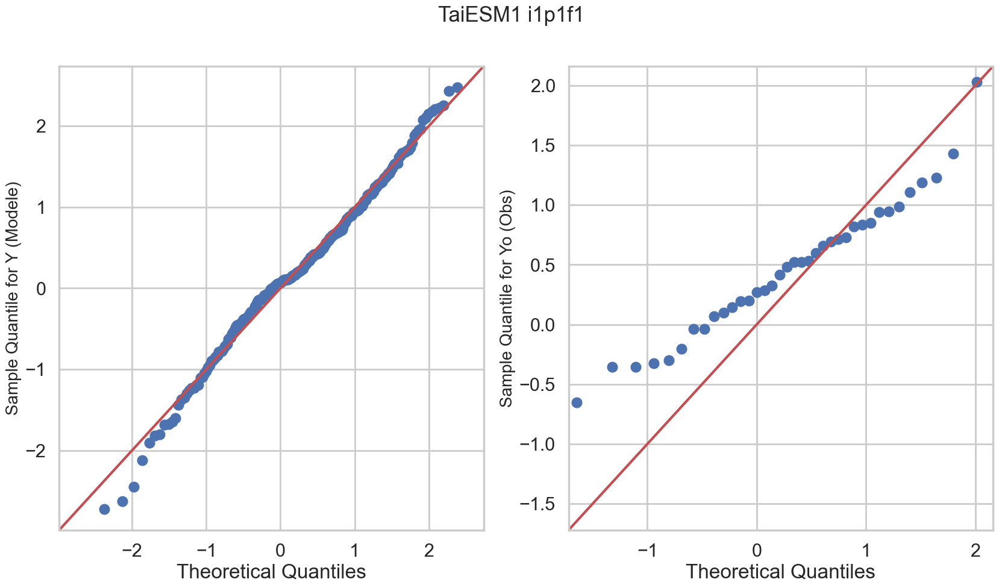

UKESM1-0-LL_i1p1f2


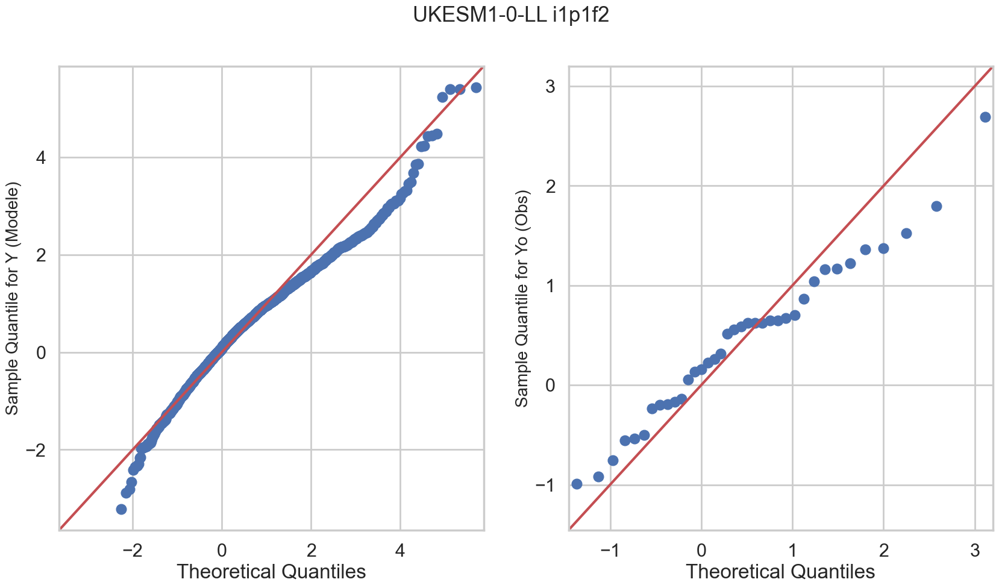

In [10]:
ofile=os.path.join( pathOut , type_data+"_QQplot_GEV_GCM_Modeles.pdf" )
pdf = mpdf.PdfPages( ofile )

qparams  = params[:,1:,:,:,:].quantile( [ ci / 2 , 1 - ci / 2 , 0.5 ] , dim = "sample" ).assign_coords( quantile = ["ql","qu","BE"] )
for j in range(0,len(models)):
    m=models[j]
    
    Y=lY[j]
    fig = plt.figure( figsize = (20,10) )
    ax = fig.add_subplot( 1 , 2 ,  1 )

    tY    = Y.index
    X     = clim.X.loc[tY,"BE","F",m]
    X=X.to_pandas()
    residuals=[]
    for i in range(0,len(Y)):
        shape=qparams.loc["BE",Y.index[i],"F",'shape',m].values
        loc=qparams.loc["BE",Y.index[i],"F",'loc',m].values
        scale=qparams.loc["BE",Y.index[i],"F",'scale',m].values
        
        #residuals.append((1/shape)*np.log(1+shape*(Y.iloc[i].values[0]-loc)/scale))

    
        residuals.append((Y.iloc[i].values[0]-loc)/scale)
    print(m)
    sm.qqplot(np.asarray(residuals),dist=sc.genextreme,distargs=(-shape,), line="45",ax=ax)
    ax.set_ylabel("Sample Quantile for Y (Modele)", fontsize = 20 )
    
    
    #Y=lY[j]
    ax = fig.add_subplot( 1 , 2 , 2 )

    tY    = Yo.index
    X     = Xo.loc[tY]
    #X=X.to_pandas()
    residuals=[]
    for i in range(0,len(Yo)):
        shape=qparams.loc["BE",Yo.index[i],"F",'shape',m].values
        loc=qparams.loc["BE",Yo.index[i],"F",'loc',m].values
        scale=qparams.loc["BE",Yo.index[i],"F",'scale',m].values
        
        #residuals.append((1/shape)*np.log(1+shape*(Yo.iloc[i].values[0]-loc)/scale))
        residuals.append((Yo.iloc[i].values[0]-loc)/scale)
    sm.qqplot(np.asarray(residuals),dist=sc.genextreme,distargs=(-shape,), line="45",ax=ax)
    ax.set_ylabel("Sample Quantile for Yo (Obs)", fontsize = 20 )
    fig.suptitle( " ".join(m.split("_")) , fontsize = 25 )
    plt.show()
    pdf.savefig(fig)
    plt.close(fig)
pdf.close()

ACCESS-CM2_i1p1f1


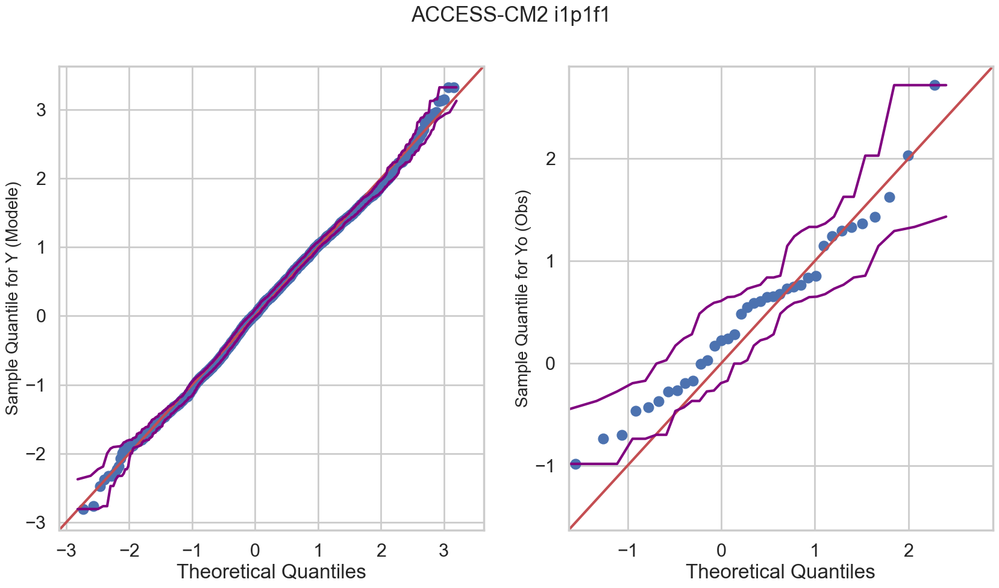

ACCESS-ESM1-5_i1p1f1


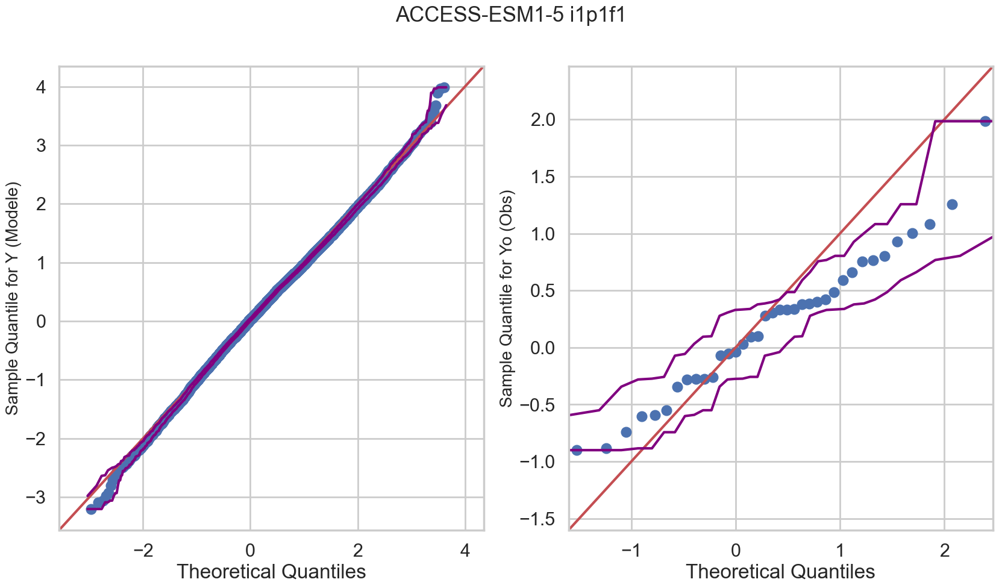

CMCC-ESM2_i1p1f1


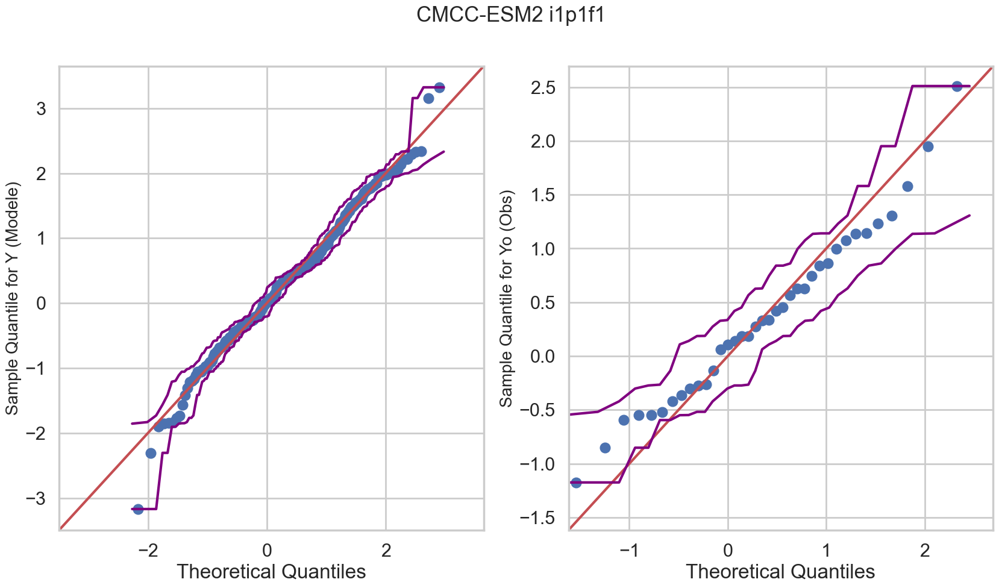

CNRM-CM6-1-HR_i1p1f2


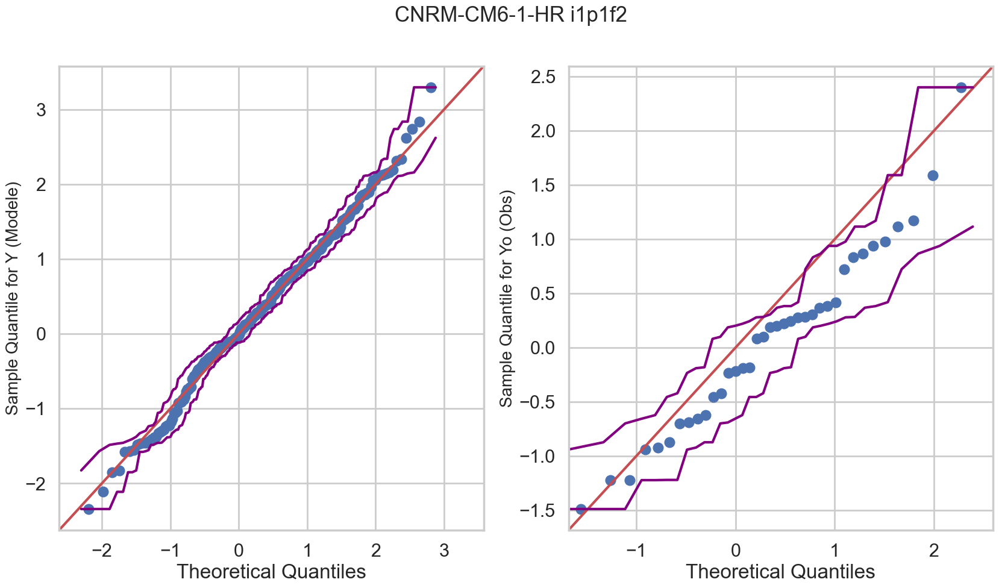

CNRM-CM6-1_i1p1f2


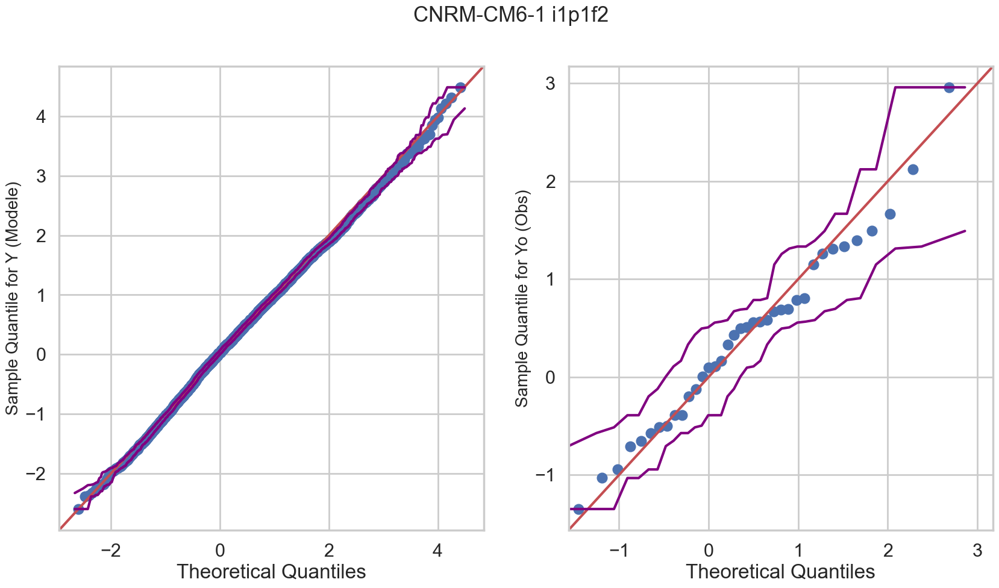

CNRM-ESM2-1_i1p1f2


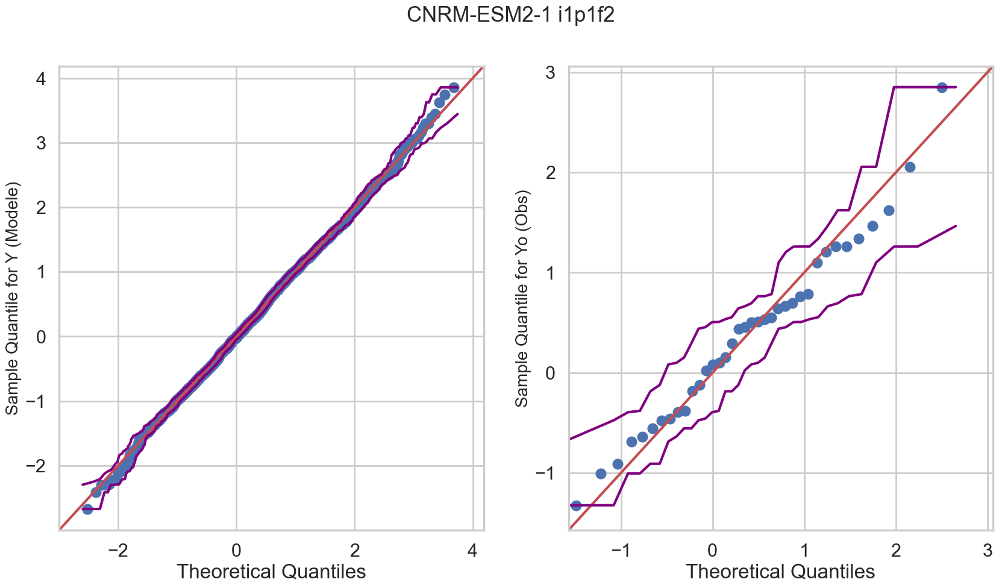

CanESM5_i1p2f1


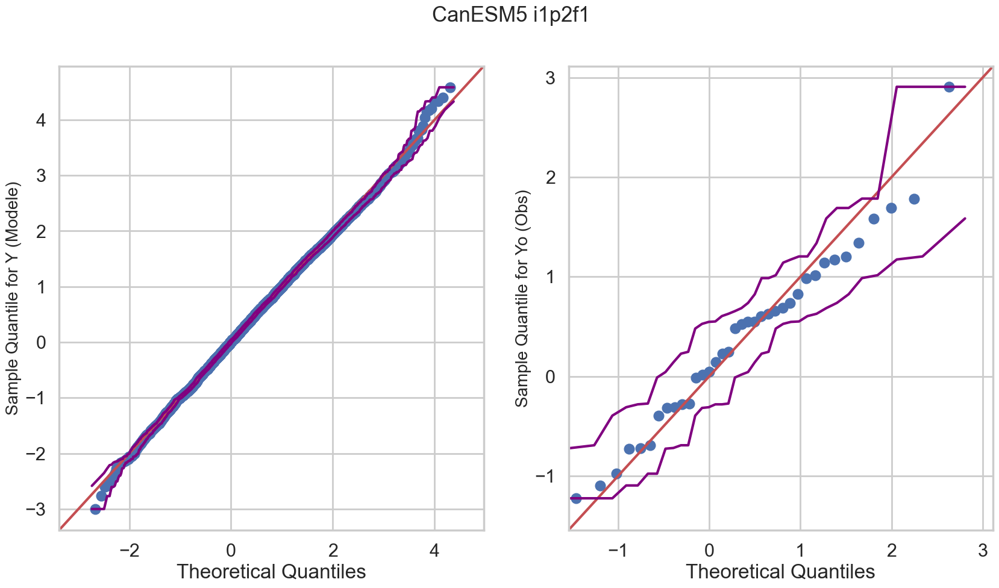

EC-Earth3-CC_i1p1f1


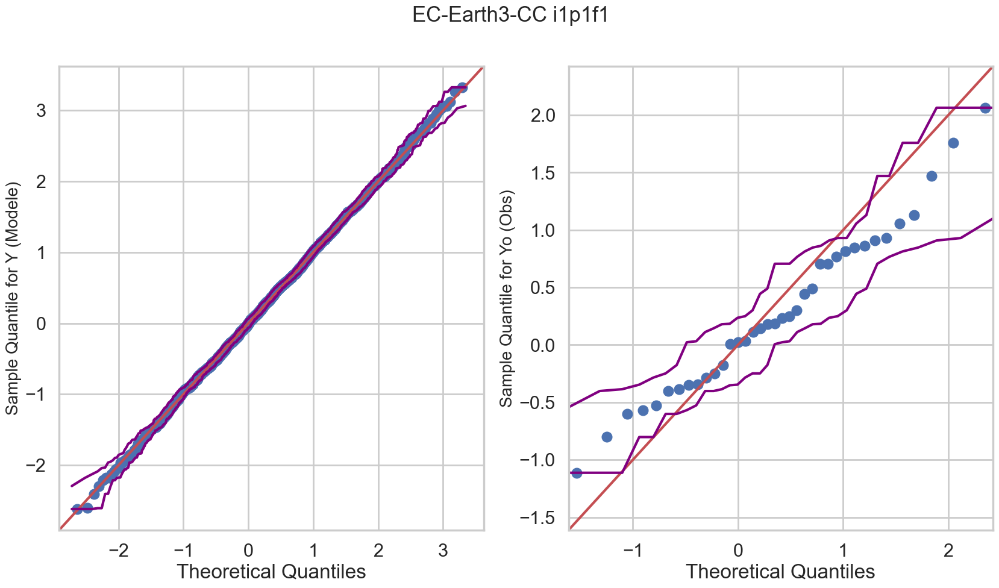

EC-Earth3-Veg-LR_i1p1f1


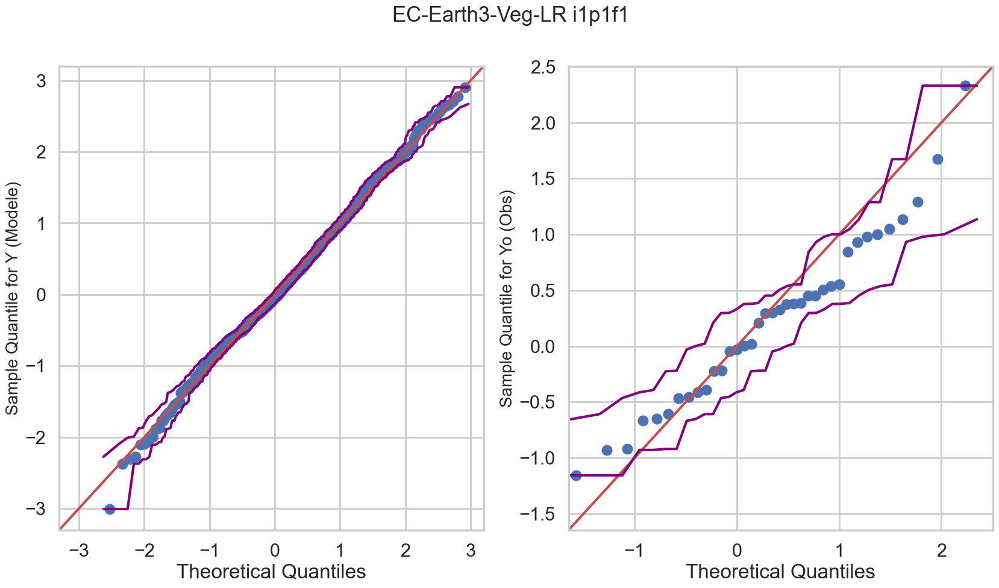

EC-Earth3-Veg_i1p1f1


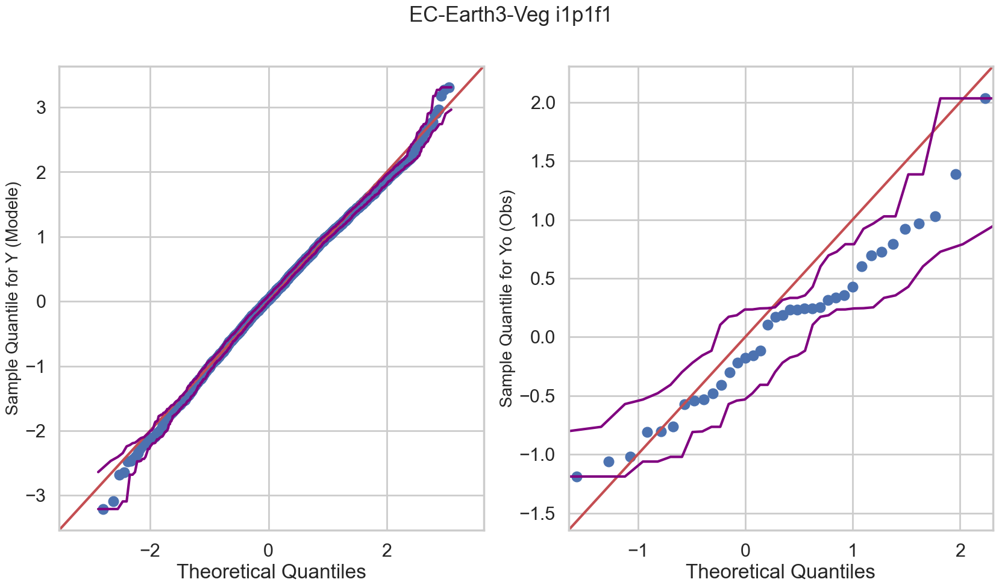

EC-Earth3_i1p1f1


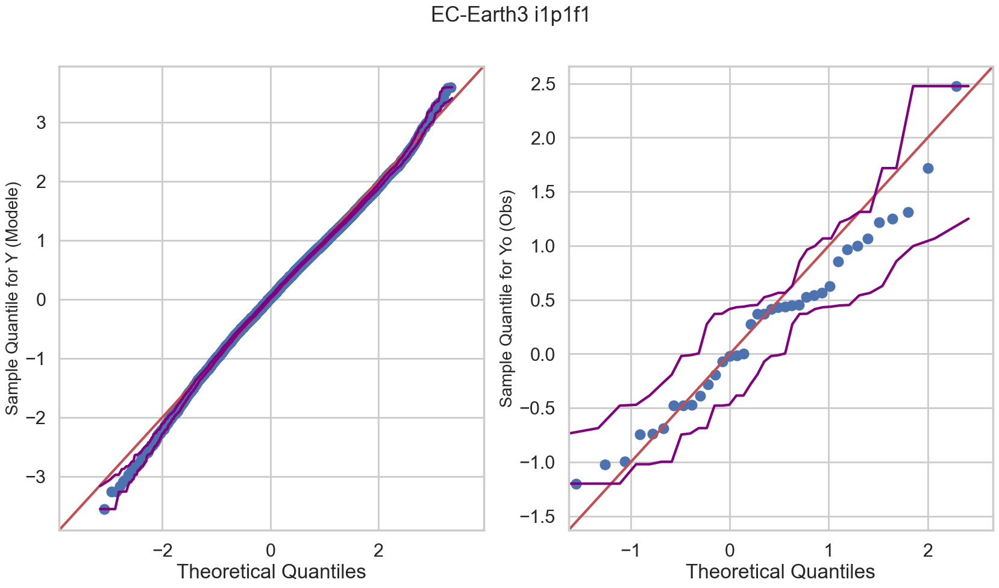

FGOALS-g3_i1p1f1


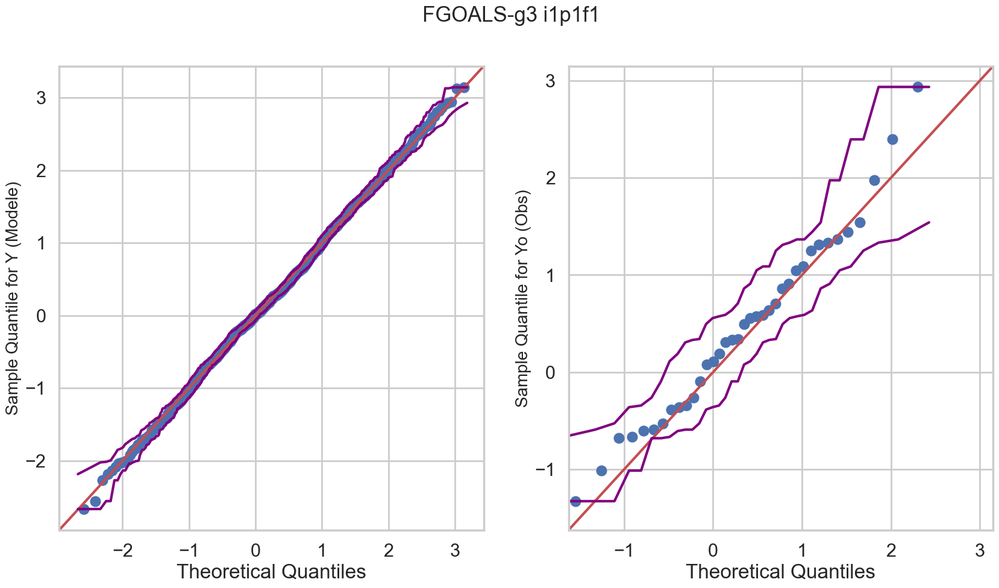

GFDL-ESM4_i1p1f1


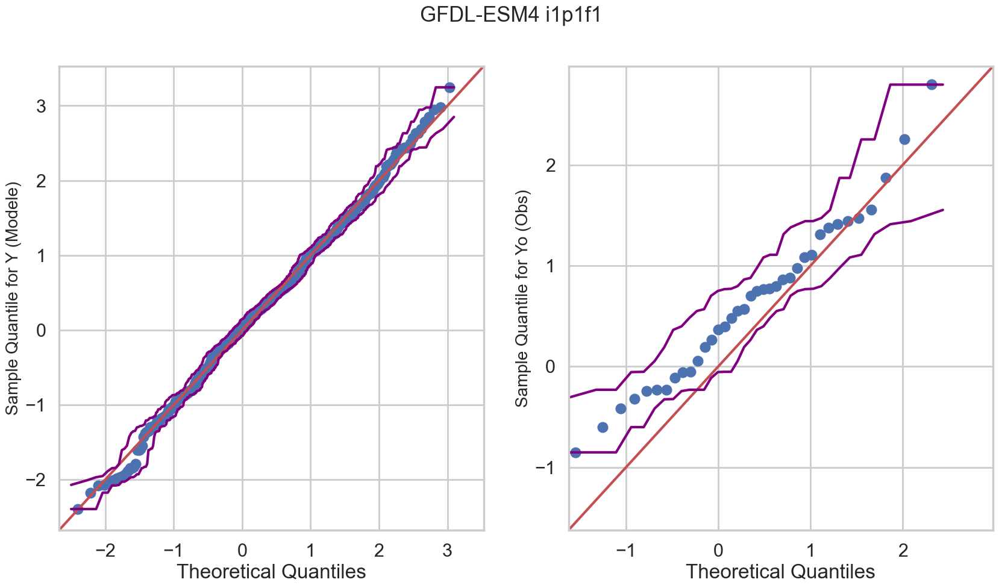

HadGEM3-GC31-LL_i1p1f3


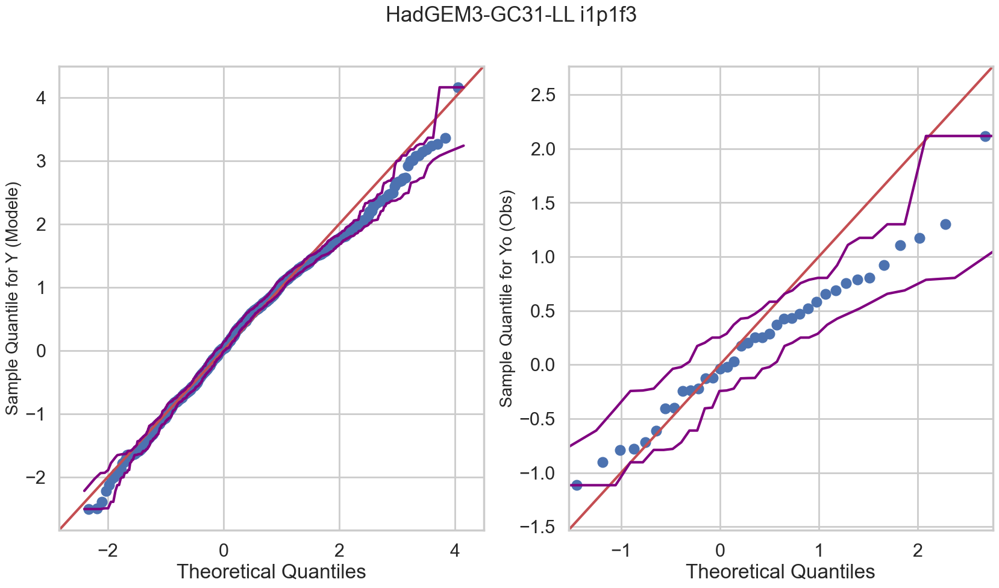

HadGEM3-GC31-MM_i1p1f3


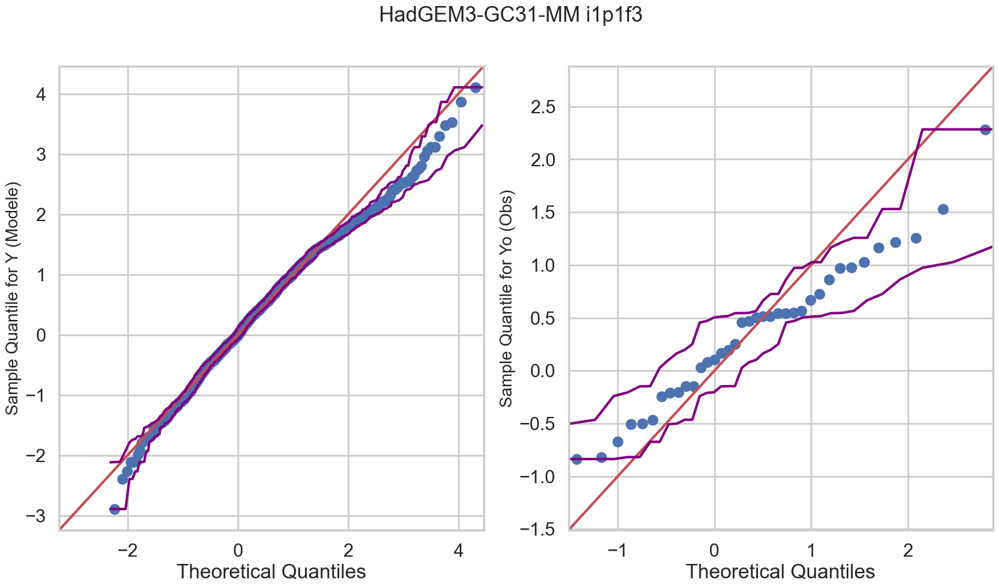

INM-CM4-8_i1p1f1


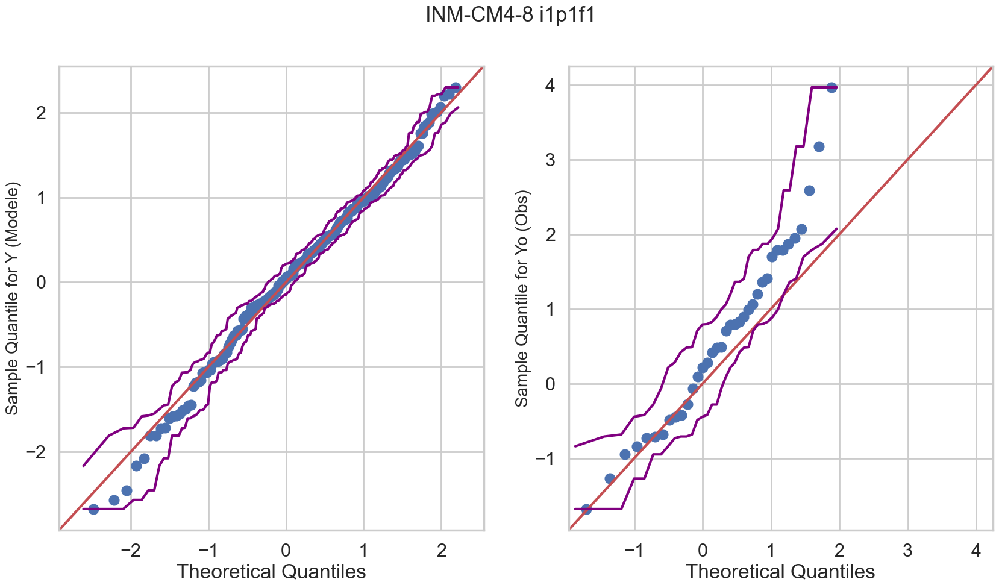

INM-CM5-0_i1p1f1


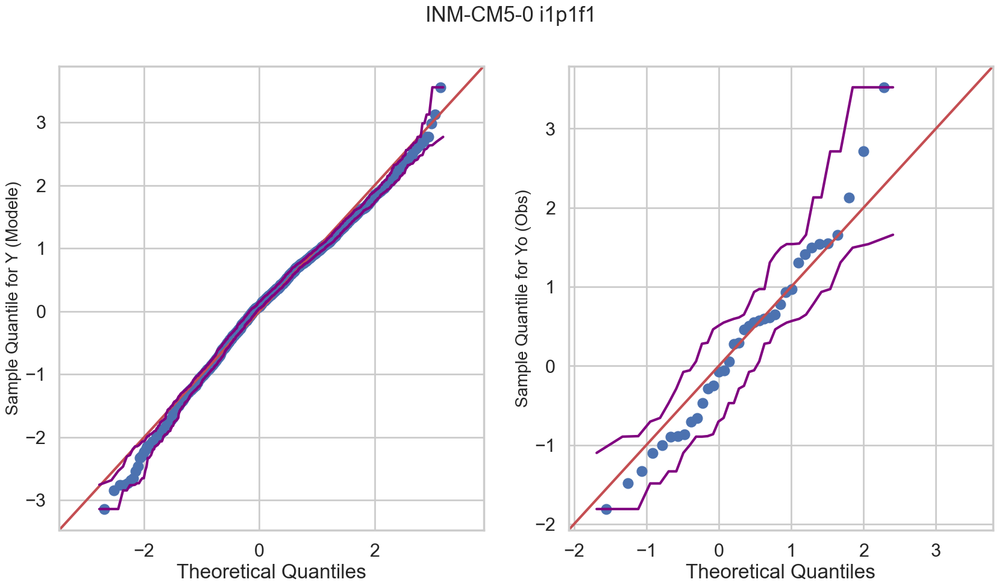

IPSL-CM6A-LR_i1p1f1


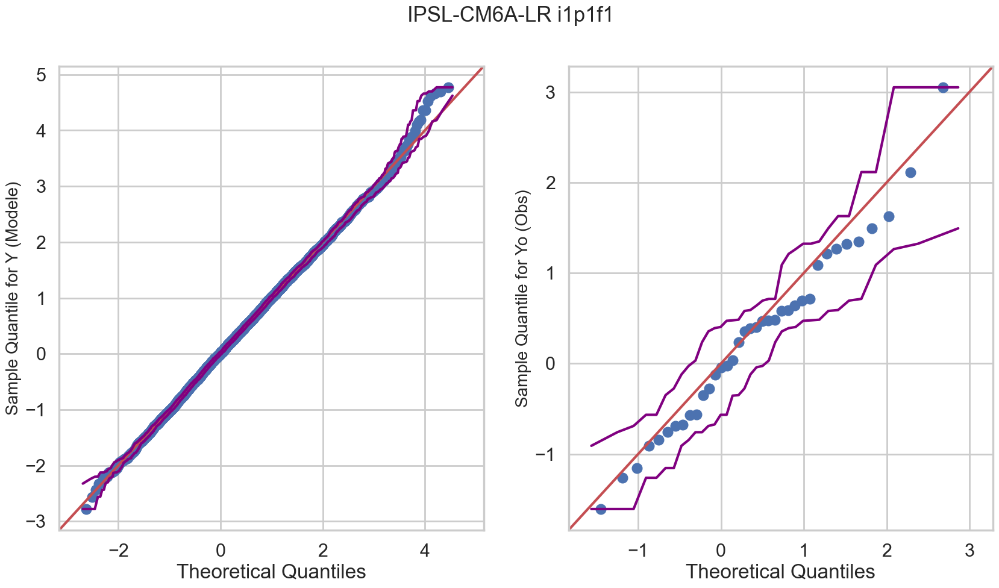

KACE-1-0-G_i1p1f1


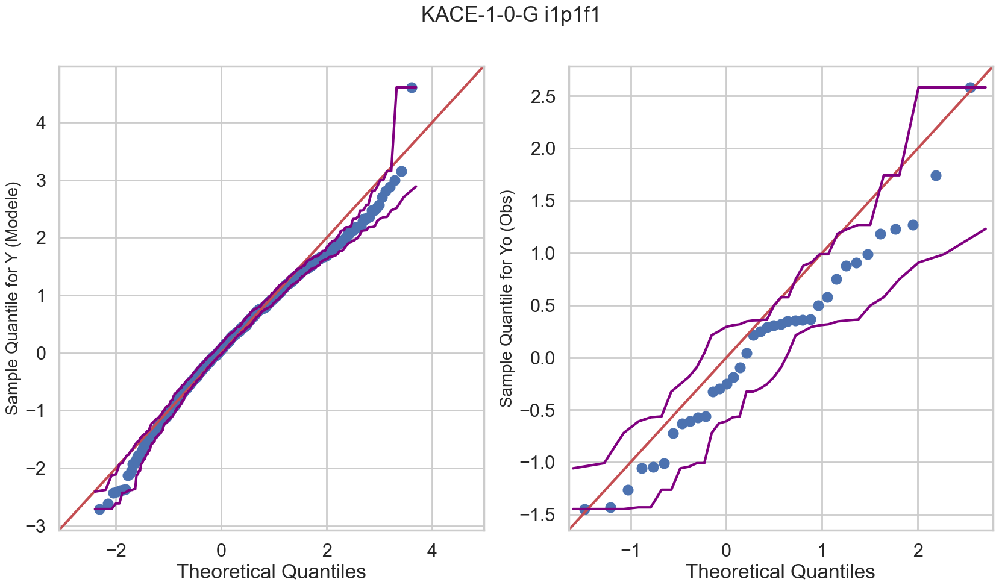

MIROC-ES2L_i1p1f2


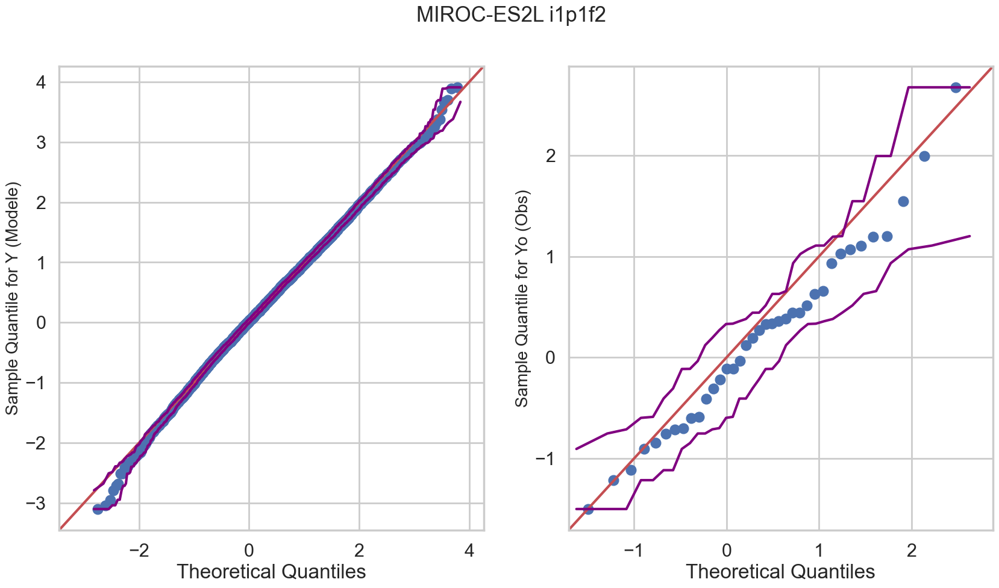

MIROC6_i1p1f1


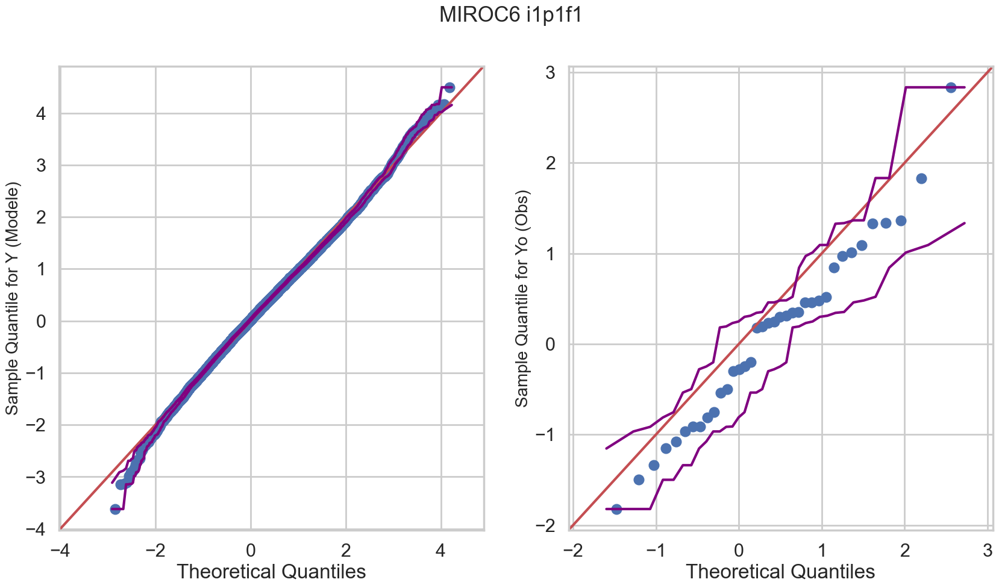

MPI-ESM1-2-LR_i1p1f1


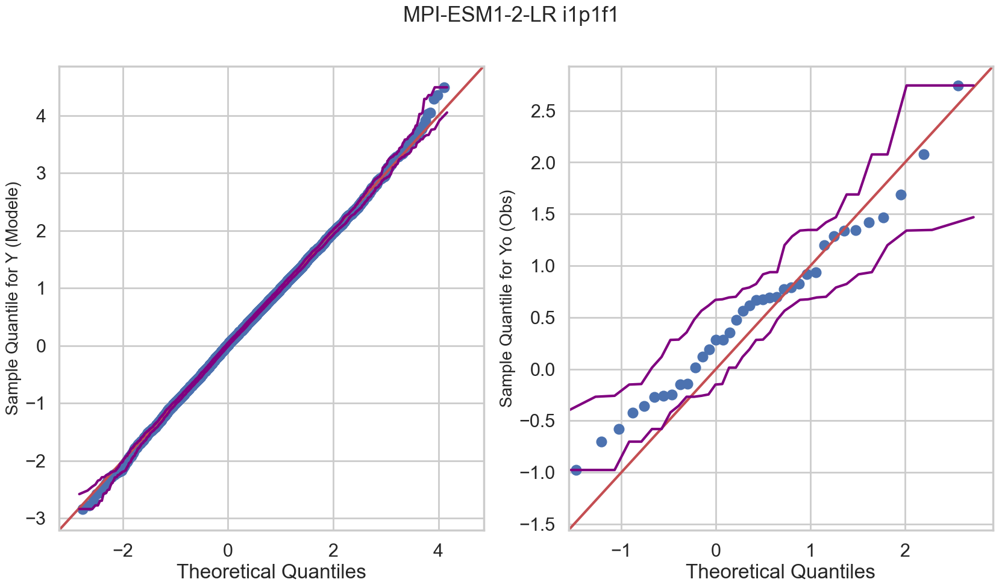

MRI-ESM2-0_i1p1f1


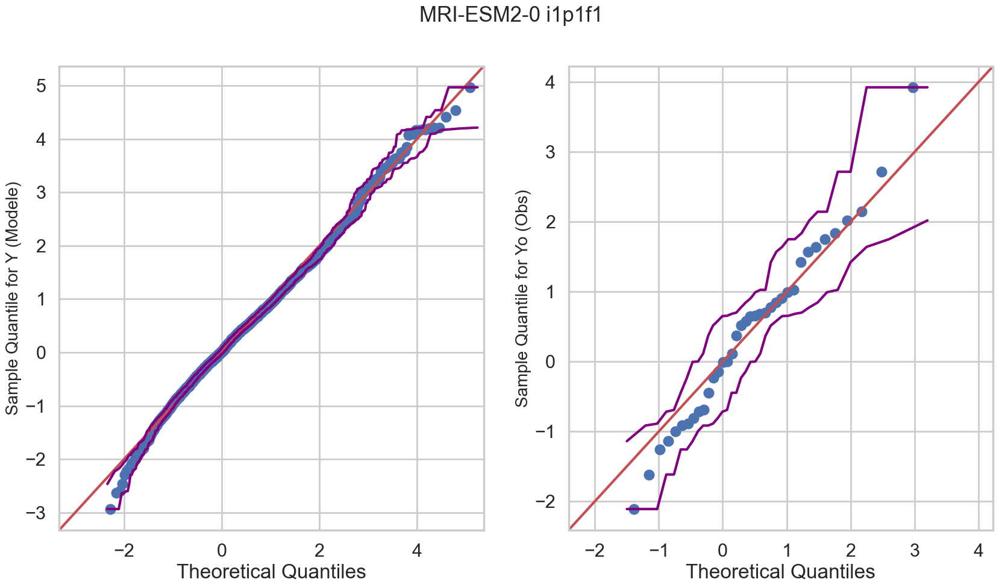

MRI-ESM2-0_i2p1f1


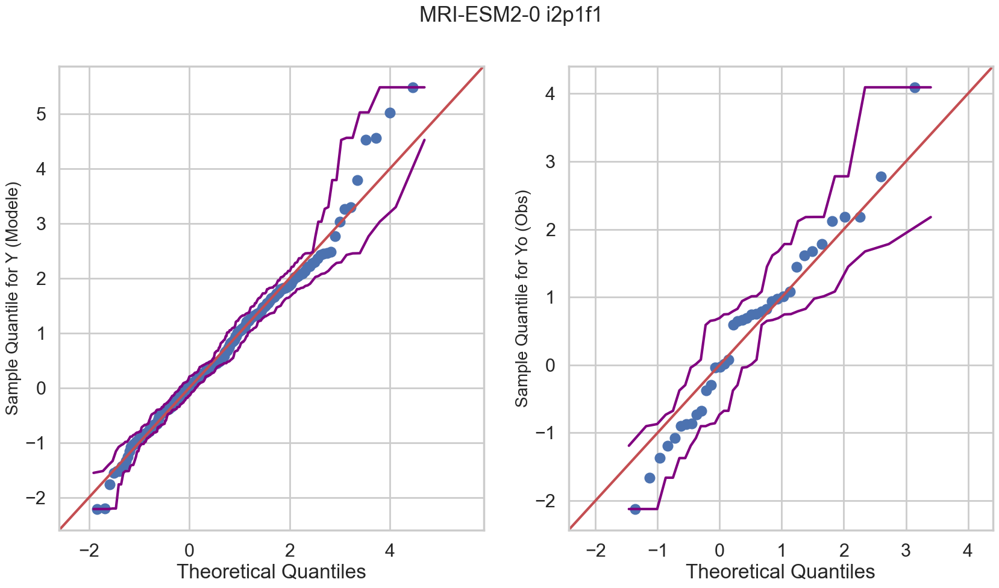

NESM3_i1p1f1


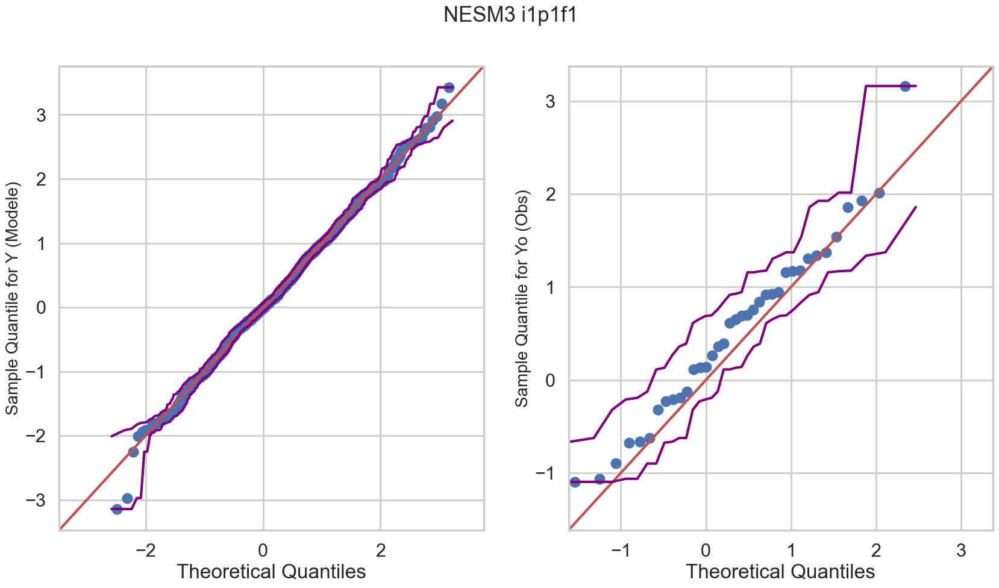

NorESM2-MM_i1p1f1


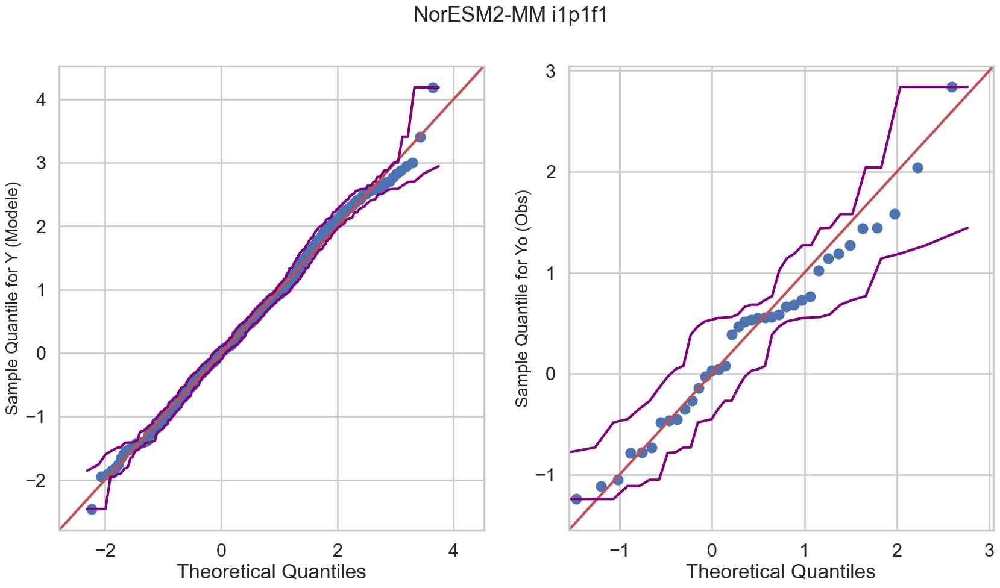

TaiESM1_i1p1f1


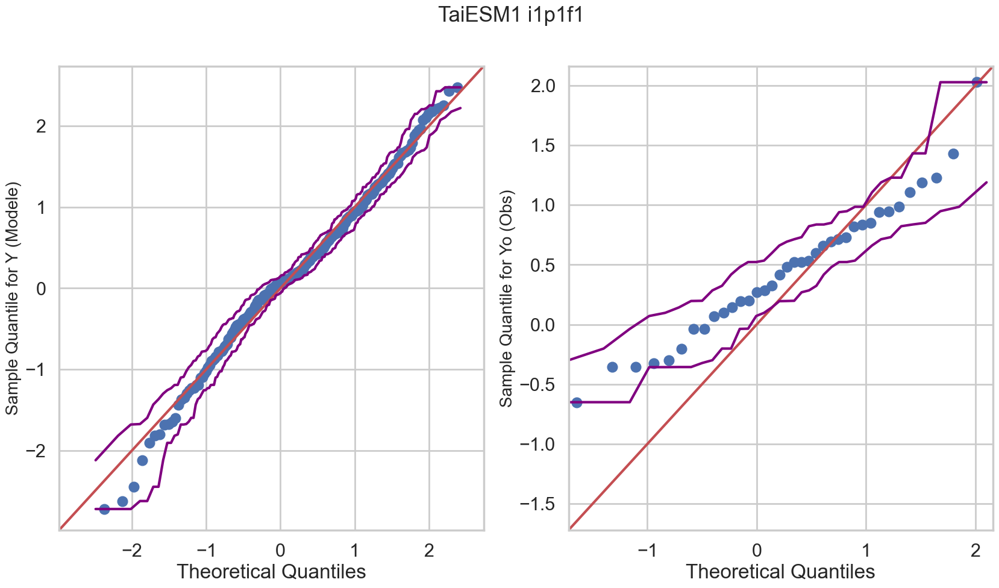

UKESM1-0-LL_i1p1f2


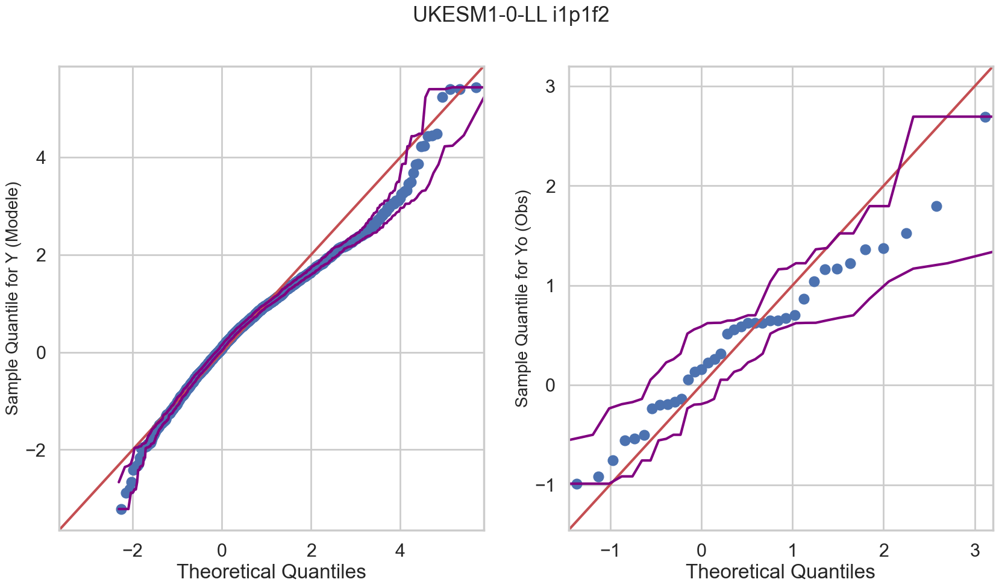

In [11]:
#Ajout IC boostrap
from scipy.stats._morestats import _calc_uniform_order_statistic_medians

ofile=os.path.join( pathOut , type_data+"_QQplot_GEV_GCM_Modeles_ICBoostrap.pdf" )
pdf = mpdf.PdfPages( ofile )

qparams  = params[:,1:,:,:,:].quantile( [ ci / 2 , 1 - ci / 2 , 0.5 ] , dim = "sample" ).assign_coords( quantile = ["ql","qu","BE"] )
for j in range(0,len(models)):
    m=models[j]
    
    Y=lY[j]
    fig = plt.figure( figsize = (20,10) )
    ax = fig.add_subplot( 1 , 2 ,  1 )

    tY    = Y.index
    X     = clim.X.loc[tY,"BE","F",m]
    X=X.to_pandas()
    residuals=[]
    for i in range(0,len(Y)):
        shape=qparams.loc["BE",Y.index[i],"F",'shape',m].values
        loc=qparams.loc["BE",Y.index[i],"F",'loc',m].values
        scale=qparams.loc["BE",Y.index[i],"F",'scale',m].values
        
        #residuals.append((1/shape)*np.log(1+shape*(Y.iloc[i].values[0]-loc)/scale))

    
        residuals.append((Y.iloc[i].values[0]-loc)/scale)
    print(m)
    sm.qqplot(np.asarray(residuals),dist=sc.genextreme,distargs=(-shape,), line="45",ax=ax)
    ax.set_ylabel("Sample Quantile for Y (Modele)", fontsize = 20 )
    
    #Ajout IC 

    tirages=10000
    dist=sc.genextreme
    sparams=(-shape,)
    osm_uniform = _calc_uniform_order_statistic_medians(len(residuals))
    osm = dist.ppf(osm_uniform, *sparams)
    OSR=np.zeros(shape=(tirages, len(residuals)))
    for s in range(0,tirages):
        idx = np.random.choice( len(residuals), len(residuals) , replace = True )

        x_s= np.asarray(residuals)[idx]
        OSR[s] = np.sort(x_s)
    
    
    qu=np.quantile(OSR,1-ci / 2,axis=0)
    ql=np.quantile(OSR,ci / 2,axis=0)
    ax.plot(osm, qu,color="purple")
    ax.plot(osm, ql,color="purple")
    
    
    #Y=lY[j]
    ax = fig.add_subplot( 1 , 2 , 2 )

    tY    = Yo.index
    X     = Xo.loc[tY]
    #X=X.to_pandas()
    residuals=[]
    for i in range(0,len(Yo)):
        shape=qparams.loc["BE",Yo.index[i],"F",'shape',m].values
        loc=qparams.loc["BE",Yo.index[i],"F",'loc',m].values
        scale=qparams.loc["BE",Yo.index[i],"F",'scale',m].values
        
        #residuals.append((1/shape)*np.log(1+shape*(Yo.iloc[i].values[0]-loc)/scale))
        residuals.append((Yo.iloc[i].values[0]-loc)/scale)
    sm.qqplot(np.asarray(residuals),dist=sc.genextreme,distargs=(-shape,), line="45",ax=ax)
    ax.set_ylabel("Sample Quantile for Yo (Obs)", fontsize = 20 )
    
    
        #Ajout IC 

    tirages=10000
    dist=sc.genextreme
    sparams=(-shape,)
    osm_uniform = _calc_uniform_order_statistic_medians(len(residuals))
    osm = dist.ppf(osm_uniform, *sparams)
    OSR=np.zeros(shape=(tirages, len(residuals)))
    for s in range(0,tirages):
        idx = np.random.choice( len(residuals), len(residuals) , replace = True )

        x_s= np.asarray(residuals)[idx]
        OSR[s] = np.sort(x_s)
    
    
    qu=np.quantile(OSR,1-ci / 2,axis=0)
    ql=np.quantile(OSR,ci / 2,axis=0)
    ax.plot(osm, qu,color="purple")
    ax.plot(osm, ql,color="purple")
    
    fig.suptitle( " ".join(m.split("_")) , fontsize = 25 )
    plt.show()
    pdf.savefig(fig)
    plt.close(fig)
pdf.close()



In [12]:
import pingouin as pg

ACCESS-CM2_i1p1f1


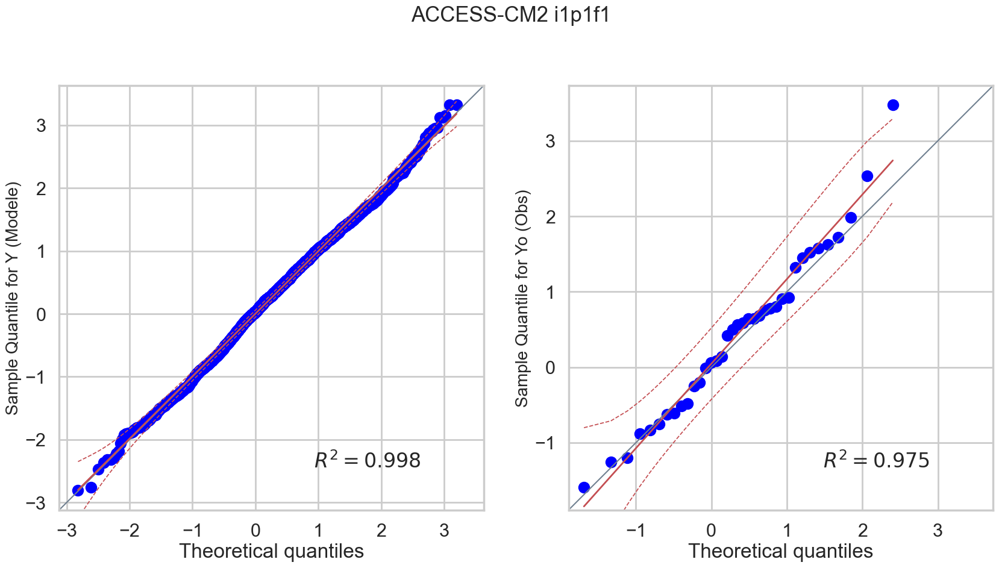

ACCESS-ESM1-5_i1p1f1


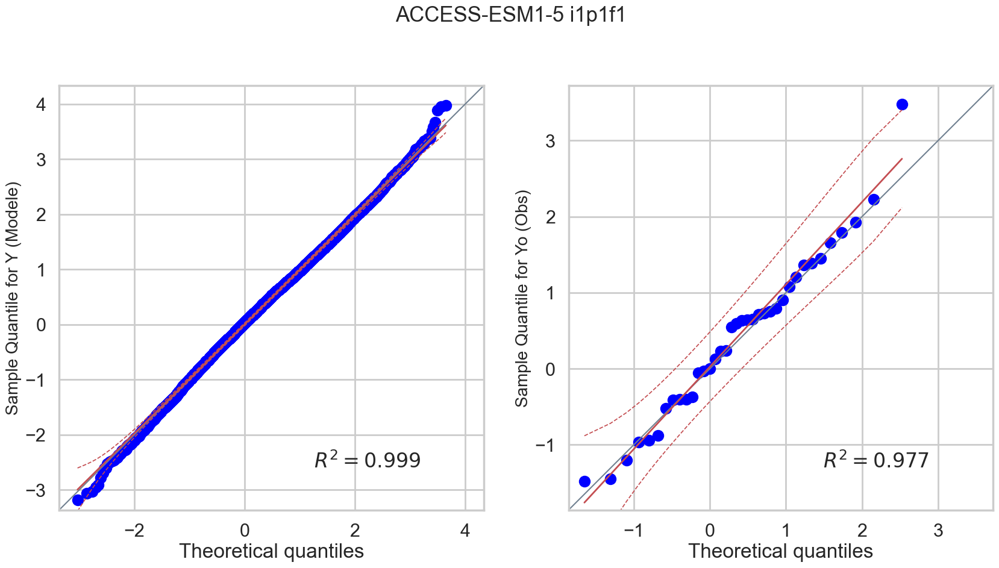

CMCC-ESM2_i1p1f1


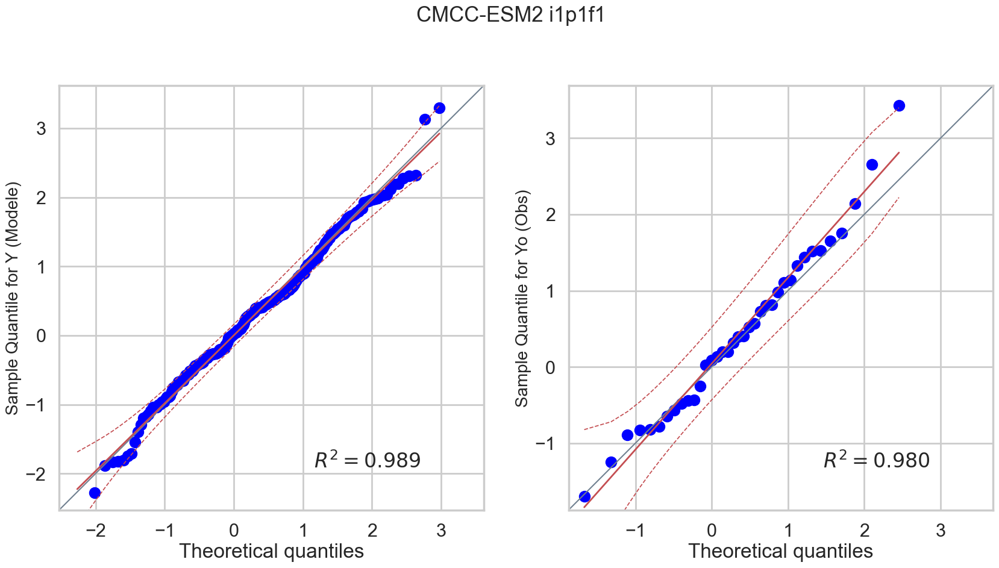

CNRM-CM6-1-HR_i1p1f2


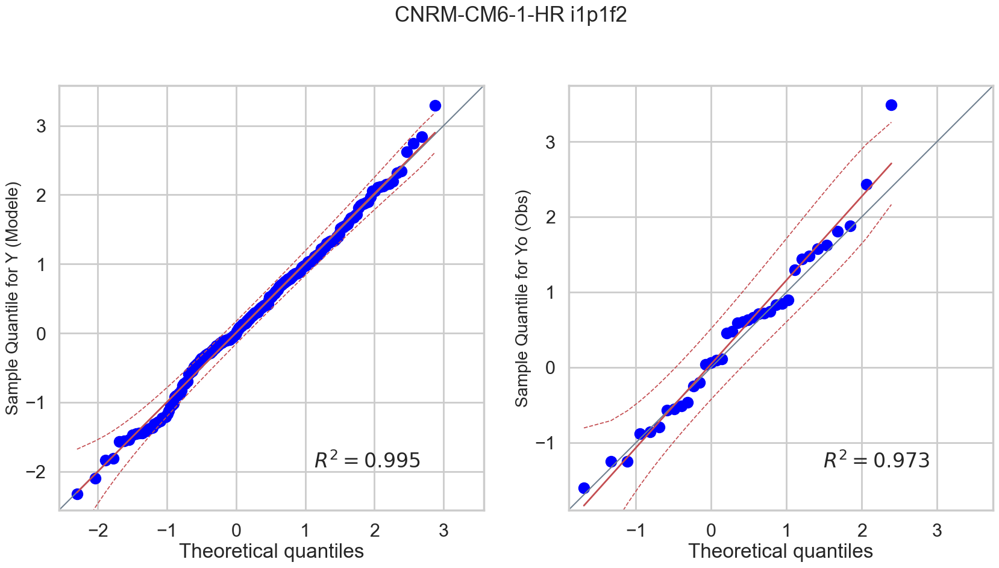

CNRM-CM6-1_i1p1f2


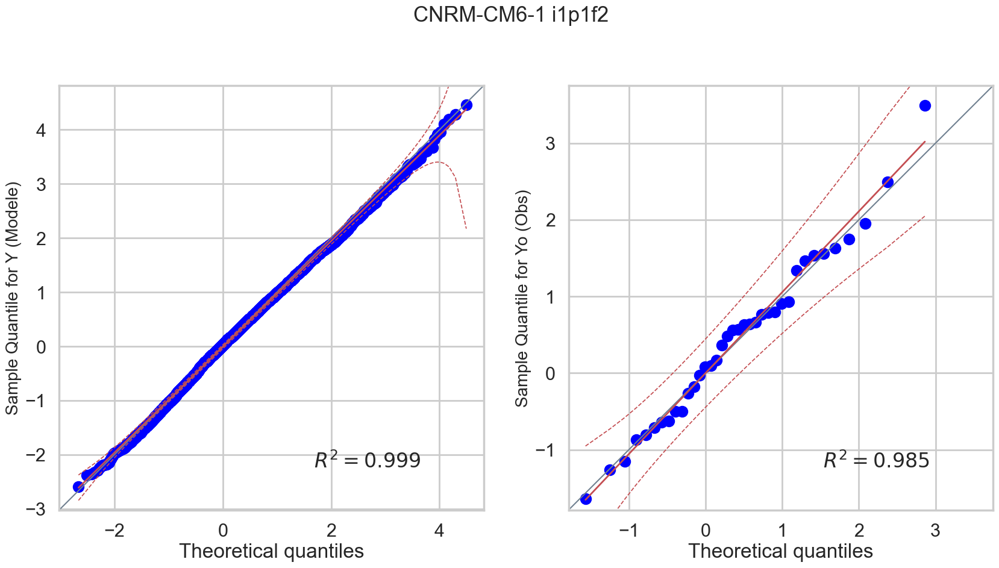

CNRM-ESM2-1_i1p1f2


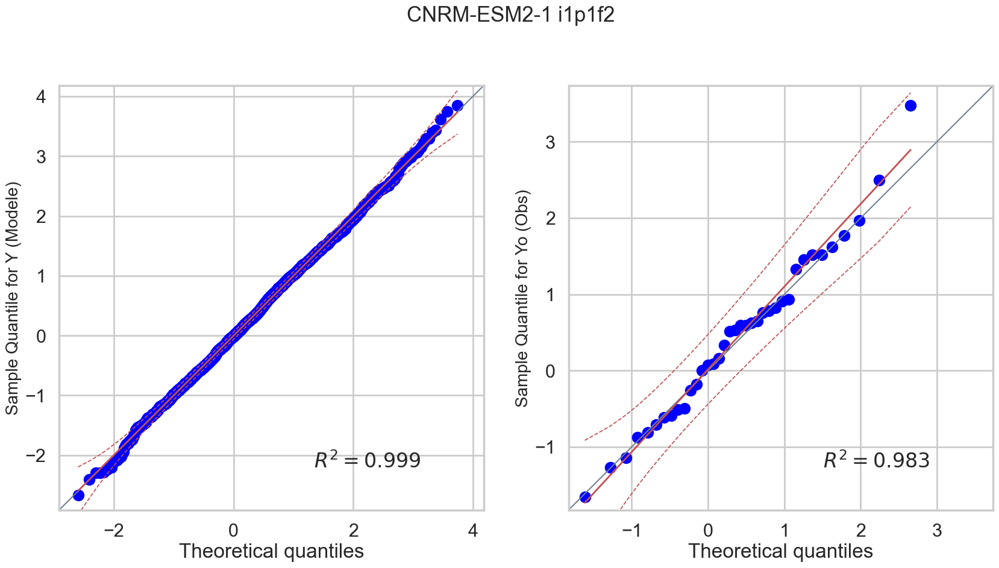

CanESM5_i1p2f1


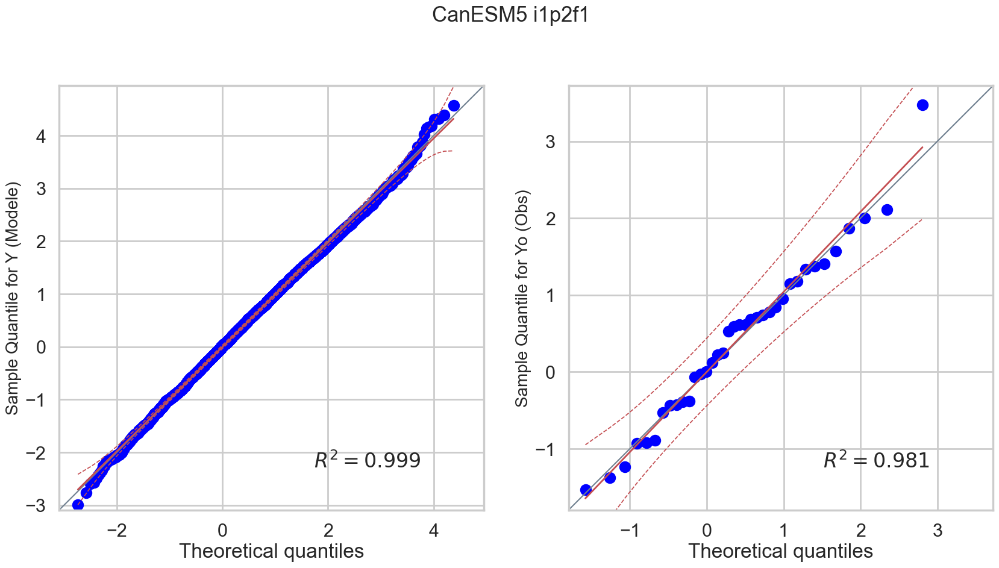

EC-Earth3-CC_i1p1f1


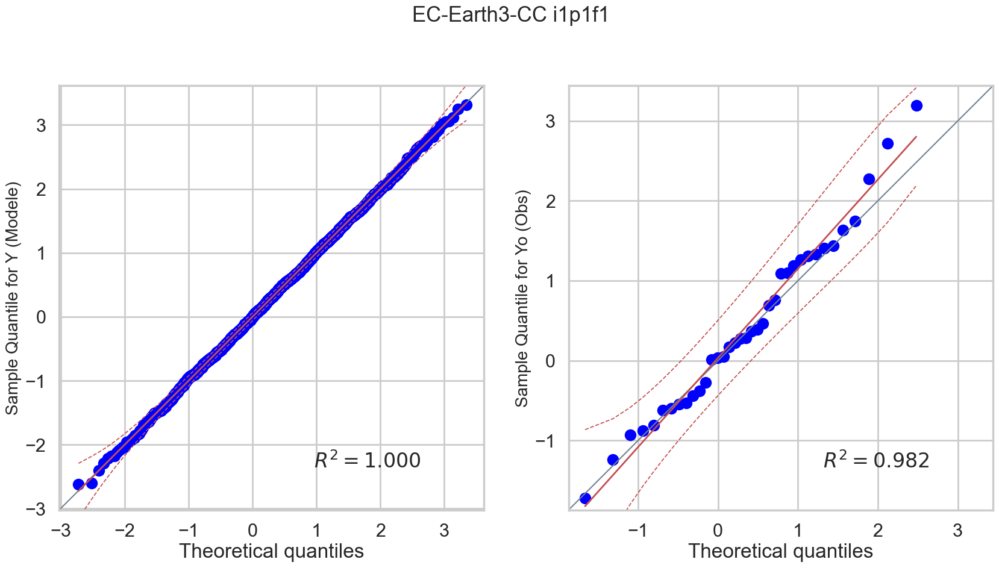

EC-Earth3-Veg-LR_i1p1f1


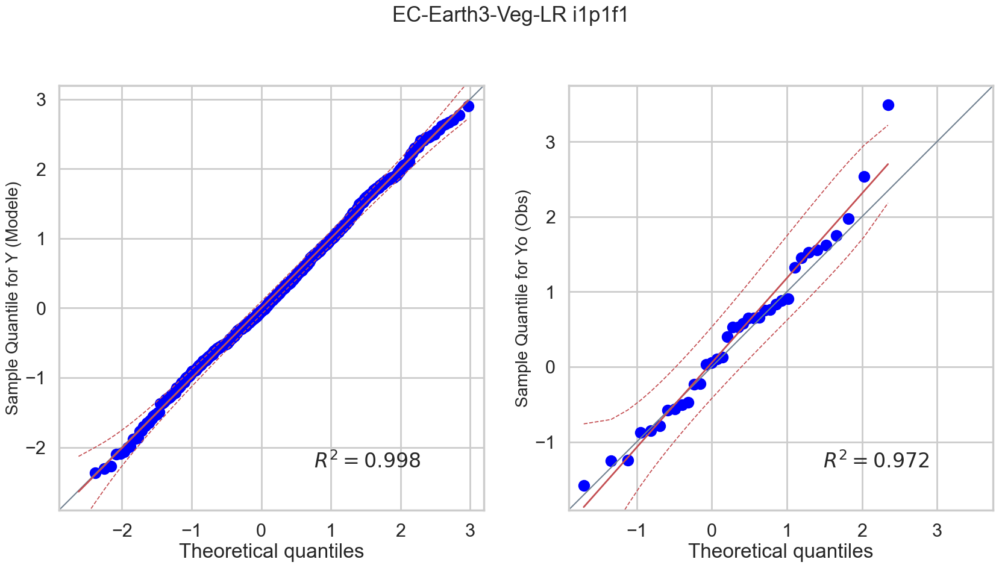

EC-Earth3-Veg_i1p1f1


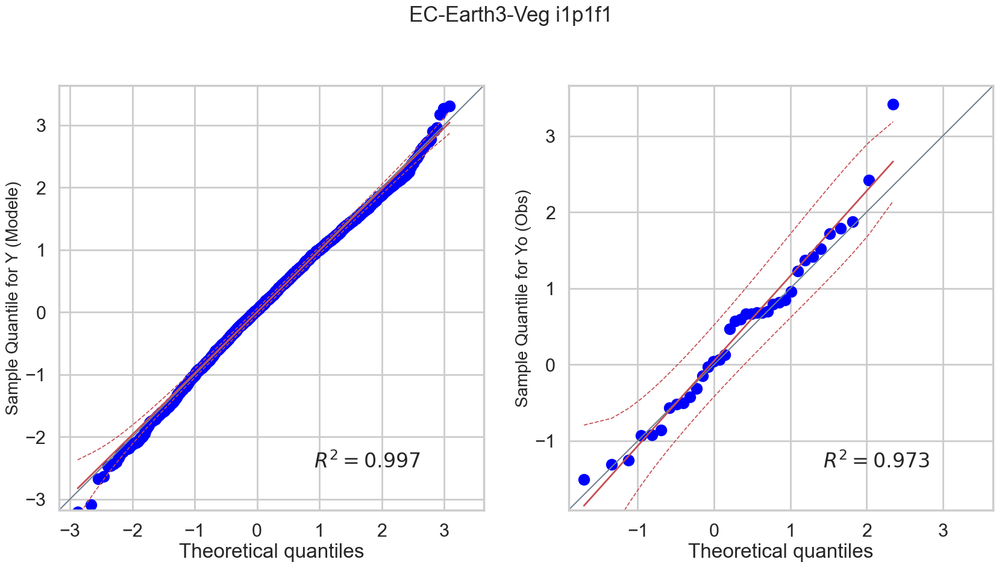

EC-Earth3_i1p1f1


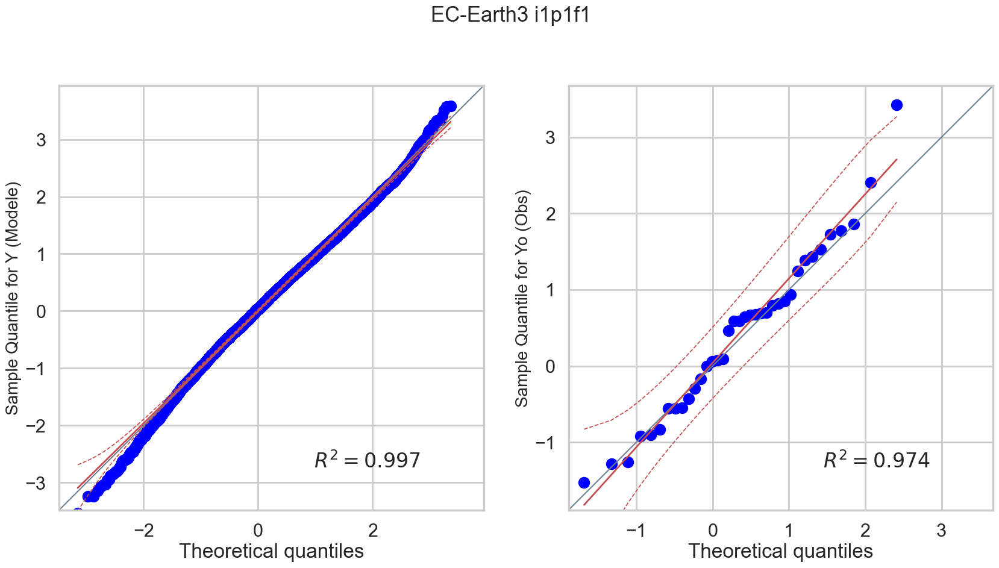

FGOALS-g3_i1p1f1


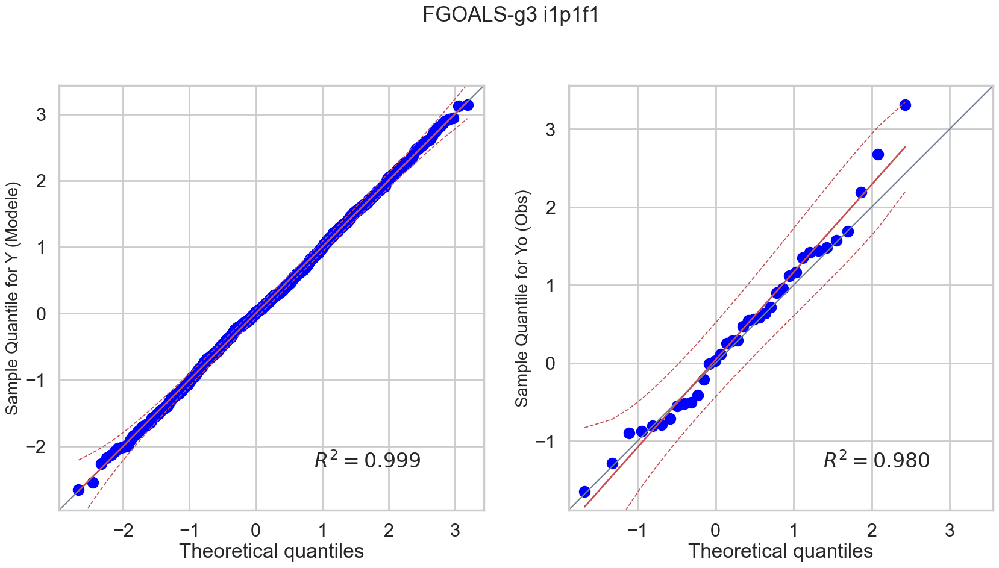

GFDL-ESM4_i1p1f1


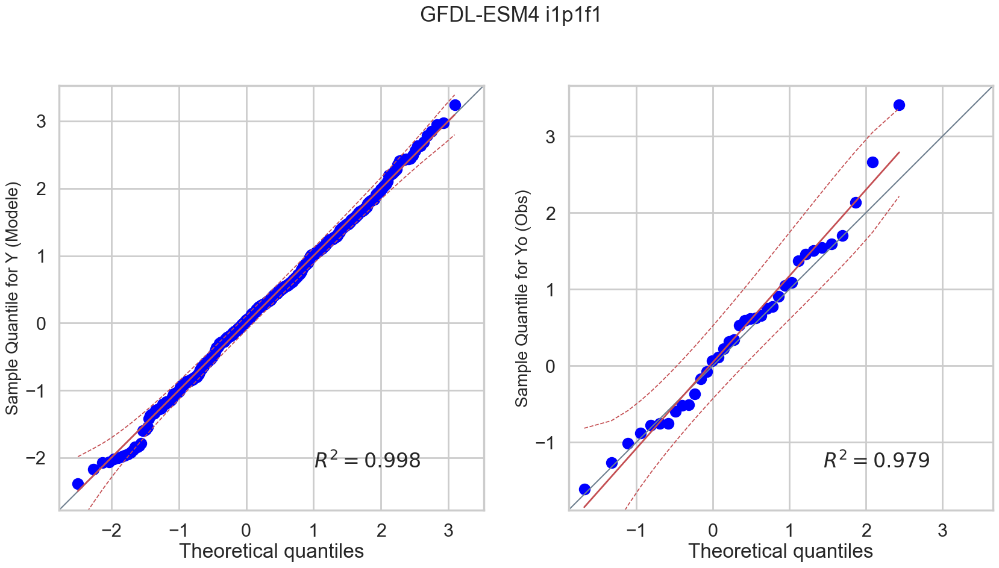

HadGEM3-GC31-LL_i1p1f3


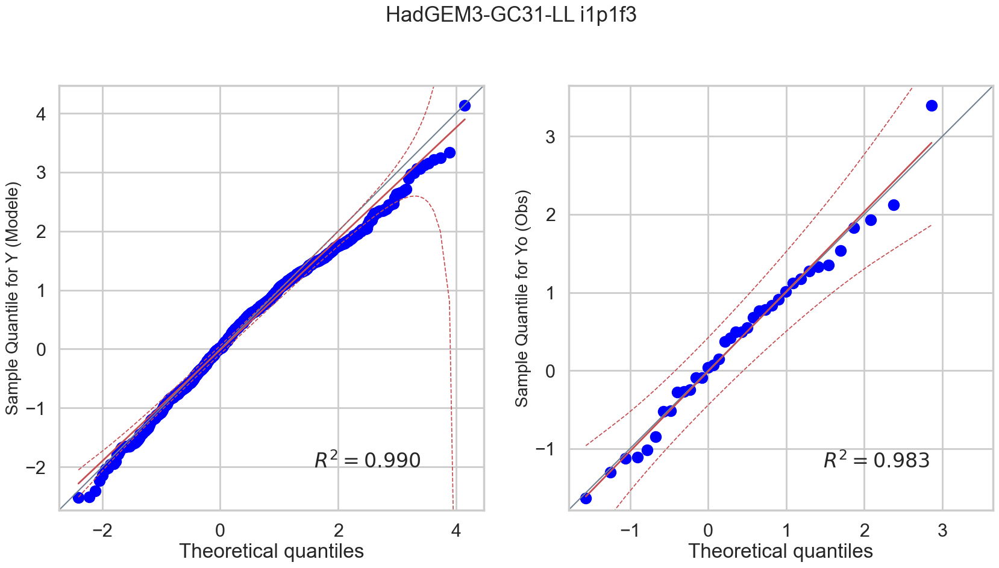

HadGEM3-GC31-MM_i1p1f3


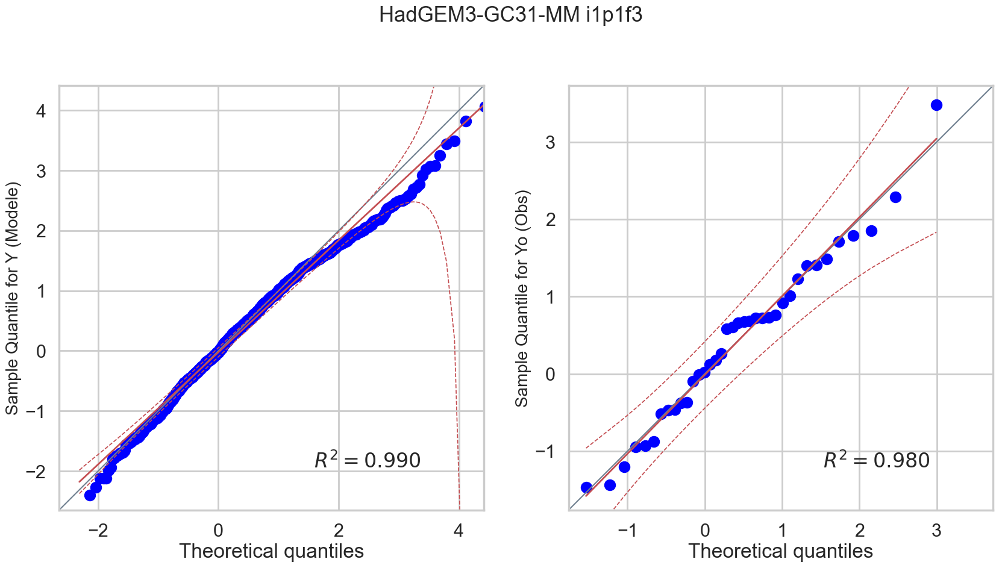

INM-CM4-8_i1p1f1


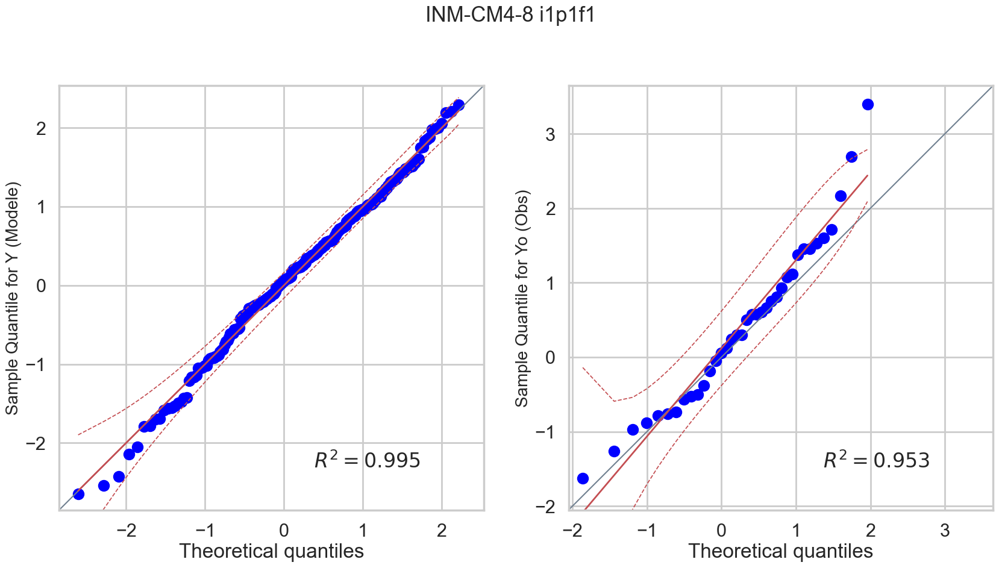

INM-CM5-0_i1p1f1


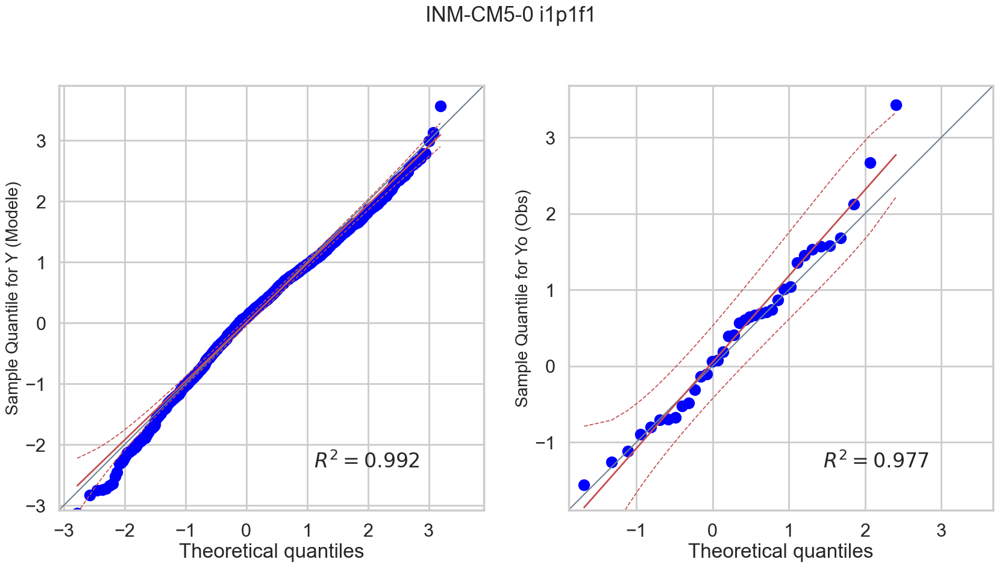

IPSL-CM6A-LR_i1p1f1


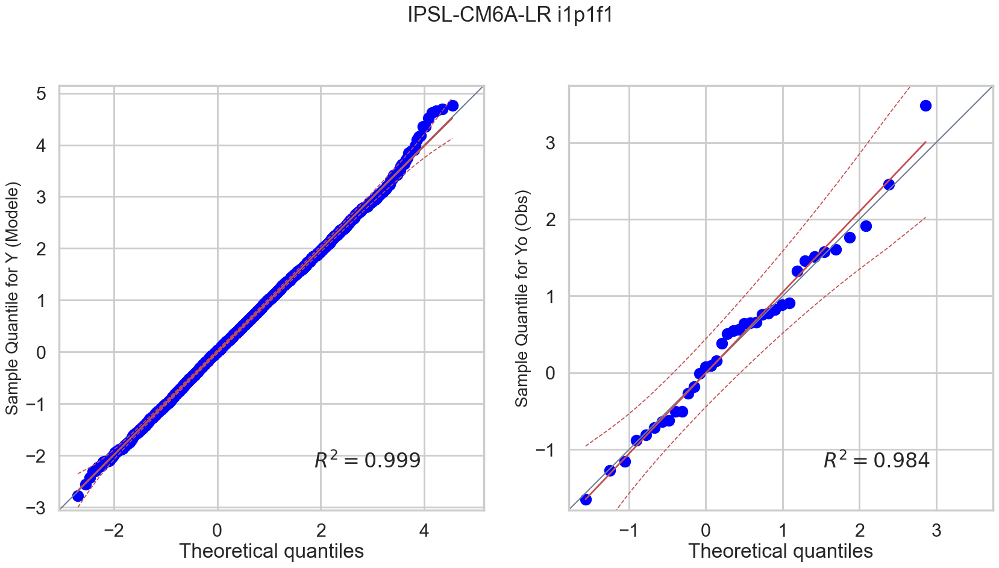

KACE-1-0-G_i1p1f1


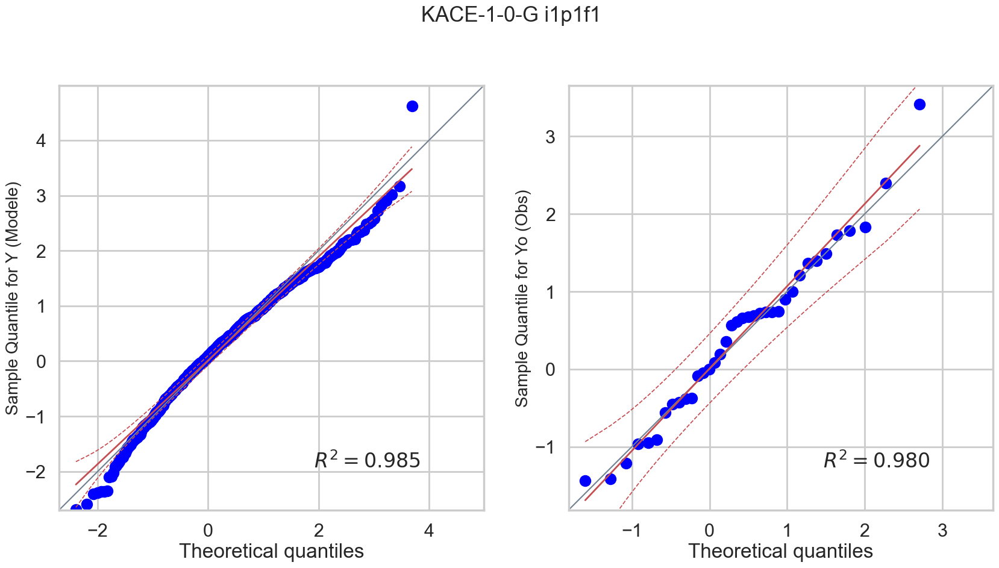

MIROC-ES2L_i1p1f2


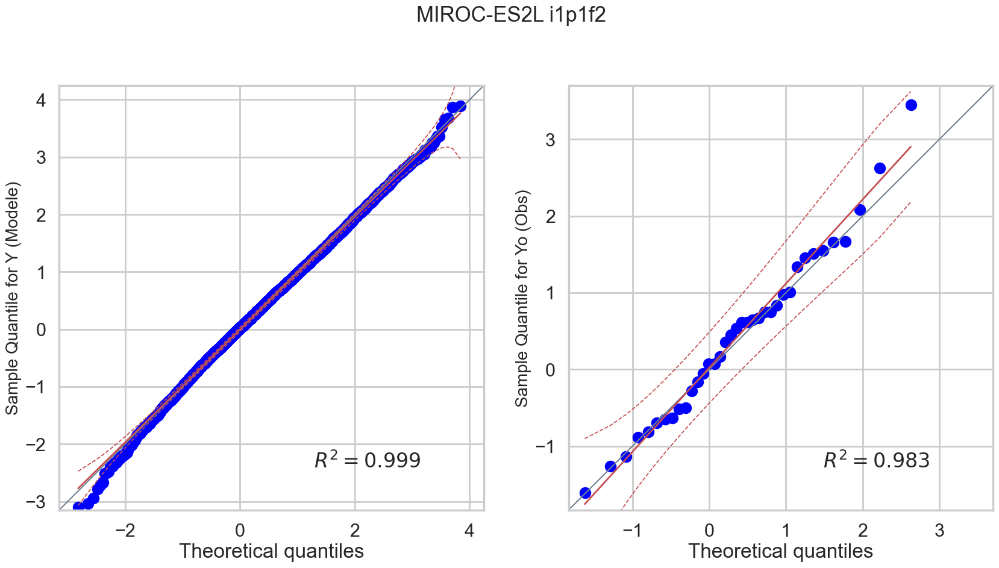

MIROC6_i1p1f1


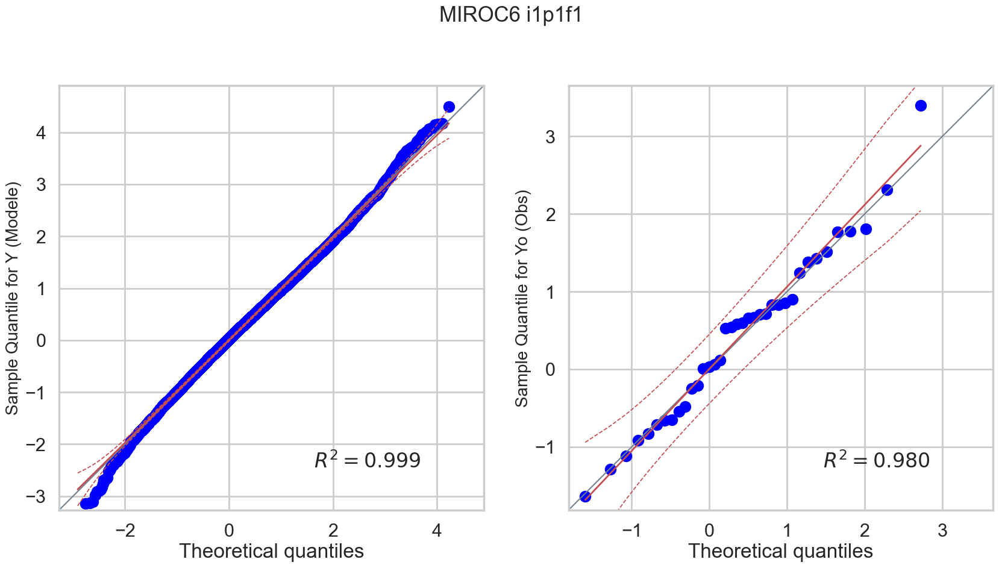

MPI-ESM1-2-LR_i1p1f1


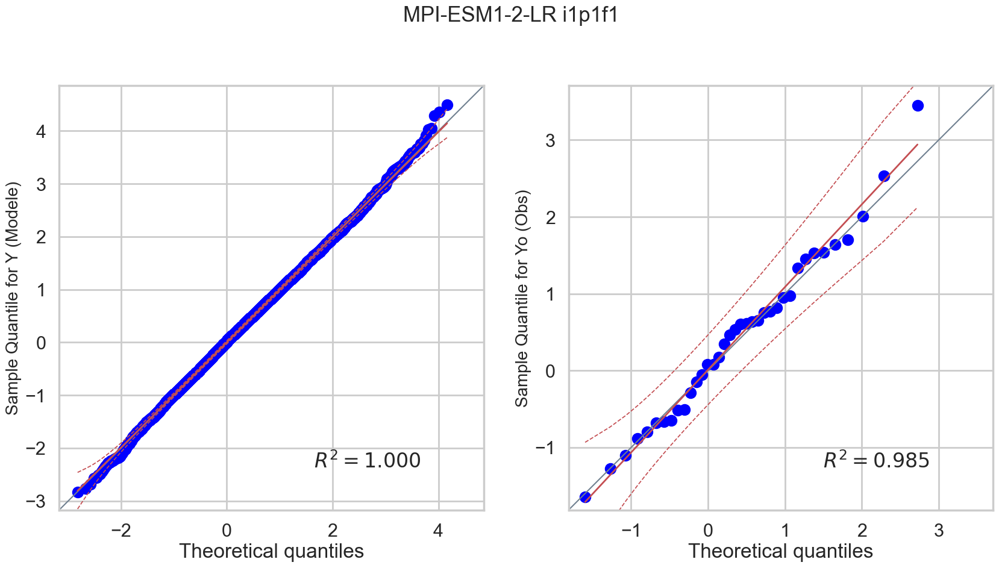

MRI-ESM2-0_i1p1f1


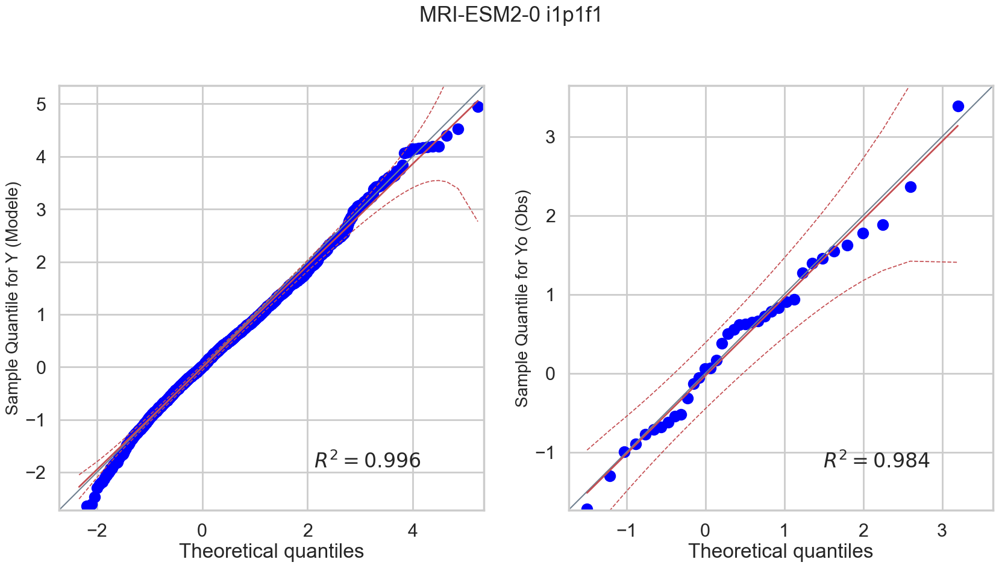

MRI-ESM2-0_i2p1f1


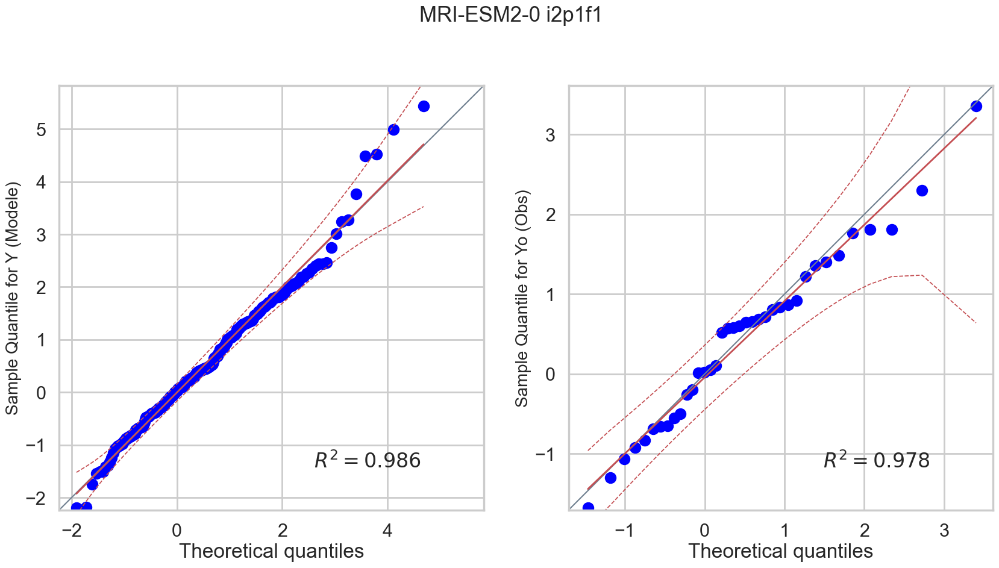

NESM3_i1p1f1


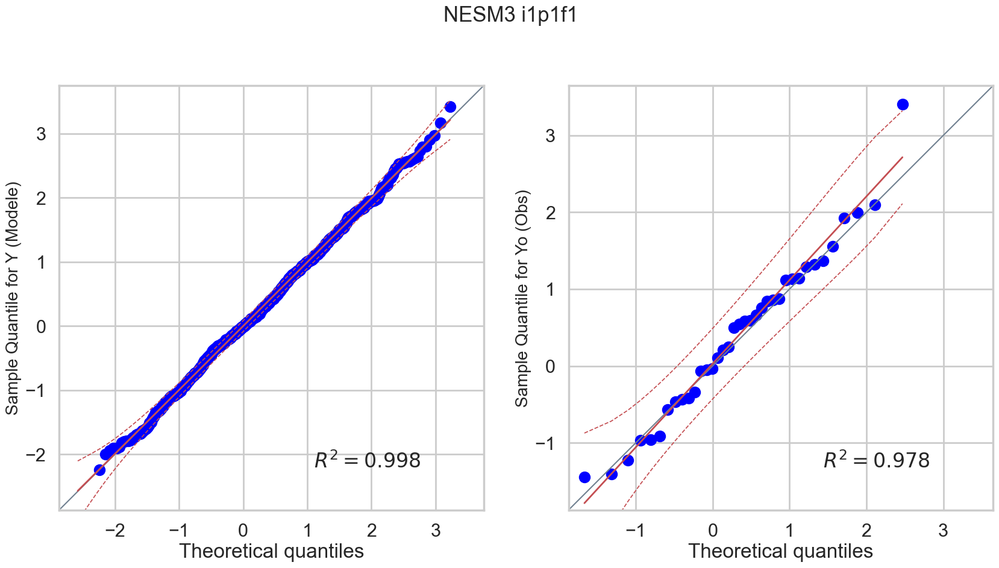

NorESM2-MM_i1p1f1


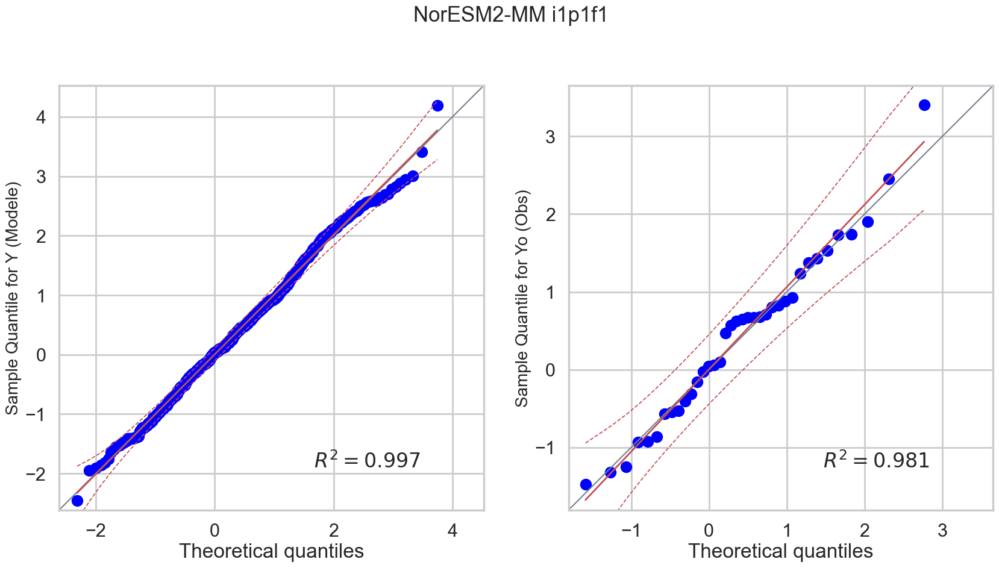

TaiESM1_i1p1f1


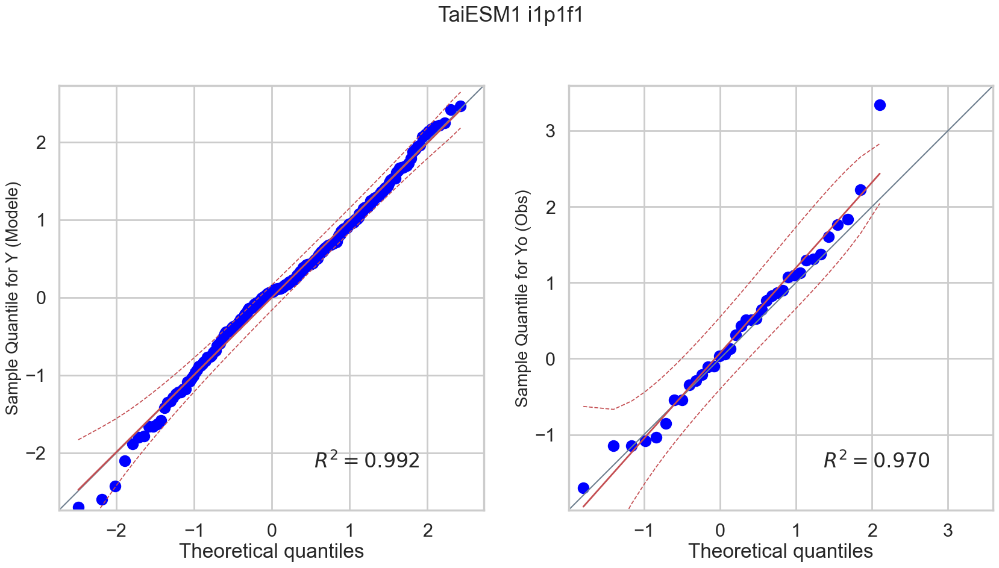

UKESM1-0-LL_i1p1f2


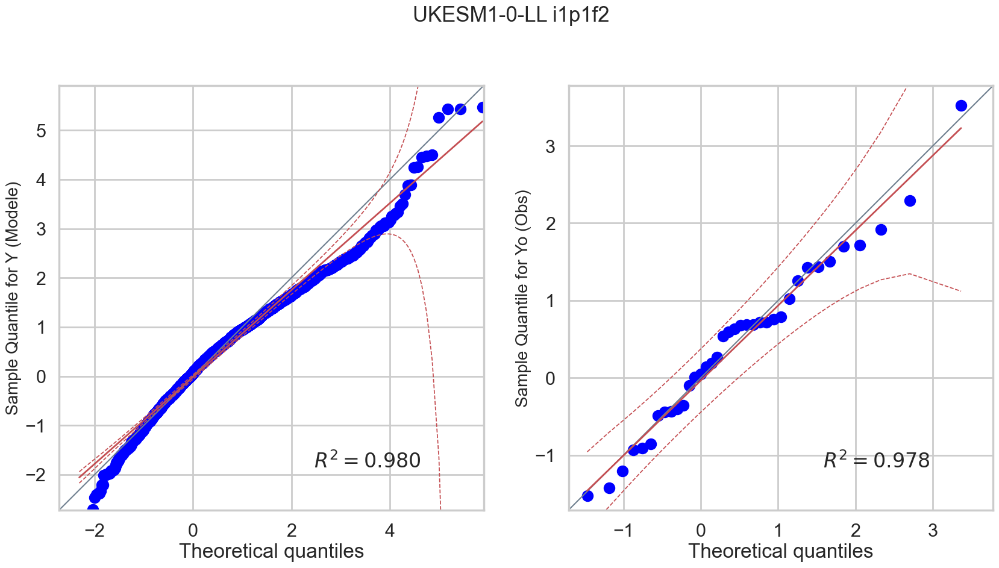

In [13]:
#Ajout IC Pingouin (Basé sur la regression linéaire)
ofile=os.path.join( pathOut , type_data+"_QQplot_GEV_GCM_Modeles_ICPingouin.pdf" )
pdf = mpdf.PdfPages( ofile )

qparams  = params[:,1:,:,:,:].quantile( [ ci / 2 , 1 - ci / 2 , 0.5 ] , dim = "sample" ).assign_coords( quantile = ["ql","qu","BE"] )
for j in range(0,len(models)):
    m=models[j]
    
    Y=lY[j]
    fig = plt.figure( figsize = (20,10) )
    ax = fig.add_subplot( 1 , 2 ,  1 )

    tY    = Y.index
    X     = clim.X.loc[tY,"BE","F",m]
    X=X.to_pandas()
    residuals=[]
    for i in range(0,len(Y)):
        shape=qparams.loc["BE",Y.index[i],"F",'shape',m].values
        loc=qparams.loc["BE",Y.index[i],"F",'loc',m].values
        scale=qparams.loc["BE",Y.index[i],"F",'scale',m].values
        
        #residuals.append((1/shape)*np.log(1+shape*(Y.iloc[i].values[0]-loc)/scale))

    
        residuals.append((Y.iloc[i].values[0]-loc)/scale)
    print(m)
    ax = pg.qqplot(np.asarray(residuals),dist=sc.genextreme,sparams=(-shape,), confidence=.95)
    #sm.qqplot(np.asarray(residuals),dist=sc.genextreme,distargs=(-shape,), line="45",ax=ax)
    ax.set_ylabel("Sample Quantile for Y (Modele)", fontsize = 20 )
    
 
    
    
    #Y=lY[j]
    ax = fig.add_subplot( 1 , 2 , 2 )

    tY    = Yo.index
    X     = Xo.loc[tY]
    #X=X.to_pandas()
    residuals=[]
    for i in range(0,len(Yo)):
        shape=qparams.loc["BE",Yo.index[i],"F",'shape',m].values
        loc=qparams.loc["BE",Yo.index[i],"F",'loc',m].values
        scale=qparams.loc["BE",Yo.index[i],"F",'scale',m].values
        
        #residuals.append((1/shape)*np.log(1+shape*(Yo.iloc[i].values[0]-loc)/scale))
        residuals.append((Yo.iloc[i].values[0]-loc)/scale)
    ax = pg.qqplot(np.asarray(residuals),dist=sc.genextreme,sparams=(-shape,), confidence=.95)
    ax.set_ylabel("Sample Quantile for Yo (Obs)", fontsize = 20 )
    
    

    
    fig.suptitle( " ".join(m.split("_")) , fontsize = 25 )
    plt.show()
    pdf.savefig(fig)
    plt.close(fig)
pdf.close()


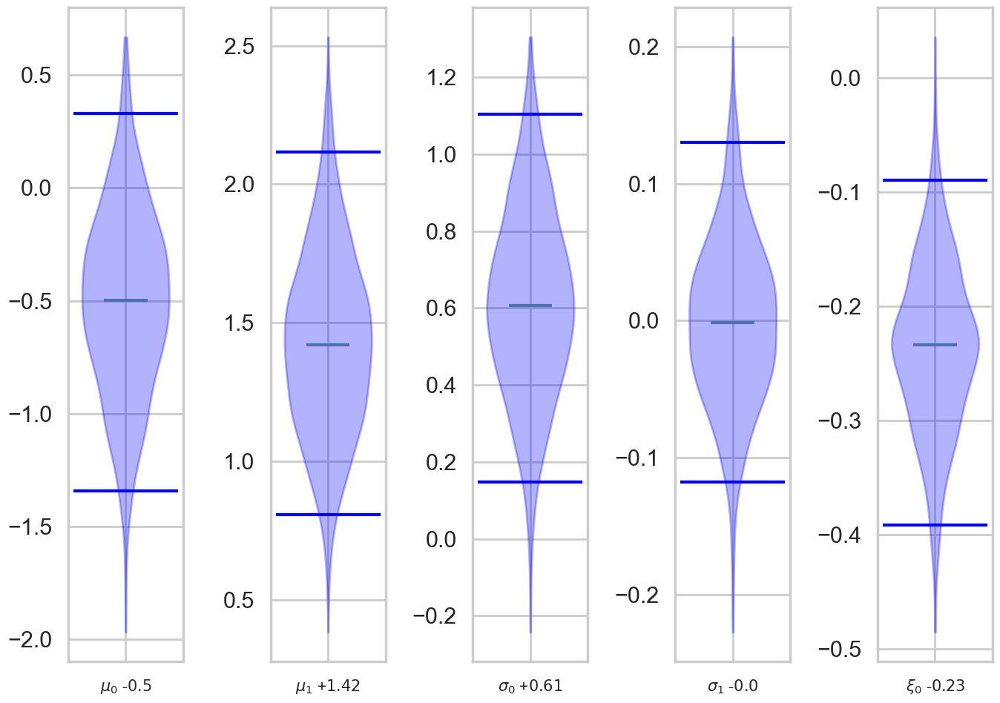

In [14]:
## Quantile

qcoef = clim.law_coef[:,1:,:].quantile( [ci/2,1-ci/2,0.5] , dim = "sample" ).assign_coords( quantile = ["ql","qu","BE"] )
#if not clim.BE_is_median:
# qcoef.loc["BE",:,:] = clim.law_coef.loc[:,"BE",:]
#qcoef.loc[["ql","qu"],:,:] = qcoef.loc[["ql","qu"],:,:]
## mpl parameter
ymin = float( (clim.law_coef ).min())
ymax = float( (clim.law_coef ).max())
delta = 0.1 * (ymax-ymin)
ylim = (ymin-delta,ymax+delta)

kwargs = {  "showmeans" : False , "showextrema" : False , "showmedians" : True }
#"positions" : range(clim.n_coef) ,
m='Multi_Synthesis'

fig = plt.figure( figsize = ( 14 , 10 ) )

for i in range(clim.n_coef):

    ax = fig.add_subplot(1,5,i+1)

    ## violin plot
    vplot = ax.violinplot( ((clim.law_coef) )[:,1:,:].loc[clim.law_coef.coef[i],:,m] , **kwargs )
    for pc in vplot["bodies"]:
        pc.set_facecolor("blue")
        pc.set_edgecolor("blue")
        pc.set_alpha(0.3)
    ## Change color
    #for pc in vplot["bodies"]:
    #    pc.set_facecolor("red")
    #    pc.set_edgecolor("red")
    #    pc.set_alpha(0.5)

    ## add quantiles

    for q in ["ql","qu"]:
        ax.hlines( qcoef[:,i,:].loc[q,m] , 1 - 0.3 , 1 + 0.3 , color = "blue" )
    #ax.hlines( 0 , -0.5 , clim.n_coef-0.5 , color = "black" )
#for i in range(clim.n_coef-1):
    #ax.vlines( i + 0.5 , ylim[0] , ylim[1] , color = "grey" )

    ## some params
#ax.set_xlim((-0.5,clim.n_coef-0.5))
    ax.set_xticks([1])
    q=qcoef.loc["BE",:,m][i]
    xticks = [ "{}".format(clim.ns_law.get_params_names(True)[i]) + " {}".format( "+" if np.sign(q) > 0 else "-" ) + r"${}$".format(float(np.sign(q)) * round(float(q),2)) ]
    ax.set_xticklabels( xticks , fontsize = 15 )
#for item in ax.get_yticklabels():
        #item.set_fontsize(15)
#ax.set_ylim(ylim)

    #fig.suptitle( " ".join(m.split("_")) , fontsize = 18 )

    fig.set_tight_layout(True)


plt.savefig(os.path.join( pathOut ,"Distribution_parameters_multisynthesis.png"))

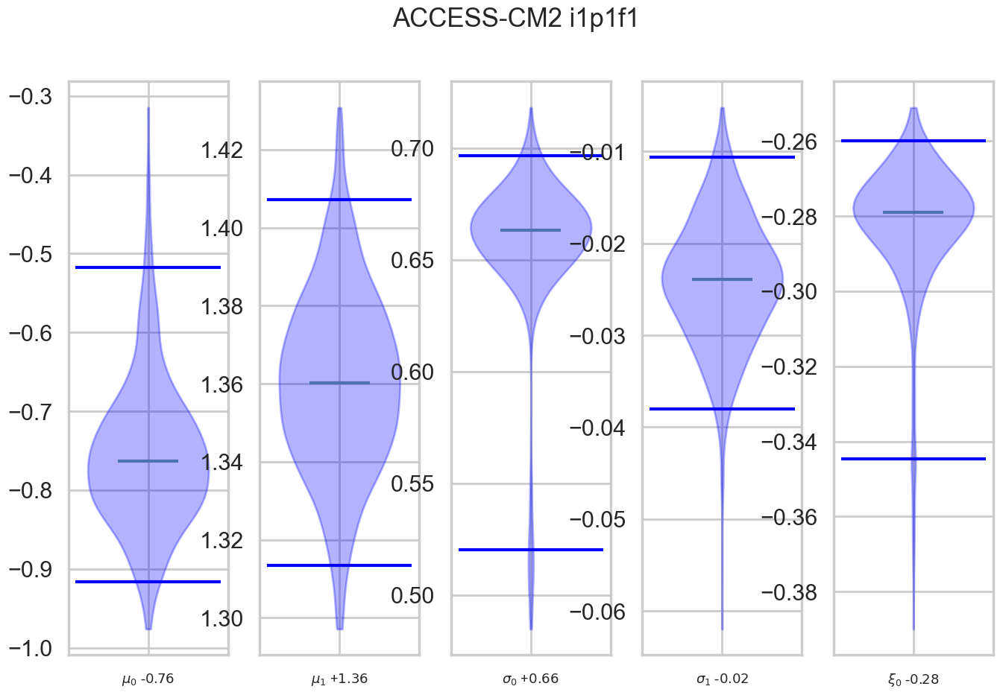

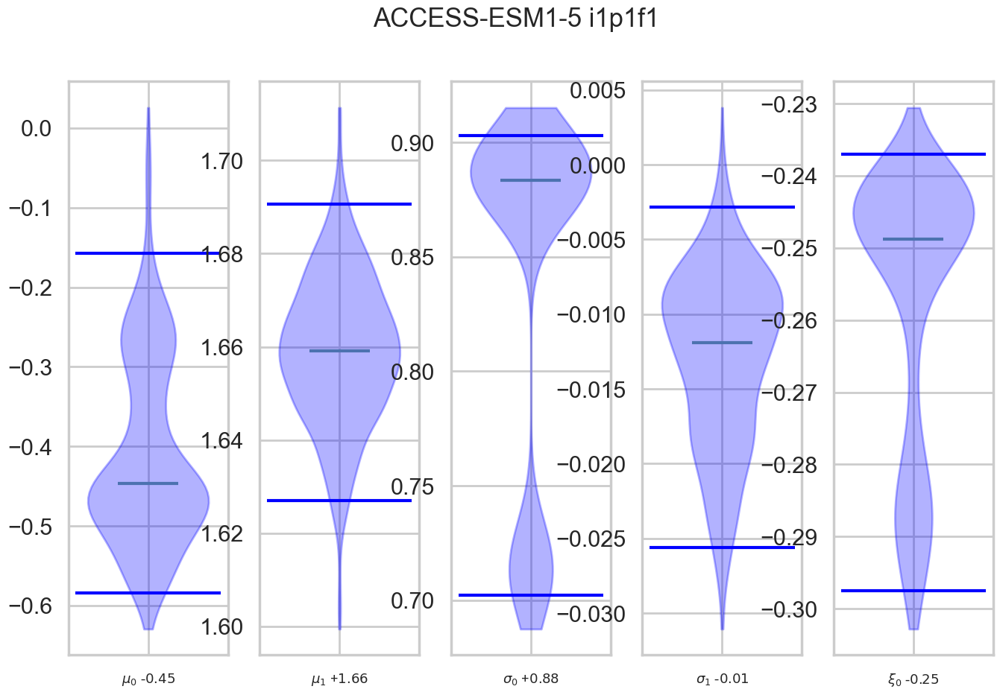

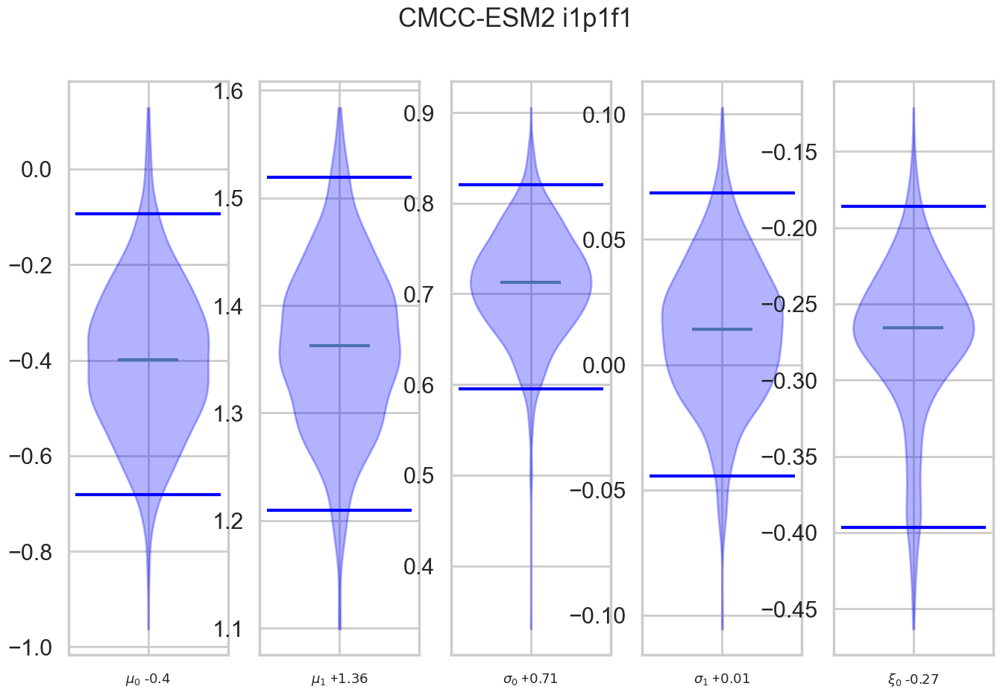

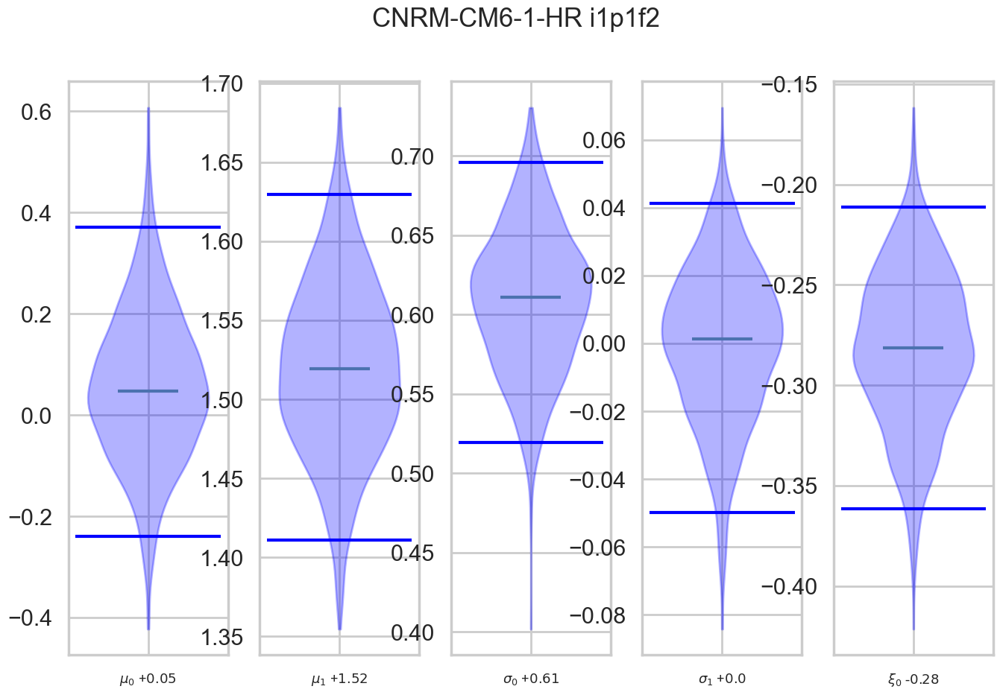

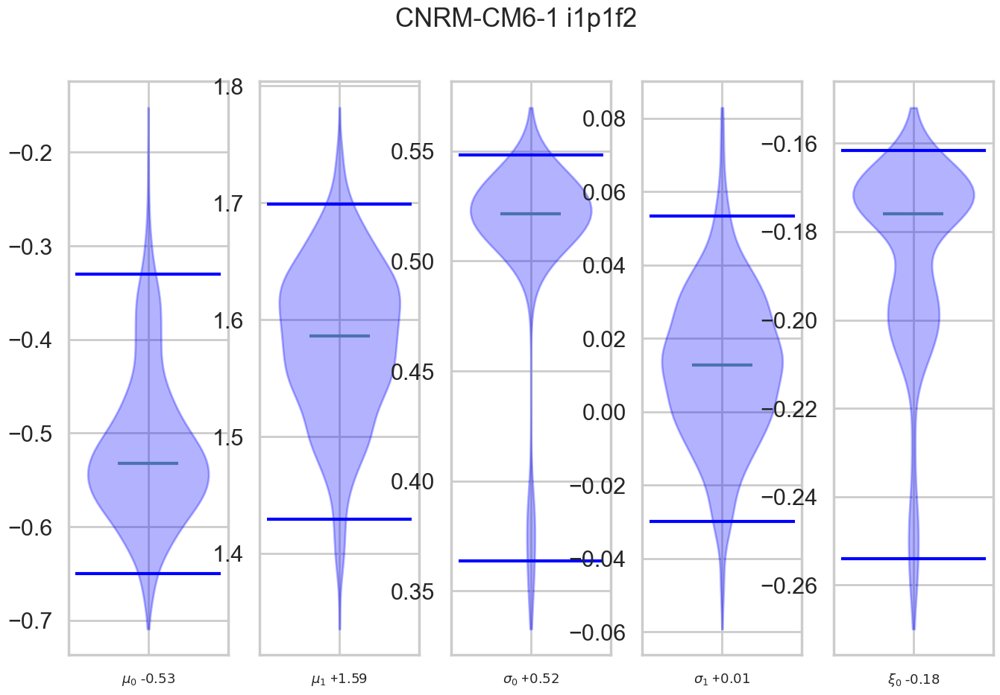

...

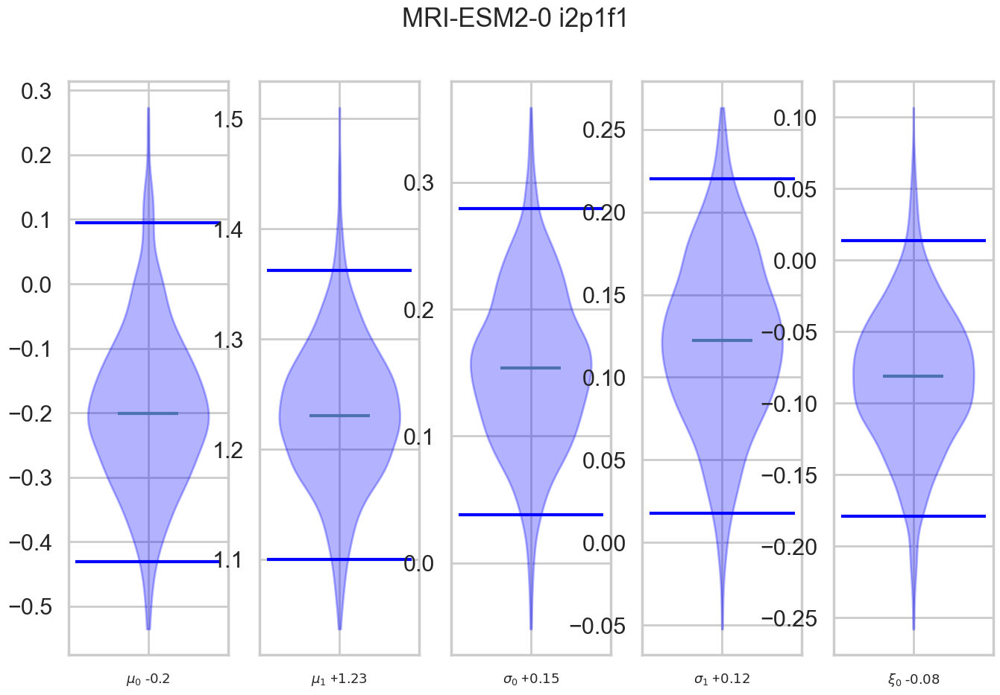

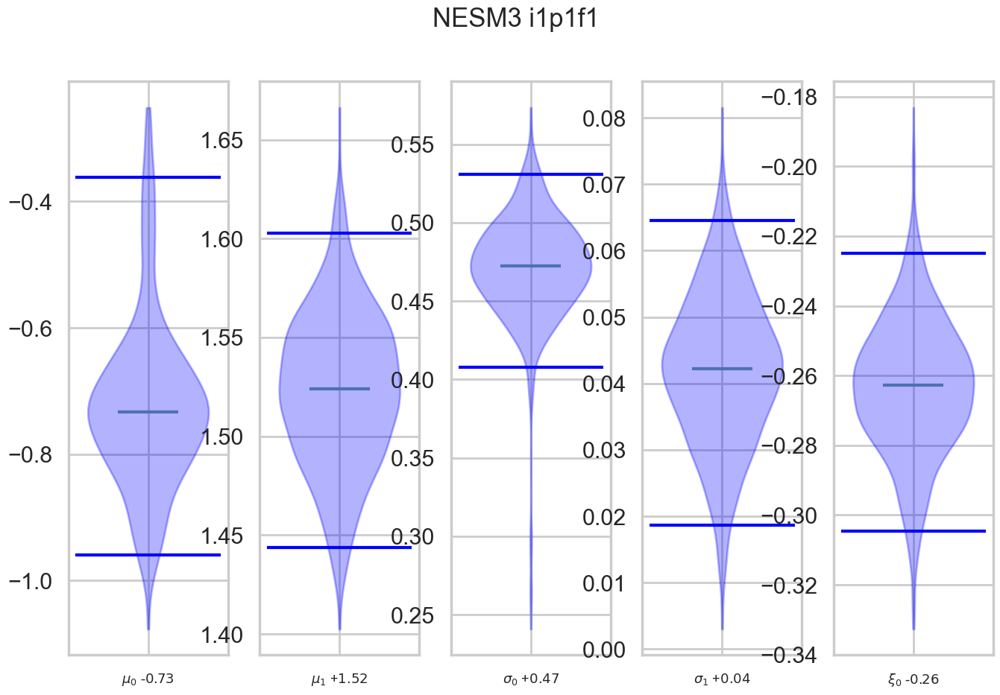

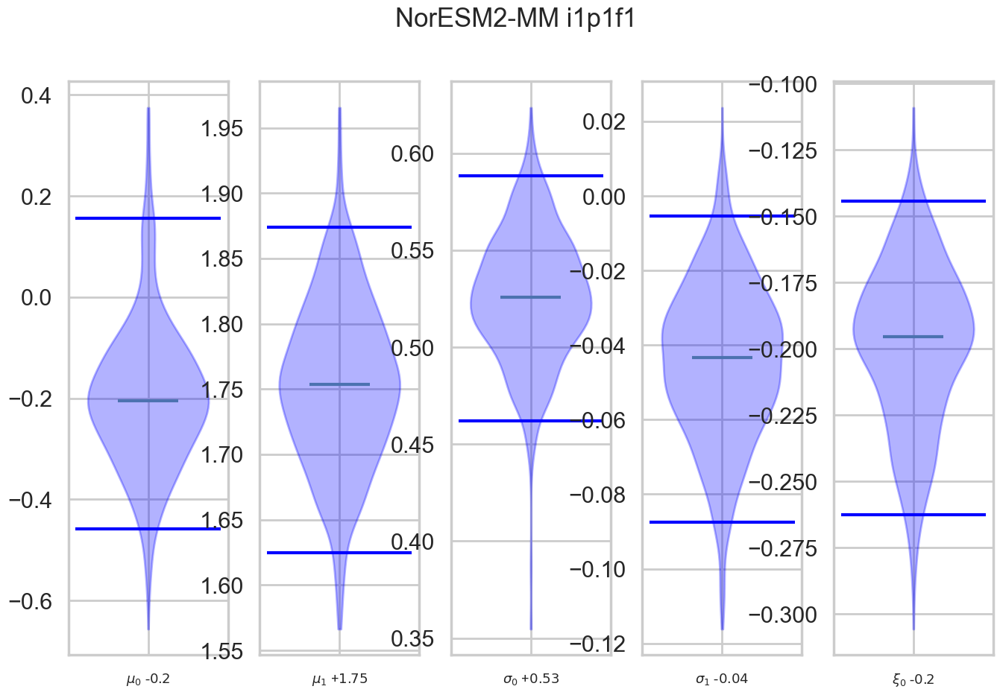

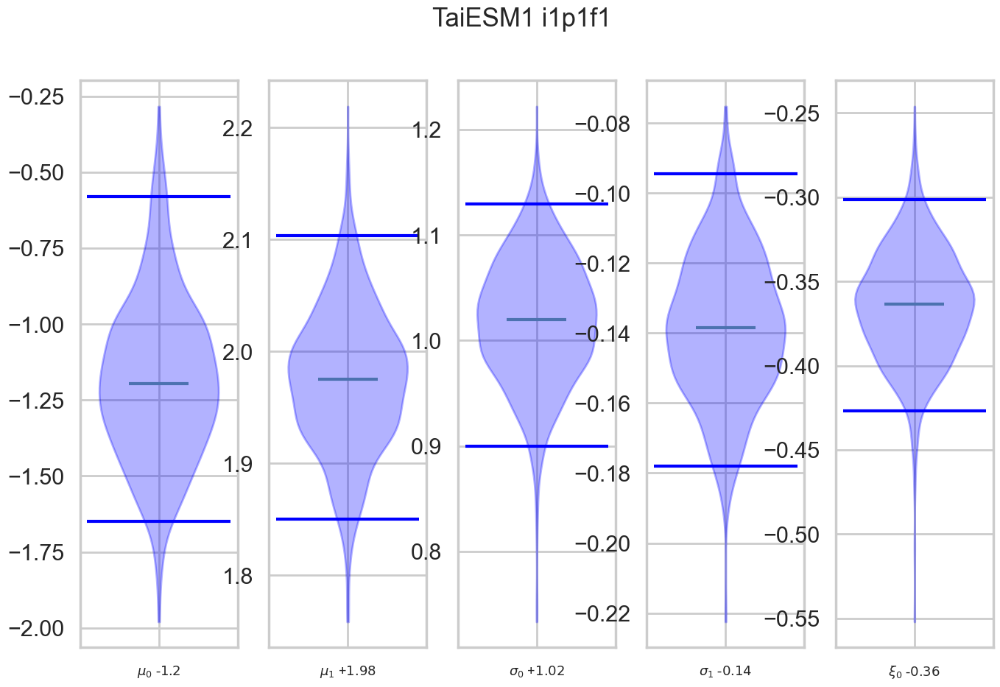

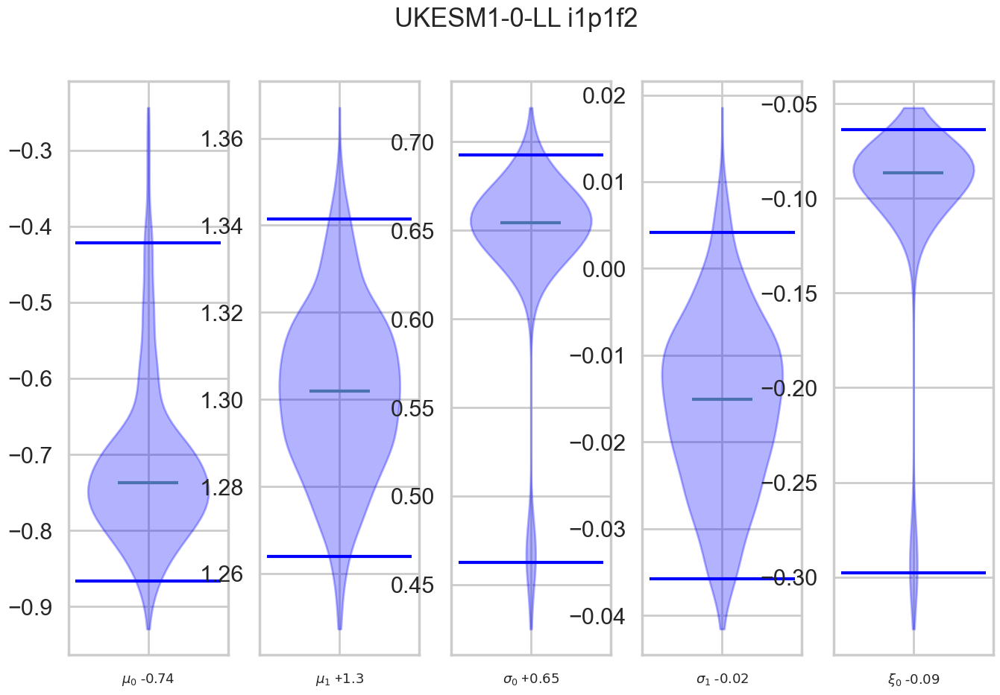

In [15]:
ofile=os.path.join( pathOut , "Distributions_Para_GCM_Modeles.pdf" )
pdf = mpdf.PdfPages( ofile )

qparams  = params[:,1:,:,:,:].quantile( [ ci / 2 , 1 - ci / 2 , 0.5 ] , dim = "sample" ).assign_coords( quantile = ["ql","qu","BE"] )
qcoef = clim.law_coef[:,1:,:].quantile( [ci/2,1-ci/2,0.5] , dim = "sample" ).assign_coords( quantile = ["ql","qu","BE"] )

ymin = float( (clim.law_coef ).min())
ymax = float( (clim.law_coef ).max())
delta = 0.1 * (ymax-ymin)
ylim = (ymin-delta,ymax+delta)

kwargs = {  "showmeans" : False , "showextrema" : False , "showmedians" : True }

for j in range(0,len(models)):
    m=models[j]
    
    Y=lY[j]
    fig = plt.figure( figsize = ( 16 , 10 ) )

    for i in range(clim.n_coef):

        ax = fig.add_subplot(1,5,i+1)

    ## violin plot
        vplot = ax.violinplot( ((clim.law_coef) )[:,1:,:].loc[clim.law_coef.coef[i],:,m] , **kwargs )
        for pc in vplot["bodies"]:
            pc.set_facecolor("blue")
            pc.set_edgecolor("blue")
            pc.set_alpha(0.3)


        for q in ["ql","qu"]:
            ax.hlines( qcoef[:,i,:].loc[q,m] , 1 - 0.3 , 1 + 0.3 , color = "blue" )

        ax.set_xticks([1])
        q=qcoef.loc["BE",:,m][i]
        xticks = [ "{}".format(clim.ns_law.get_params_names(True)[i]) + " {}".format( "+" if np.sign(q) > 0 else "-" ) + r"${}$".format(float(np.sign(q)) * round(float(q),2)) ]
        ax.set_xticklabels( xticks , fontsize = 13 )

    #fig.set_tight_layout(True)

    fig.suptitle( " ".join(m.split("_")) , fontsize = 25 )
    plt.show()
    pdf.savefig(fig)
    plt.close(fig)
pdf.close()